# Exploratory Data Analysis : Google Store Revenue Dataset

**Link to Whole data dictionary**
https://support.google.com/analytics/answer/3437719?hl=en

In [1]:
# import libraries
import pandas as pd
import seaborn as sns
import numpy as np
import pickle
import datetime
import matplotlib.pyplot as plt

from datetime import datetime, timedelta
from sklearn import preprocessing 

pd.set_option('display.max_rows', 500)
pd.set_option('display.max_columns', 500)
pd.set_option('display.width', 1000)

In [2]:
# import warnings

# We do this to ignore several specific Pandas warnings
import warnings
warnings.filterwarnings("ignore")

### Dataset Info

In [3]:
# read the data
train_df = pd.read_pickle('2017_clean.pkl')

In [4]:
#train_df.shape
print("Datasets contains %s of features, and %s of rows."%(train_df.shape[1],train_df.shape[0]))
print("Number of unique visitors in train set : ",train_df.fullVisitorId.nunique(), " out of rows : ",train_df.shape[0])

Datasets contains 38 of features, and 928860 of rows.
Number of unique visitors in train set :  716705  out of rows :  928860


In [5]:
train_df.head()

,channelGrouping,date,fullVisitorId,visitId,visitNumber,visitStartTime,device.browser,device.operatingSystem,device.isMobile,device.deviceCategory,geoNetwork.continent,geoNetwork.subContinent,geoNetwork.country,geoNetwork.region,geoNetwork.metro,geoNetwork.city,geoNetwork.networkDomain,totals.hits,totals.pageviews,totals.bounces,totals.newVisits,totals.sessionQualityDim,totals.timeOnSite,totals.transactions,totals.transactionRevenue,totals.totalTransactionRevenue,trafficSource.campaign,trafficSource.source,trafficSource.medium,trafficSource.keyword,trafficSource.referralPath,trafficSource.isTrueDirect,trafficSource.adContent,trafficSource.adwordsClickInfo.page,trafficSource.adwordsClickInfo.slot,trafficSource.adwordsClickInfo.gclId,trafficSource.adwordsClickInfo.adNetworkType,trafficSource.adwordsClickInfo.isVideoAd
0,Organic Search,20171016,3162355547410993243,1508198450,1,1508198450,Firefox,Windows,False,desktop,Europe,Western Europe,Germany,not available in demo dataset,not available in demo dataset,not available in demo dataset,(not set),1,1,1,1,1,NaN,NaN,NaN,NaN,(not set),google,organic,water bottle,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Referral,20171016,8934116514970143966,1508176307,6,1508176307,Chrome,Chrome OS,False,desktop,Americas,Northern America,United States,California,San Francisco-Oakland-San Jose CA,Cupertino,(not set),2,2,NaN,NaN,2,28,NaN,NaN,NaN,(not set),sites.google.com,referral,NaN,/a/google.com/transportation/mtv-services/bike...,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Direct,20171016,7992466427990357681,1508201613,1,1508201613,Chrome,Android,True,mobile,Americas,Northern America,United States,not available in demo dataset,not available in demo dataset,not available in demo dataset,windjammercable.net,2,2,NaN,1,1,38,NaN,NaN,NaN,(not set),(direct),(none),NaN,NaN,True,NaN,NaN,NaN,NaN,NaN,NaN
3,Organic Search,20171016,9075655783635761930,1508169851,1,1508169851,Chrome,Windows,False,desktop,Asia,Western Asia,Turkey,not available in demo dataset,not available in demo dataset,not available in demo dataset,unknown.unknown,2,2,NaN,1,1,1,NaN,NaN,NaN,(not set),google,organic,(not provided),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Organic Search,20171016,6960673291025684308,1508190552,1,1508190552,Chrome,Windows,False,desktop,Americas,Central America,Mexico,not available in demo dataset,not available in demo dataset,not available in demo dataset,prod-infinitum.com.mx,2,2,NaN,1,1,52,NaN,NaN,NaN,(not set),google,organic,(not provided),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [6]:
# understand the quantity of misisng values
missing_values_count = train_df.isnull().sum().sort_values(ascending=False)
missing_values_per = round((missing_values_count/len(train_df)) * 100,2)
pd.concat([missing_values_count, missing_values_per], axis=1, keys = ['Quant Missing values', 'Percentage Missing values - %'])

,Quant Missing values,Percentage Missing values - %
totals.totalTransactionRevenue,918372,98.87
totals.transactionRevenue,918372,98.87
totals.transactions,918372,98.87
trafficSource.adContent,877334,94.45
trafficSource.adwordsClickInfo.isVideoAd,868324,93.48
trafficSource.adwordsClickInfo.slot,868324,93.48
trafficSource.adwordsClickInfo.page,868324,93.48
trafficSource.adwordsClickInfo.adNetworkType,868324,93.48
trafficSource.adwordsClickInfo.gclId,868252,93.48
trafficSource.referralPath,695059,74.83


* In terms of of total revenue, about 1.2%of customers is generating the total revenues
* More missing values related to traffic source, might need to dig more into it.
* Some of NA (missing values) also contains values based on data dictionary. EX: Binary (1 and Na is 0)

**Change dataset into right format**

In [7]:
# library of datetime
from datetime import datetime

# This function is to extract date, weekdays, day,month and visitHour features
def date_process(df):
    df["date"] = pd.to_datetime(df["date"], format="%Y%m%d") # seting the column as pandas datetime
    df["_weekday"] = df['date'].dt.weekday #extracting week day
    df["_day"] = df['date'].dt.day # extracting day
    df["_month"] = df['date'].dt.month # extracting day
    df["_year"] = df['date'].dt.year # extracting day
    df['_visitHour'] = (df['visitStartTime'].apply(lambda x: str(datetime.fromtimestamp(x).hour))).astype(int)
    
    return df #returning the df after the transformations
train_df = date_process(train_df) #calling the function that we created above

In [8]:
#change dataset into right format, then we can also save some memory space
#fill missing values(0,1/True,False)
train_df['totals.bounces'] = train_df['totals.bounces'].fillna(0)
train_df['totals.newVisits'] =train_df['totals.newVisits'].fillna(0)
train_df['trafficSource.isTrueDirect'] =train_df['trafficSource.isTrueDirect'].fillna('False')
train_df['trafficSource.adwordsClickInfo.slot'] = train_df['trafficSource.adwordsClickInfo.slot'].fillna('None')
train_df['trafficSource.adwordsClickInfo.adNetworkType'] = train_df['trafficSource.adwordsClickInfo.adNetworkType'].fillna('Unknown')
#train_df['totals.timeOnSite'] = train_df['totals.timeOnSite'].fillna(0)
#train_df['totals.transactions'] = train_df['totals.transactions'].fillna(0)
#train_df['totals.transactionRevenue'] = train_df['totals.transactionRevenue'].fillna(0.0)
#train_df['totals.totalTransactionRevenue'] = train_df['totals.totalTransactionRevenue'].fillna(0)
train_df['trafficSource.adwordsClickInfo.page'] = train_df['trafficSource.adwordsClickInfo.page'].fillna(0)
train_df['totals.hits']=train_df['totals.hits'].fillna(0)
train_df.loc[train_df['geoNetwork.city'] == "(not set)", 'geoNetwork.city'] = np.nan
train_df['geoNetwork.city'].fillna("NaN", inplace=True)
#change format of dataset
train_df['channelGrouping']=train_df['channelGrouping'].astype('category')
train_df['device.browser']=train_df['device.browser'].astype('category')
train_df['device.operatingSystem']=train_df['device.operatingSystem'].astype('category')
train_df['device.isMobile']=train_df['device.isMobile'].astype('category')
train_df['device.deviceCategory']=train_df['device.deviceCategory'].astype('category')
train_df['geoNetwork.continent']=train_df['geoNetwork.continent'].astype('category')
train_df['geoNetwork.subContinent']=train_df['geoNetwork.subContinent'].astype('category')
train_df['geoNetwork.country']=train_df['geoNetwork.country'].astype('category')
train_df['geoNetwork.region']=train_df['geoNetwork.region'].astype('category')
train_df['geoNetwork.city']=train_df['geoNetwork.city'].astype('category')
train_df['geoNetwork.networkDomain']=train_df['geoNetwork.networkDomain'].astype('category')
train_df['totals.hits']=train_df['totals.hits'].astype('int')                              
train_df['totals.pageviews']=train_df['totals.pageviews'].astype('float')
train_df['totals.bounces']=train_df['totals.bounces'].astype('float')
train_df['totals.newVisits']=train_df['totals.newVisits'].astype('float')
train_df['totals.sessionQualityDim']=train_df['totals.sessionQualityDim'].astype('float')
train_df['totals.timeOnSite']=train_df['totals.timeOnSite'].astype('float')                         
train_df['totals.transactions']=train_df['totals.transactions'].astype('float')                         
train_df['totals.transactionRevenue']=train_df['totals.transactionRevenue'].astype('float')                      
train_df['totals.totalTransactionRevenue']=train_df['totals.totalTransactionRevenue'].astype('float')
train_df['trafficSource.campaign'] =train_df['trafficSource.campaign'].astype('category')           
train_df['trafficSource.source']=train_df['trafficSource.source'].astype('category')                   
train_df['trafficSource.medium']=train_df['trafficSource.medium'].astype('category')                                                          
train_df['trafficSource.isTrueDirect']=train_df['trafficSource.isTrueDirect'].astype('category')
train_df['trafficSource.adwordsClickInfo.slot']=train_df['trafficSource.adwordsClickInfo.slot'].astype('category')
train_df['trafficSource.adwordsClickInfo.adNetworkType']=train_df['trafficSource.adwordsClickInfo.adNetworkType'].astype('category')
train_df['trafficSource.adwordsClickInfo.page']=train_df['trafficSource.adwordsClickInfo.page'].astype('int')

In [9]:
train_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 928860 entries, 0 to 928859
Data columns (total 43 columns):
channelGrouping                                 928860 non-null category
date                                            928860 non-null datetime64[ns]
fullVisitorId                                   928860 non-null object
visitId                                         928860 non-null int64
visitNumber                                     928860 non-null int64
visitStartTime                                  928860 non-null int64
device.browser                                  928860 non-null category
device.operatingSystem                          928860 non-null category
device.isMobile                                 928860 non-null category
device.deviceCategory                           928860 non-null category
geoNetwork.continent                            928860 non-null category
geoNetwork.subContinent                         928860 non-null category
geoNetwork.country

In [10]:
train_df.head()

,channelGrouping,date,fullVisitorId,visitId,visitNumber,visitStartTime,device.browser,device.operatingSystem,device.isMobile,device.deviceCategory,geoNetwork.continent,geoNetwork.subContinent,geoNetwork.country,geoNetwork.region,geoNetwork.metro,geoNetwork.city,geoNetwork.networkDomain,totals.hits,totals.pageviews,totals.bounces,totals.newVisits,totals.sessionQualityDim,totals.timeOnSite,totals.transactions,totals.transactionRevenue,totals.totalTransactionRevenue,trafficSource.campaign,trafficSource.source,trafficSource.medium,trafficSource.keyword,trafficSource.referralPath,trafficSource.isTrueDirect,trafficSource.adContent,trafficSource.adwordsClickInfo.page,trafficSource.adwordsClickInfo.slot,trafficSource.adwordsClickInfo.gclId,trafficSource.adwordsClickInfo.adNetworkType,trafficSource.adwordsClickInfo.isVideoAd,_weekday,_day,_month,_year,_visitHour
0,Organic Search,2017-10-16,3162355547410993243,1508198450,1,1508198450,Firefox,Windows,False,desktop,Europe,Western Europe,Germany,not available in demo dataset,not available in demo dataset,not available in demo dataset,(not set),1,1.0,1.0,1.0,1.0,NaN,NaN,NaN,NaN,(not set),google,organic,water bottle,NaN,False,NaN,0,None,NaN,Unknown,NaN,0,16,10,2017,19
1,Referral,2017-10-16,8934116514970143966,1508176307,6,1508176307,Chrome,Chrome OS,False,desktop,Americas,Northern America,United States,California,San Francisco-Oakland-San Jose CA,Cupertino,(not set),2,2.0,0.0,0.0,2.0,28.0,NaN,NaN,NaN,(not set),sites.google.com,referral,NaN,/a/google.com/transportation/mtv-services/bike...,False,NaN,0,None,NaN,Unknown,NaN,0,16,10,2017,12
2,Direct,2017-10-16,7992466427990357681,1508201613,1,1508201613,Chrome,Android,True,mobile,Americas,Northern America,United States,not available in demo dataset,not available in demo dataset,not available in demo dataset,windjammercable.net,2,2.0,0.0,1.0,1.0,38.0,NaN,NaN,NaN,(not set),(direct),(none),NaN,NaN,True,NaN,0,None,NaN,Unknown,NaN,0,16,10,2017,19
3,Organic Search,2017-10-16,9075655783635761930,1508169851,1,1508169851,Chrome,Windows,False,desktop,Asia,Western Asia,Turkey,not available in demo dataset,not available in demo dataset,not available in demo dataset,unknown.unknown,2,2.0,0.0,1.0,1.0,1.0,NaN,NaN,NaN,(not set),google,organic,(not provided),NaN,False,NaN,0,None,NaN,Unknown,NaN,0,16,10,2017,11
4,Organic Search,2017-10-16,6960673291025684308,1508190552,1,1508190552,Chrome,Windows,False,desktop,Americas,Central America,Mexico,not available in demo dataset,not available in demo dataset,not available in demo dataset,prod-infinitum.com.mx,2,2.0,0.0,1.0,1.0,52.0,NaN,NaN,NaN,(not set),google,organic,(not provided),NaN,False,NaN,0,None,NaN,Unknown,NaN,0,16,10,2017,16


**Data Analysis**

**1) Transaction Revenue Distribution**

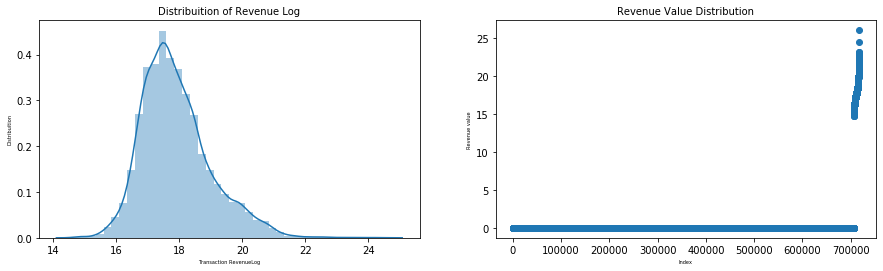

In [11]:
# Revenue
plt.figure(figsize=(15,4))
plt.subplot(1,2,1)
ax = sns.distplot(np.log(train_df[train_df['totals.totalTransactionRevenue'] > 0]["totals.totalTransactionRevenue"] + 0.01), bins=40, kde=True)
ax.set_xlabel('Transaction RevenueLog', fontsize=5) 
ax.set_ylabel('Distribuition', fontsize=5)
ax.set_title("Distribuition of Revenue Log", fontsize=10)

plt.subplot(1,2,2) 
gdf = train_df.groupby("fullVisitorId")["totals.totalTransactionRevenue"].sum().reset_index()
plt.scatter(range(gdf.shape[0]), np.sort(np.log1p(gdf["totals.totalTransactionRevenue"].values)))
plt.xlabel('Index', fontsize=5)
plt.ylabel('Revenue value', fontsize=5)
plt.title("Revenue Value Distribution", fontsize=10)

plt.show()

* log of transaction revenue distribution is normally distributed
* The second graph shows minorities of customers produce majorties of benefits 

***ChannelGrouping Analysis***

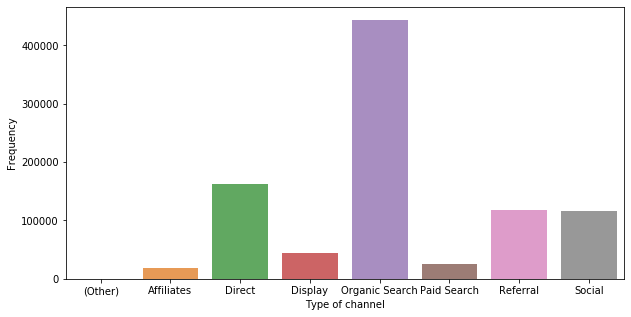

In [12]:
count = train_df['channelGrouping'].value_counts()

plt.figure(figsize=(10,5))
ax = sns.barplot(count.index, count.values, alpha=0.8)
ax.set_xlabel('Type of channel')
ax.set_ylabel('Frequency')
plt.show()

* Most our customers are coming from Organic Search, then the next channel is from direct.

The TOP 5 Grouping Channels represents 97% of customer units. Respectivelly:

* TOP 1 => Organic Search - 42.99%
* TOP 2 => Social - 24.39%
* TOP 3 => Direct - 15.42%
* TOP 4 => Referral - 11.89%
* TOP 5 => Paid Search - 2.55%

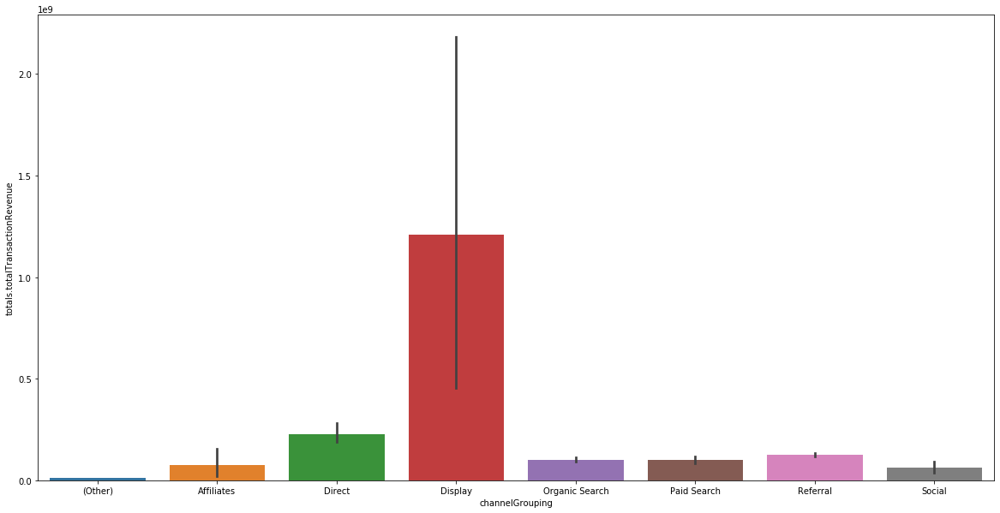

In [13]:
plt.figure(figsize=(20,10))
sns.barplot(x='channelGrouping', y='totals.totalTransactionRevenue', data=train_df)

* Display actually has the most revenue even though most our customer is from Organic Search
* The second most is from direct, it is also the second most group channel that get more customers

#### 1) Device related columns

***device.browser Analysis***

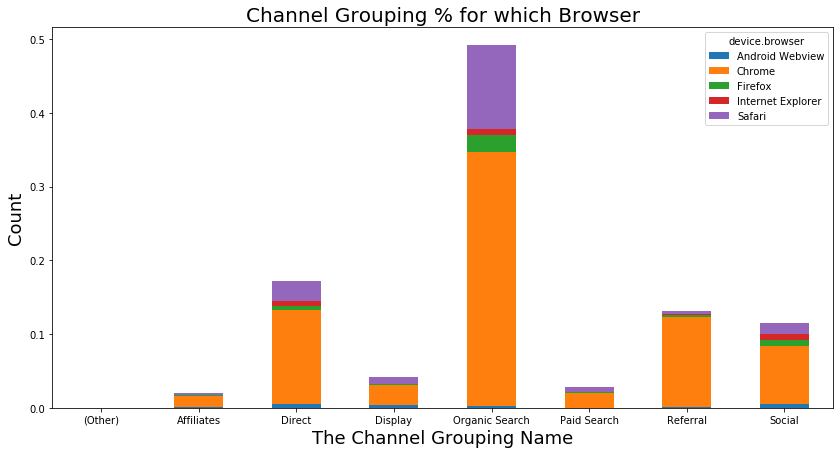

In [14]:
crosstab_eda = pd.crosstab(index=train_df['channelGrouping'], normalize=True,
                           # at this line, I am using the isin to select just the top 5 of browsers
                           columns=train_df[train_df['device.browser'].isin(train_df['device.browser']\
                                                                            .value_counts()[:5].index.values)]['device.browser'])

crosstab_eda.plot(kind="bar",    # select the bar to plot the count of categoricals
                 figsize=(14,7), # adjusting the size of graphs
                 stacked=True)   # code to unstack 
plt.title("Channel Grouping % for which Browser", fontsize=20) # seting the title size
plt.xlabel("The Channel Grouping Name", fontsize=18) # seting the x label size
plt.ylabel("Count", fontsize=18) # seting the y label size
plt.xticks(rotation=0)
plt.show() # rendering

* Majority of users is from Chrome,and the second popular browser is Safari.

***device.isMobile Analysis***

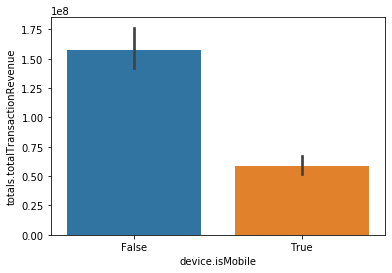

In [15]:
sns.barplot(x='device.isMobile', y='totals.totalTransactionRevenue', data=train_df)

***Date***

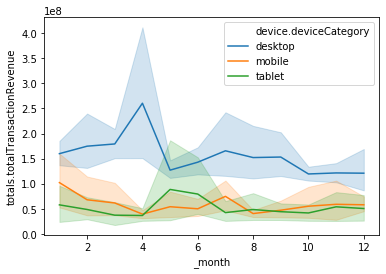

In [16]:
sns.lineplot(x="_month", y="totals.totalTransactionRevenue",hue='device.deviceCategory',data=train_df)

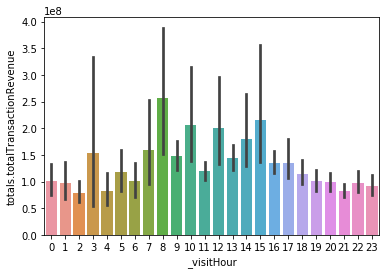

In [17]:
sns.barplot(x="_visitHour", y="totals.totalTransactionRevenue", data=train_df)

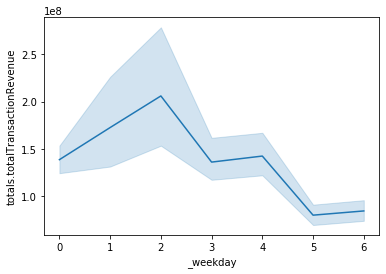

In [18]:
sns.lineplot(x="_weekday", y="totals.totalTransactionRevenue", data=train_df)

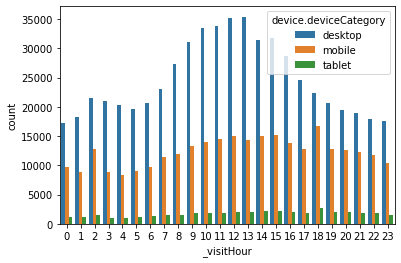

In [20]:
sns.countplot(x='_visitHour', hue='device.deviceCategory', data=train_df)

In [81]:
df_date2=pd.get_dummies(train_df['_weekday'],prefix='weekday',drop_first=True)
#df_date2=df_date2.join(pd.get_dummies(df_clean['_visitHour'],prefix='hour',drop_first=True))

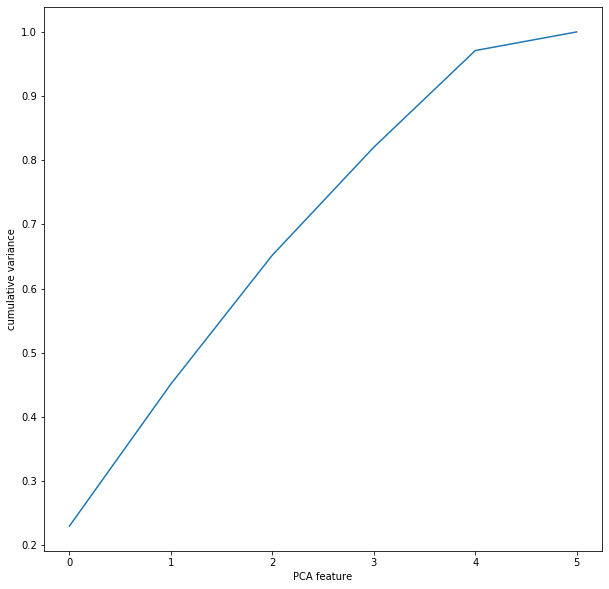

In [82]:
plt.figure(figsize=(10,10)) 
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
import matplotlib.pyplot as plt

# Create scaler: scaler
#scaler = StandardScaler()

# Create a PCA instance: pca
pca = PCA()

# Create pipeline: pipeline


# Fit the pipeline to 'samples'
pca.fit(df_date2)

# Plot the explained variances
features = range(pca.n_components_)
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('PCA feature')
plt.ylabel('cumulative variance')
plt.xticks(features)
plt.show()
# PCA() i can tell him the number of the pca I wanna use

In [83]:
pca.components_

array([[-0.59511668,  0.792791  , -0.12437822, -0.03786637, -0.0133765 ,
        -0.01535699],
       [-0.58897473, -0.32116094,  0.73366524,  0.09800254,  0.02987372,
         0.03468127],
       [-0.30055386, -0.25797284, -0.46730928,  0.77559807,  0.09694017,
         0.11742941],
       [-0.22354336, -0.21052282, -0.25804675, -0.46562404,  0.41671886,
         0.66982089],
       [-0.04765011, -0.04570016, -0.05249221, -0.07429938,  0.79467751,
        -0.59653398],
       [-0.39543662, -0.39418236, -0.39817565, -0.40630424, -0.42937662,
        -0.42456906]])

In [84]:
df_date3=pd.get_dummies(train_df['_month'],drop_first=True,prefix='month')

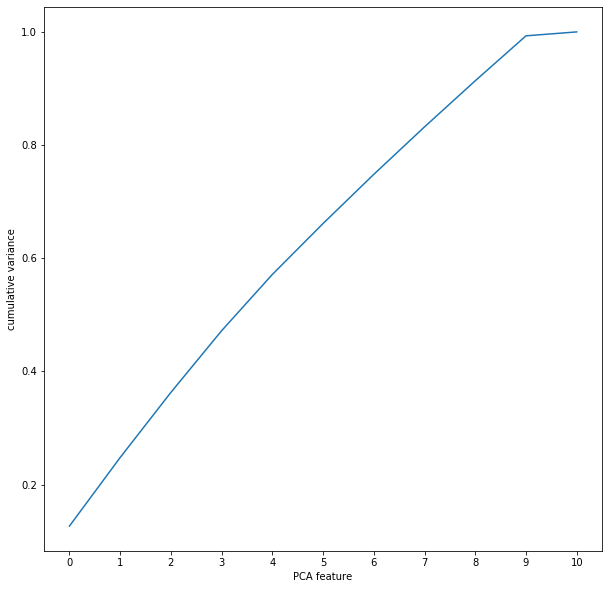

In [85]:
plt.figure(figsize=(10,10)) 
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
import matplotlib.pyplot as plt

# Create scaler: scaler
#scaler = StandardScaler()

# Create a PCA instance: pca
pca = PCA()

# Create pipeline: pipeline


# Fit the pipeline to 'samples'
pca.fit(df_date3)

# Plot the explained variances
features = range(pca.n_components_)
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('PCA feature')
plt.ylabel('cumulative variance')
plt.xticks(features)
plt.show()
# PCA() i can tell him the number of the pca I wanna use

In [86]:
df_date3=pd.get_dummies(train_df['_visitHour'],drop_first=True,prefix='hour')

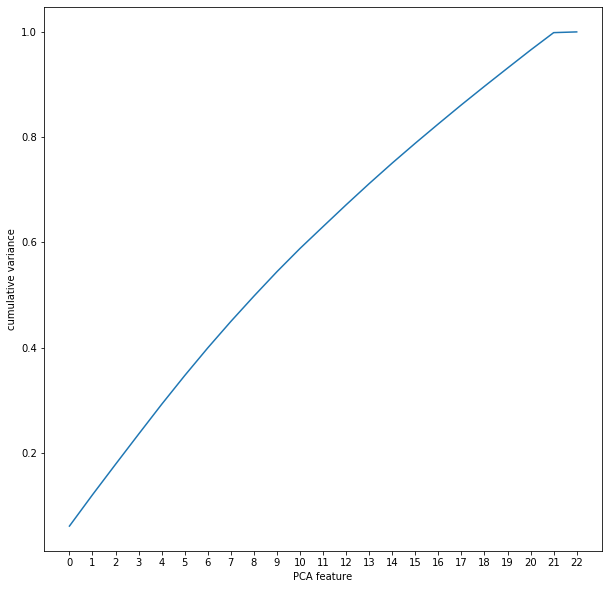

In [87]:
plt.figure(figsize=(10,10)) 
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.pipeline import make_pipeline
import matplotlib.pyplot as plt

# Create scaler: scaler
#scaler = StandardScaler()

# Create a PCA instance: pca
pca = PCA()

# Create pipeline: pipeline


# Fit the pipeline to 'samples'
pca.fit(df_date3)

# Plot the explained variances
features = range(pca.n_components_)
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel('PCA feature')
plt.ylabel('cumulative variance')
plt.xticks(features)
plt.show()
# PCA() i can tell him the number of the pca I wanna use

* We try to use pca for date, but it does not work very well for dimension reduction
* Going with exploratory analysis results
   * Creating new feature isTuesday, because people tends to make more transactions on Tuesday
   * isApril becuase there is a spike when wen plot month with transactions revenue

***device.deviceCategory***

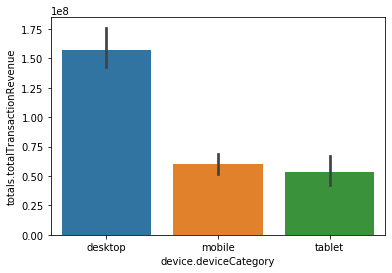

In [19]:
sns.barplot(x="device.deviceCategory", y="totals.totalTransactionRevenue", data=train_df)

<Figure size 720x576 with 0 Axes>

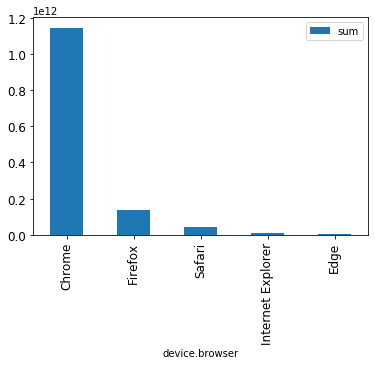

In [28]:
plt.figure(figsize=(10,8))
# revenue
count = train_df.groupby(['device.browser'])['totals.transactionRevenue'].agg(['sum'])
#sns.barplot(x='device.isMobile', y='totals.totalTransactionRevenue', data=train_df)
count.sort_values(['sum'], ascending=False)[:5].plot(kind='bar', fontsize=12)

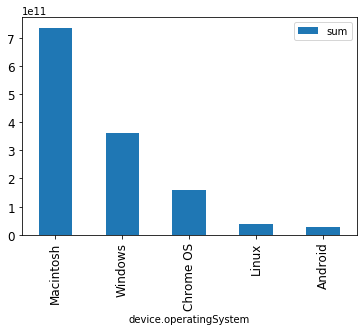

In [29]:
# device browser
count = train_df.groupby('device.operatingSystem')['totals.transactionRevenue'].agg(['sum'])
count.sort_values(['sum'], ascending=False)[:5].plot(kind='bar', fontsize=12)

**2) GeoNetwork Columns**

***geoNetwork.continent***   
Only 6 groups, ready to use.

Thoughts:
1. Americas has most counts and non-zero revenue.
2. Asia and Europe have high counts but low non-zero revenue.
3. Mean revenue of Africa is high.

In [21]:
# continent
cnt = train_df.groupby('geoNetwork.continent')['totals.totalTransactionRevenue'].agg(['size', 'count', 'mean'])
cnt.columns = ["count", "count of non-zero revenue", "mean"]
cnt = cnt.sort_values(by="count", ascending=False)
cnt

,count,count of non-zero revenue,mean
geoNetwork.continent,,,
Americas,499458,10275,1.488042e+08
Europe,209074,80,9.968250e+07
Asia,187915,110,1.294265e+08
Oceania,16776,16,3.238944e+08
Africa,14387,5,6.823880e+08
(not set),1250,2,2.136500e+07


Text(0.5, 1.0, 'Continent - Revenue Mean')

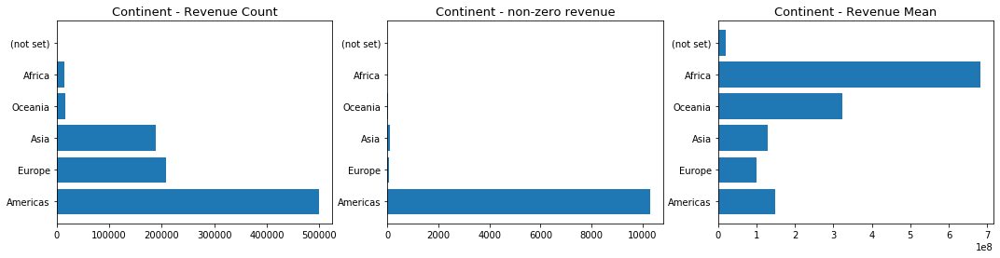

In [22]:
plt.figure(figsize=(18,4))

plt.subplot(1,3,1)
plt.barh(cnt.index.values, cnt['count'])
plt.title("Continent - Revenue Count", fontsize=13)

plt.subplot(1,3,2)
plt.barh(cnt.index.values, cnt['count of non-zero revenue'])
plt.title("Continent - non-zero revenue", fontsize=13)

plt.subplot(1,3,3)
plt.barh(cnt.index.values, cnt['mean'])
plt.title("Continent - Revenue Mean", fontsize=13)

***geoNetwork.subContinent***   
About 20 groups, ready to use.
Similar pattern as continent.

In [23]:
# subcontinent
scnt = train_df.groupby('geoNetwork.subContinent')['totals.totalTransactionRevenue'].agg(['size', 'count', 'mean'])
scnt.columns = ["count", "count of non-zero revenue", "mean"]
scnt = scnt.sort_values(by="count", ascending=False)
scnt.head()

,count,count of non-zero revenue,mean
geoNetwork.subContinent,,,
Northern America,446135,10208,1.484929e+08
Northern Europe,67546,23,1.151735e+08
Western Europe,67240,33,1.075767e+08
Southern Asia,65795,13,7.571385e+07
Eastern Asia,51136,51,1.774249e+08


***geoNetwork.country***   
* United State has only 45% of counts but over 95% of the non-zero revenue. That's interesting. Other countries almost generate no revenue except Canada. But Canada also only generate 174 pieces of non-zero revenue out of 30k counts of visit.

* We may consider drop this column and create a feature **is_US** (1 for country==US, 0 for country!=US).

In [24]:
# country
ct = train_df.groupby('geoNetwork.country')['totals.totalTransactionRevenue'].agg(['size', 'count', 'mean'])
ct.columns = ["count", "count of non-zero revenue", "mean"]
ct = ct.sort_values(by="count", ascending=False)

ct.head()

,count,count of non-zero revenue,mean
geoNetwork.country,,,
United States,416398,10034,1.487837e+08
India,57370,13,7.571385e+07
United Kingdom,45618,14,1.395700e+08
Canada,29687,174,1.317232e+08
Germany,22542,7,8.743857e+07


In [25]:
train_df[train_df['geoNetwork.country']=='United States']['totals.totalTransactionRevenue'].count()/train_df['totals.totalTransactionRevenue'].count()

0.9567124332570557

In [26]:
len(train_df[train_df['geoNetwork.country']=='United States']['totals.totalTransactionRevenue'])/len(train_df['totals.totalTransactionRevenue'])

0.448289300863424

Text(0.5, 1.0, 'Continent - Revenue Mean')

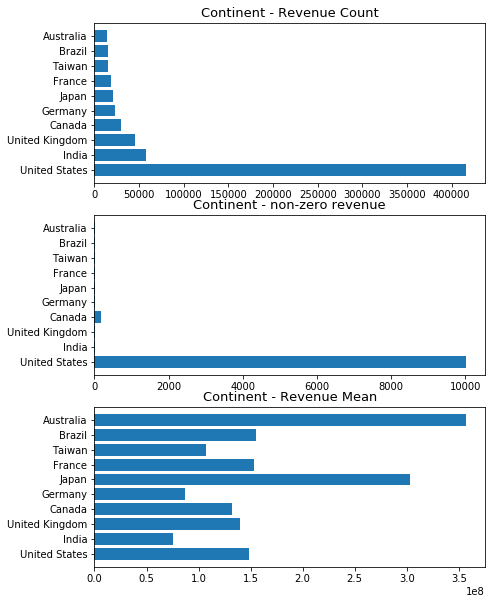

In [27]:
# plot top 10
ct_10 = ct.head(10)

plt.figure(figsize=(7,10))

plt.subplot(3,1,1)
plt.barh(ct_10.index.values, ct_10['count'])
plt.title("Country - Revenue Count", fontsize=13)

plt.subplot(3,1,2)
plt.barh(ct_10.index.values, ct_10['count of non-zero revenue'])
plt.title("Country - non-zero revenue", fontsize=13)

plt.subplot(3,1,3)
plt.barh(ct_10.index.values, ct_10['mean'])
plt.title("Country - Revenue Mean", fontsize=13)

***geoNetwork.region***   
* For non-zero revenue, region not available is nearly 40%. Among the remaining, California is the most and is above 30%.

In [28]:
# city
city = train_df.groupby('geoNetwork.city')['totals.totalTransactionRevenue'].agg(['size', 'count', 'mean'])
city.columns = ["count", "count of non-zero revenue", "mean"]
city = city.sort_values(by="count", ascending=False)

city.head(20)

,count,count of non-zero revenue,mean
geoNetwork.city,,,
not available in demo dataset,517806,4052,1.822869e+08
Mountain View,39494,1198,1.027948e+08
NaN,34185,54,1.088648e+08
New York,27900,1247,1.394442e+08
San Francisco,21145,644,1.361777e+08
Sunnyvale,15475,507,9.018682e+07
London,14178,12,1.221542e+08
San Jose,11311,223,8.695448e+07
Los Angeles,10347,276,1.625361e+08


Text(0.5, 1.0, 'Continent - Revenue Mean')

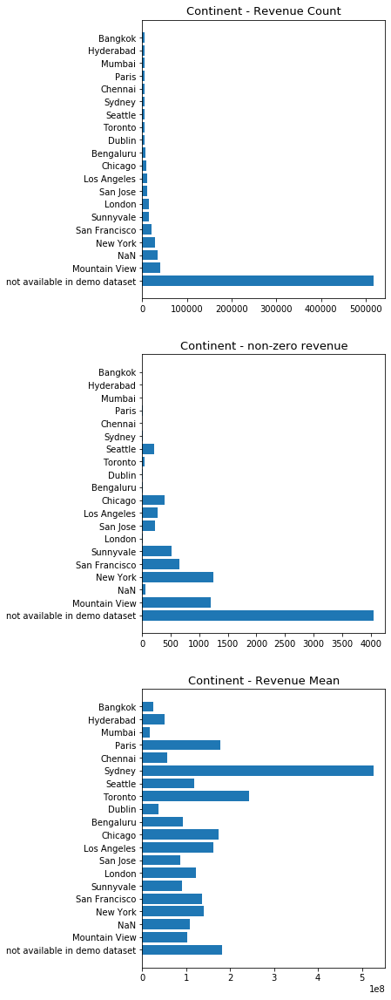

In [29]:
# plot top 20
city_20 = city.head(20)

plt.figure(figsize=(5,20))

plt.subplot(3,1,1)
plt.barh(city_20.index.values, city_20['count'])
plt.title("Continent - Revenue Count", fontsize=13)

plt.subplot(3,1,2)
plt.barh(city_20.index.values, city_20['count of non-zero revenue'])
plt.title("Continent - non-zero revenue", fontsize=13)

plt.subplot(3,1,3)
plt.barh(city_20.index.values, city_20['mean'])
plt.title("Continent - Revenue Mean", fontsize=13)

***geoNetwork.networkDomain***   
* About 29K domains, including unknown.unknown and (not set). It is interesting to find out that (not set) has better revenue than unknown.unknown.
* Looks like this column is ready to use.

* Clean up networkDomain and just keep ending like edu,net,com

In [30]:
train_df['domain'] = train_df['geoNetwork.networkDomain'].str.split('.')
train_df['domain'] = [i[-1] for i in train_df['domain']]

In [31]:
# networkDomain
dm = train_df.groupby('domain')['totals.transactionRevenue'].agg(['size', 'count', 'mean'])
dm.columns = ["count", "count of non-zero revenue", "mean"]
dm = dm.sort_values(by="count", ascending=False)

dm.head()

,count,count of non-zero revenue,mean
domain,,,
(not set),291104,6217,1.168063e+08
net,189245,2668,1.718285e+08
unknown,134260,366,8.316246e+07
com,88768,921,1.116943e+08
in,14531,4,3.126250e+07


Text(0.5, 1.0, 'Domain - Revenue Mean')

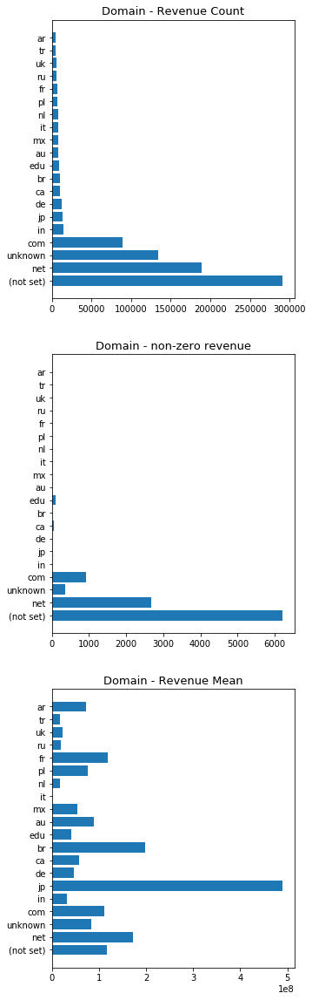

In [32]:
# plot top 20
dm20 = dm.head(20)

plt.figure(figsize=(5,20))

plt.subplot(3,1,1)
plt.barh(dm20.index.values, dm20['count'])
plt.title("Domain - Revenue Count", fontsize=13)

plt.subplot(3,1,2)
plt.barh(dm20.index.values, dm20['count of non-zero revenue'])
plt.title("Domain - non-zero revenue", fontsize=13)

plt.subplot(3,1,3)
plt.barh(dm20.index.values, dm20['mean'])
plt.title("Domain - Revenue Mean", fontsize=13)

***Totals Columns Analysis***

In [33]:
columns=['totals.hits',
 'totals.pageviews',
 'totals.sessionQualityDim',
 'totals.timeOnSite',
 'totals.transactions',
 'totals.transactionRevenue',
 'totals.totalTransactionRevenue']
train_total=train_df[columns]

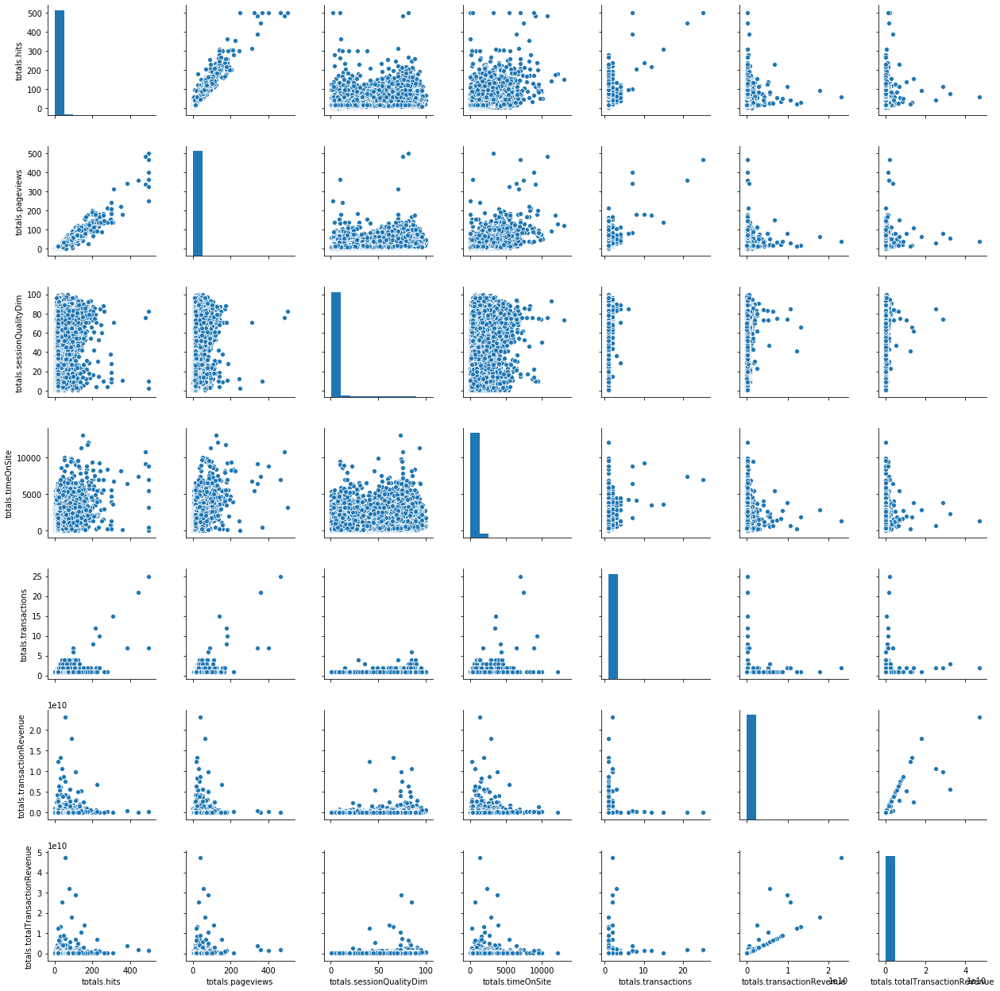

In [34]:
g = sns.pairplot(train_total)

In [35]:
def heatMap(df):
    #Create Correlation df
    corr = df.corr()
    #Plot figsize
    fig, ax = plt.subplots(figsize=(10, 10))
    #Generate Color Map
    colormap = sns.diverging_palette(220, 10, as_cmap=True)
    #Generate Heat Map, allow annotations and place floats in map
    sns.heatmap(corr, cmap=colormap, annot=True, fmt=".2f")
    #Apply xticks
    plt.xticks(range(len(corr.columns)), corr.columns);
    #Apply yticks
    plt.yticks(range(len(corr.columns)), corr.columns)
    #show plot
    plt.show()

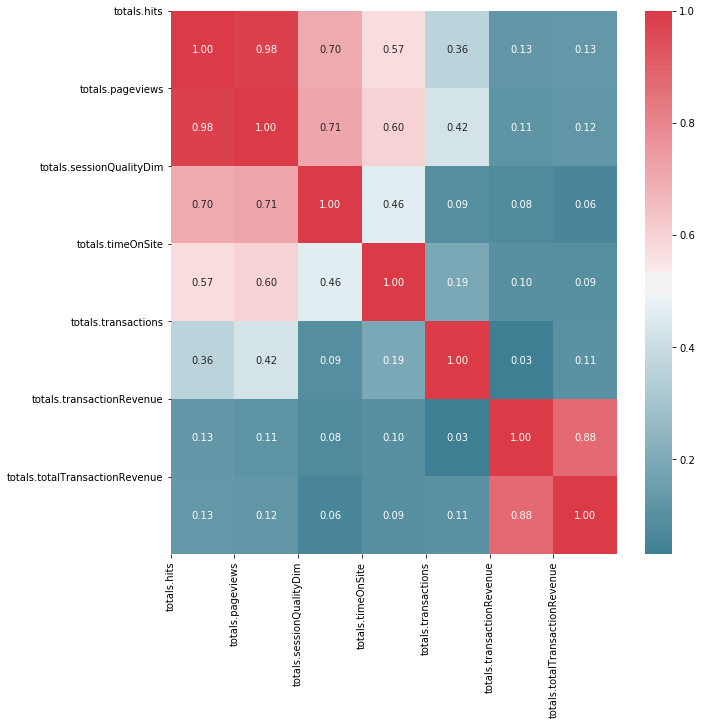

In [36]:
heatMap(train_total)

* I think we can drop either total hits or page views since they share almost same information about customers and they have same correlation with revenue

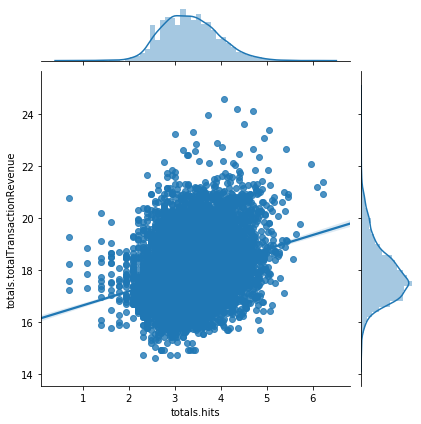

In [37]:
#sns.jointplot(x=train_df['totals.hits'], y=train_df['totals.transactionRevenue'],color ='g')
g=sns.jointplot(x=np.log(train_df['totals.hits']), y=np.log(train_df['totals.totalTransactionRevenue']),kind="reg")

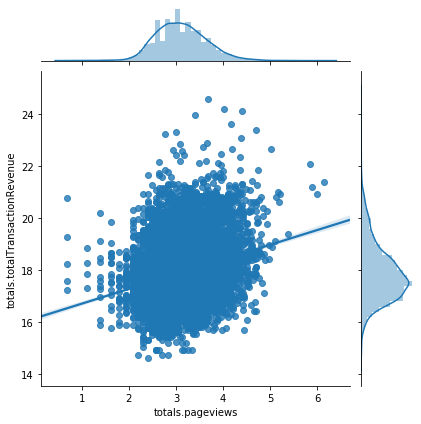

In [38]:
g=sns.jointplot(x=np.log(train_df['totals.pageviews']), y=np.log(train_df['totals.totalTransactionRevenue']),kind="reg")

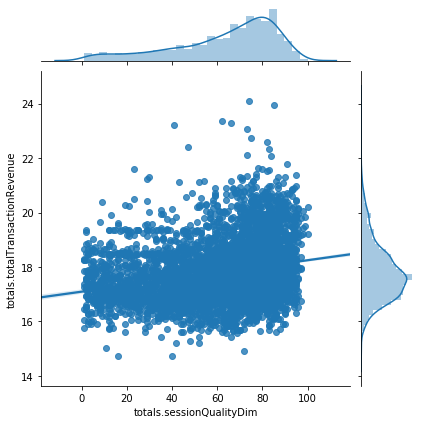

In [39]:
g=sns.jointplot(train_df['totals.sessionQualityDim'], y=np.log(train_df['totals.totalTransactionRevenue']),kind="reg")

* Both page views and total hits is highly correlated to each other. After log transformation, with simple linear regressions. Both total hits and page views is positively related to log of transaction revenues.

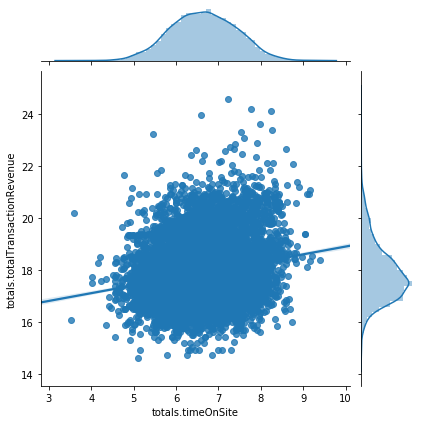

In [40]:
g=sns.jointplot(np.log(train_df['totals.timeOnSite']), y=np.log(train_df['totals.totalTransactionRevenue']),kind="reg")

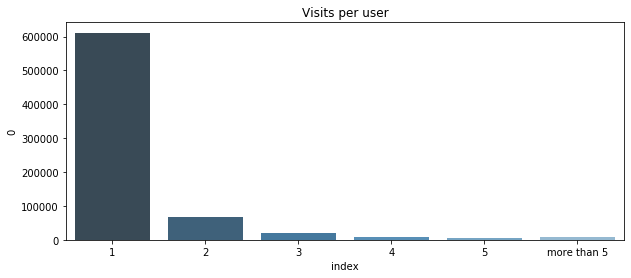

In [41]:
tmp = train_df.groupby('fullVisitorId').size().value_counts().to_frame().reset_index()
sum_ = tmp[tmp['index'].astype('int16') > 5][0].sum()
tmp = tmp.head(5).append(pd.DataFrame({'index': ['more than 5'], 0: [sum_]})).reset_index()
plt.figure(figsize=(10,4))
plt.title("Visits per user")
ax = sns.barplot(x=tmp['index'], y=tmp[0], palette='Blues_d')

***total.timeOnSite***

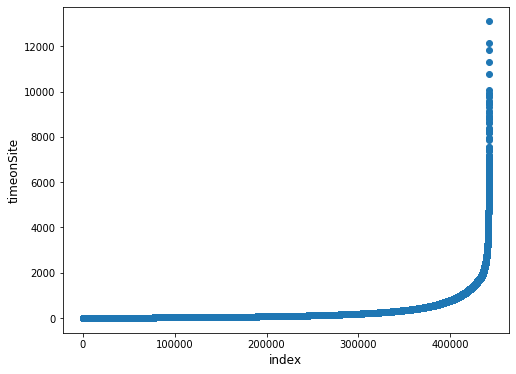

In [42]:
plt.figure(figsize=(8,6))
plt.scatter(range(train_df['totals.timeOnSite'].shape[0]), np.sort((train_df['totals.timeOnSite'].values)))
plt.xlabel('index', fontsize=12)
plt.ylabel('timeonSite', fontsize=12)
plt.show()

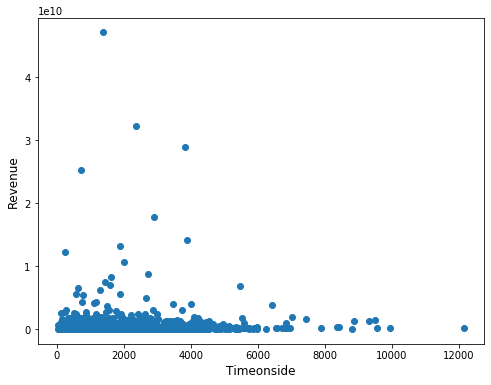

In [43]:
plt.figure(figsize=(8,6))
plt.scatter(train_df['totals.timeOnSite'], train_df['totals.totalTransactionRevenue'])
plt.xlabel('Timeonside', fontsize=12)
plt.ylabel('Revenue', fontsize=12)
plt.show()

***Traffic Source Analysis***

In [44]:
traffic=['trafficSource.campaign',
 'trafficSource.source',
 'trafficSource.medium',
 'trafficSource.keyword',
 'trafficSource.referralPath',
 'trafficSource.isTrueDirect',
 'trafficSource.adContent',
 'totals.transactionRevenue',
 'totals.totalTransactionRevenue']

In [45]:
traffic_df=train_df[traffic]

In [46]:
train_df['trafficSource.campaign'].unique()

[(not set), "google + redesign/Accessories March 17" All U..., AW - Dynamic Search Ads Whole Site, 1000557 | GA | US | en | Hybrid | GDN Text+Ban..., Data Share Promo, ..., Media & Entertainment/Music Lovers, Media & Entertainment/Movie Lovers, AW - Electronics, (direct), Page: contains "/google+redesign/electronics" ...]
Length: 30
Categories (30, object): [(not set), "google + redesign/Accessories March 17" All U..., AW - Dynamic Search Ads Whole Site, 1000557 | GA | US | en | Hybrid | GDN Text+Ban..., ..., Media & Entertainment/Movie Lovers, AW - Electronics, (direct), Page: contains "/google+redesign/electronics" ...]

* I think we can deal with this later. It looks very mass

In [47]:
train_df['trafficSource.source'].unique()

[google, sites.google.com, (direct), analytics.google.com, blog.golang.org, ..., images.google.fr, partnerads.ysm.yahoo.com, search.mywebsearch.com, collaborate.northwestern.edu, images.google.lt]
Length: 276
Categories (276, object): [google, sites.google.com, (direct), analytics.google.com, ..., partnerads.ysm.yahoo.com, search.mywebsearch.com, collaborate.northwestern.edu, images.google.lt]

In [48]:
# new = train_df['trafficSource.source'].str.split(".", n = 1, expand = True) 
# train_df['trafficSource.source1']=new[0]
# train_df['trafficSource.source1']=new[1]

Might need to do some further cleaning

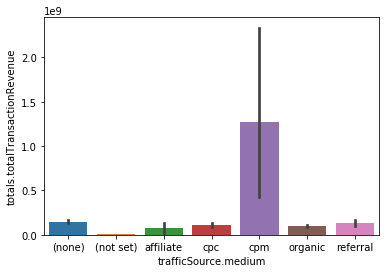

In [49]:
ax = sns.barplot(x=train_df['trafficSource.medium'], y=train_df['totals.totalTransactionRevenue'])

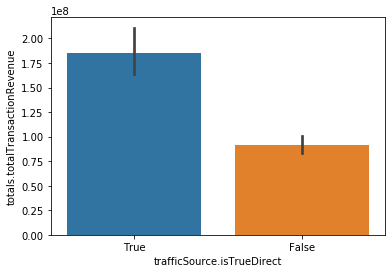

In [50]:
ax = sns.barplot(x=train_df['trafficSource.isTrueDirect'], y=train_df['totals.totalTransactionRevenue'])

In [51]:
data=train_df.groupby(["trafficSource.keyword"])["totals.totalTransactionRevenue"].sum().sort_values(ascending=False)
#sns.barplot(x="trafficSource.keyword", y="totals.totalTransactionRevenue", data=train_df)
data[1:10]

trafficSource.keyword
6qEhsCssdK0z36ri                   1.522076e+10
Google Merchandise                 1.018126e+10
google merchandise store           5.325390e+09
1hZbAqLCbjwfgOH7                   2.749490e+09
1X4Me6ZKNV0zg-jV                   1.443700e+09
+Google +Merchandise               9.551900e+08
(Remarketing/Content targeting)    3.901100e+08
online store merchandise           3.098400e+08
store merchandise                  3.018200e+08
Name: totals.totalTransactionRevenue, dtype: float64

In [52]:
train_df['trafficSource.referralPath'].unique()

array([nan,
       '/a/google.com/transportation/mtv-services/bikes/bike2workmay2016',
       '/offer/2145', ..., '/mail/mu/mp/321/',
       '/from=1000539d/bd_page_type=1/ssid=0/uid=0/pu=usm%403%2Csz%401320_2001%2Cta%40iphone_1_10.3_3_603/baiduid=1994D3C0F663986AD2C837E47F5B672B/w=0_10_/t=iphone/l=3/tc',
       '/mail/mu/mp/656/'], dtype=object)

In [53]:
train_df['trafficSource.adwordsClickInfo.page'].unique()

array([ 0,  1,  3,  2,  5,  4,  6, 14,  7,  8,  9], dtype=int64)

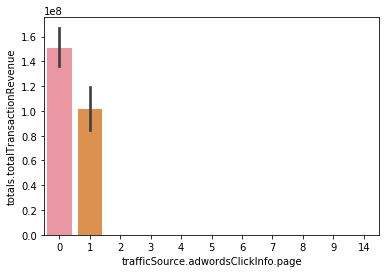

In [54]:
 ax = sns.barplot(x="trafficSource.adwordsClickInfo.page", y="totals.totalTransactionRevenue", data=train_df)

In [55]:
train_df['trafficSource.keyword'].unique()

array(['water bottle', nan, '(not provided)', ..., 'android stickers',
       'Google shirts price', 'google yutube؛com'], dtype=object)

In [56]:
train_df['trafficSource.adContent'].value_counts()
#dummy

Google Merchandise Store              37381
Google Merchandise Collection          5689
Smart display ad - 8/17/2017           1899
Google Online Store                    1598
Display Ad created 3/11/14             1273
Ad from 12/13/16                        406
{KeyWord:Google Brand Items}            390
Official Google Merchandise             329
Ad from 11/3/16                         280
Placement Accessories 300 x 250         276
{KeyWord:Google Merchandise}            199
Placement Elecronics 300 x 250          190
Full auto ad IMAGE ONLY                 188
Ad from 12/15/17                        168
Display Ad created 3/11/15              129
Ad from 11/7/16                          94
Bags 300x250                             90
Placement Office 300x250                 79
{KeyWord:Google Branded Gear}            77
Swag with Google Logos                   76
{KeyWord:Looking for Google Bags?}       75
Placement Drinkware 300x250              57
{KeyWord:Want Google Stickers?} 

In [57]:
data=train_df.groupby(["trafficSource.adContent"])["totals.totalTransactionRevenue"].sum().sort_values(ascending=False)
data[1:10]

trafficSource.adContent
Official Google Merchandise        937330000.0
{KeyWord:Google Branded Gear}      240240000.0
Full auto ad IMAGE ONLY            197930000.0
Google Online Store                185420000.0
Google Merchandise Store           148510000.0
Display Ad created 3/11/14         134340000.0
{KeyWord:Google Men's T-Shirts}     84820000.0
Placement Accessores 300 x 250      78880000.0
Office Placement 160x600            50030000.0
Name: totals.totalTransactionRevenue, dtype: float64

In [58]:
train_df['trafficSource.adwordsClickInfo.gclId'].unique()

array([nan,
       'Cj0KCQjwsZHPBRClARIsAC-VMPBHdNF2oMOgh6Xp6YhjXWSk11sDu3eCo4De_u6l4xafqgrPVPSGYdkaArkiEALw_wcB',
       'CODVoMjJ9tYCFUIvgQod_dsKEA', ..., 'CPLh_p3x89QCFQ52fgodQ30Mlg',
       'CJfqiITW8dQCFQiVfgodpSsEpQ',
       'EAIaIQobChMI7fL3t_Lz1AIV0zaBCh2sGw2eEAAYASAAEgKpFvD_BwE'],
      dtype=object)

### Drop unnecessary columns

### Feature Engineering

In [59]:
df_clean=train_df.drop(['visitId','geoNetwork.region','geoNetwork.metro','geoNetwork.city','domain',
                        'totals.transactions','totals.transactionRevenue','trafficSource.adwordsClickInfo.isVideoAd',
                        'trafficSource.source','trafficSource.campaign','trafficSource.referralPath','visitNumber',
                        'visitStartTime','trafficSource.keyword','trafficSource.adwordsClickInfo.gclId','_day','_year',
                       'trafficSource.adContent'],axis=1)

In [60]:
df_clean.head()

,channelGrouping,date,fullVisitorId,device.browser,device.operatingSystem,device.isMobile,device.deviceCategory,geoNetwork.continent,geoNetwork.subContinent,geoNetwork.country,geoNetwork.networkDomain,totals.hits,totals.pageviews,totals.bounces,totals.newVisits,totals.sessionQualityDim,totals.timeOnSite,totals.totalTransactionRevenue,trafficSource.medium,trafficSource.isTrueDirect,trafficSource.adwordsClickInfo.page,trafficSource.adwordsClickInfo.slot,trafficSource.adwordsClickInfo.adNetworkType,_weekday,_month,_visitHour
0,Organic Search,2017-10-16,3162355547410993243,Firefox,Windows,False,desktop,Europe,Western Europe,Germany,(not set),1,1.0,1.0,1.0,1.0,NaN,NaN,organic,False,0,None,Unknown,0,10,19
1,Referral,2017-10-16,8934116514970143966,Chrome,Chrome OS,False,desktop,Americas,Northern America,United States,(not set),2,2.0,0.0,0.0,2.0,28.0,NaN,referral,False,0,None,Unknown,0,10,12
2,Direct,2017-10-16,7992466427990357681,Chrome,Android,True,mobile,Americas,Northern America,United States,windjammercable.net,2,2.0,0.0,1.0,1.0,38.0,NaN,(none),True,0,None,Unknown,0,10,19
3,Organic Search,2017-10-16,9075655783635761930,Chrome,Windows,False,desktop,Asia,Western Asia,Turkey,unknown.unknown,2,2.0,0.0,1.0,1.0,1.0,NaN,organic,False,0,None,Unknown,0,10,11
4,Organic Search,2017-10-16,6960673291025684308,Chrome,Windows,False,desktop,Americas,Central America,Mexico,prod-infinitum.com.mx,2,2.0,0.0,1.0,1.0,52.0,NaN,organic,False,0,None,Unknown,0,10,16


### Fill NaN values

In [61]:
df_clean['totals.timeOnSite'] = train_df['totals.timeOnSite'].fillna(0)
df_clean['totals.totalTransactionRevenue'] = train_df['totals.totalTransactionRevenue'].fillna(0.0)
df_clean['totals.pageviews']=df_clean['totals.pageviews'].fillna(0)
df_clean['totals.sessionQualityDim']=df_clean['totals.sessionQualityDim'].fillna(0)
df_clean['totals.sessionQualityDim']=df_clean['totals.sessionQualityDim'].astype('category')
df_clean['_weekday']=df_clean['_weekday'].astype('category')
df_clean['_month']=df_clean['_month'].astype('category')
df_clean['_visitHour']=df_clean['_visitHour'].astype('category')

In [62]:
df_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 928860 entries, 0 to 928859
Data columns (total 26 columns):
channelGrouping                                 928860 non-null category
date                                            928860 non-null datetime64[ns]
fullVisitorId                                   928860 non-null object
device.browser                                  928860 non-null category
device.operatingSystem                          928860 non-null category
device.isMobile                                 928860 non-null category
device.deviceCategory                           928860 non-null category
geoNetwork.continent                            928860 non-null category
geoNetwork.subContinent                         928860 non-null category
geoNetwork.country                              928860 non-null category
geoNetwork.networkDomain                        928860 non-null category
totals.hits                                     928860 non-null int32
totals.pagev

In [63]:
df_clean['month_4']=0
df_clean.loc[df_clean['_month']==4,'month_4']=1
df_clean['isTuesdays']=0
df_clean.loc[df_clean['_weekday']==2,'isTuesdays']=1
df_clean['BS_Firefox']=0
df_clean.loc[df_clean['device.browser']=='Firefox','BS_Firefox']=1
df_clean['BS_Chrome']=0
df_clean.loc[df_clean['device.browser']=='Chrome','BS_Chrome']=1
df_clean['BS_Safari']=0
df_clean.loc[df_clean['device.browser']=='Safari','BS_Safari']=1
df_clean['BS_IE']=0
df_clean.loc[df_clean['device.browser']=='Internet Explorer','BS_IE']=1
df_clean['BS_Android']=0
df_clean.loc[df_clean['device.browser']=='Android Webview','BS_Android']=1


df_clean['OS_Windows']=0
df_clean.loc[df_clean['device.operatingSystem']=='Windows','OS_Windows']=1
df_clean['OS_Macintosh']=0
df_clean.loc[df_clean['device.operatingSystem']=='Macintosh','OS_Macintosh']=1
df_clean['OS_Android']=0
df_clean.loc[df_clean['device.operatingSystem']=='Android','OS_Android']=1
df_clean['OS_iOS']=0
df_clean.loc[df_clean['device.operatingSystem']=='iOS','OS_iOS']=1


#subContinent1: Northern America (highest non-zero revenue)
df_clean['subCont_NorthernAmerica']=0
df_clean.loc[df_clean['geoNetwork.subContinent']=='Northern America','subCont_NorthernAmerica']=1

#subContinent2: Western Africa (highest mean revenue)
df_clean['subCont_Western Africa']=0
df_clean.loc[df_clean['geoNetwork.subContinent']=='Western Africa','subCont_Western Africa']=1
#country1: US (highest non-zero revenue)
df_clean['country_USA']=0
df_clean.loc[df_clean['geoNetwork.country']=='United States','country_USA']=1
#country2: Australia (highest mean revenue)
df_clean['country_Australia']=0
df_clean.loc[df_clean['geoNetwork.country']=='Australia','country_Australia']=1

#traffic medium
df_clean['medium_cpm']=0
df_clean.loc[df_clean['trafficSource.medium']=='cpm','medium_cpm']=1

In [64]:
#get dummies
df_clean=df_clean.join(pd.get_dummies(df_clean['channelGrouping'])).drop(['(Other)'],axis = 1)
df_clean=df_clean.join(pd.get_dummies(df_clean['_visitHour'],prefix='Hour')).drop(['Hour_1','Hour_4','Hour_5','Hour_6','Hour_7','Hour_16','Hour_17','Hour_18','Hour_19','Hour_20','Hour_21','Hour_22','Hour_23'],axis = 1)
df_clean=df_clean.join(pd.get_dummies(df_clean['device.isMobile'],prefix='Mobile',drop_first=True))
df_clean=df_clean.join(pd.get_dummies(df_clean['device.deviceCategory'])).drop(['tablet','mobile'],axis = 1)
df_clean=df_clean.join(pd.get_dummies(df_clean['geoNetwork.continent'])).drop(['(not set)'],axis = 1)
df_clean=df_clean.join(pd.get_dummies(df_clean['trafficSource.isTrueDirect'],prefix='isTrueDirect',drop_first=True))

In [65]:
df_clean['sessionQuality.100'] = pd.get_dummies(df_clean['totals.sessionQualityDim'])[100]
df_clean['Slot.RHS'] = pd.get_dummies(df_clean['trafficSource.adwordsClickInfo.slot'])['RHS']
df_clean['Slot.Top'] = pd.get_dummies(df_clean['trafficSource.adwordsClickInfo.slot'])['Top']
df_clean['Network.Content'] = pd.get_dummies(df_clean['trafficSource.adwordsClickInfo.adNetworkType'])['Content']
df_clean['Network.GSearch'] = pd.get_dummies(df_clean['trafficSource.adwordsClickInfo.adNetworkType'])['Google Search']
df_clean['Network.PSearch'] = pd.get_dummies(df_clean['trafficSource.adwordsClickInfo.adNetworkType'])['Search partners']

In [66]:
df_clean=df_clean.drop(['_month','channelGrouping','_weekday','device.operatingSystem','geoNetwork.country',
                       'geoNetwork.subContinent','geoNetwork.continent','geoNetwork.networkDomain','device.isMobile',
                       'device.deviceCategory','device.browser','trafficSource.medium','trafficSource.isTrueDirect',
                       '_visitHour','trafficSource.adwordsClickInfo.adNetworkType',
              'trafficSource.adwordsClickInfo.slot', 
              'totals.sessionQualityDim'],axis=1)

In [67]:
df_clean.head()

,date,fullVisitorId,totals.hits,totals.pageviews,totals.bounces,totals.newVisits,totals.timeOnSite,totals.totalTransactionRevenue,trafficSource.adwordsClickInfo.page,month_4,isTuesdays,BS_Firefox,BS_Chrome,BS_Safari,BS_IE,BS_Android,OS_Windows,OS_Macintosh,OS_Android,OS_iOS,subCont_NorthernAmerica,subCont_Western Africa,country_USA,country_Australia,medium_cpm,Affiliates,Direct,Display,Organic Search,Paid Search,Referral,Social,Hour_0,Hour_2,Hour_3,Hour_8,Hour_9,Hour_10,Hour_11,Hour_12,Hour_13,Hour_14,Hour_15,Mobile_True,desktop,Africa,Americas,Asia,Europe,Oceania,isTrueDirect_False,sessionQuality.100,Slot.RHS,Slot.Top,Network.Content,Network.GSearch,Network.PSearch
0,2017-10-16,3162355547410993243,1,1.0,1.0,1.0,0.0,0.0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0
1,2017-10-16,8934116514970143966,2,2.0,0.0,0.0,28.0,0.0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0
2,2017-10-16,7992466427990357681,2,2.0,0.0,1.0,38.0,0.0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0
3,2017-10-16,9075655783635761930,2,2.0,0.0,1.0,1.0,0.0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,0,0
4,2017-10-16,6960673291025684308,2,2.0,0.0,1.0,52.0,0.0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0


In [68]:
df_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 928860 entries, 0 to 928859
Data columns (total 57 columns):
date                                   928860 non-null datetime64[ns]
fullVisitorId                          928860 non-null object
totals.hits                            928860 non-null int32
totals.pageviews                       928860 non-null float64
totals.bounces                         928860 non-null float64
totals.newVisits                       928860 non-null float64
totals.timeOnSite                      928860 non-null float64
totals.totalTransactionRevenue         928860 non-null float64
trafficSource.adwordsClickInfo.page    928860 non-null int32
month_4                                928860 non-null int64
isTuesdays                             928860 non-null int64
BS_Firefox                             928860 non-null int64
BS_Chrome                              928860 non-null int64
BS_Safari                              928860 non-null int64
BS_IE          

### Produce Transaction Level of Dataset for Modeling

In [69]:
df_clean = df_clean.rename(columns={'totals.totalTransactionRevenue': 'revenue', 'fullVisitorId': 'id',
                                    'trafficSource.adwordsClickInfo.page': 'TS_adwordsClickInfo.page', 
                                    'Affiliates': 'CG_Affiliates', 'Direct': 'CG_Direct','Display':'CG_Display', 
                                    'Organic Search': 'CG_organicSearch',
                                   'Paid Search': 'CG_paidSearch' ,'Referral': 'CG_Referral',
                                   'Social': 'CG_Social', 'Mobile_True': 'device_Mobile',
                                   'desktop': 'device_Desktop', 'Africa': 'cont_Africa', 
                                   'Americas': 'cont_Americas', 'Asia': 'cont_Asia',
                                   'Europe': 'cont_Europe', 'Oceania': 'cont_Oceania',
                                   'isTrueDirect_False': 'TS_isTrueDirect', 'sessionQuality.100': 'TS_sessionQuality.100',
                                   'Slot.RHS': 'TS_Slot.RHS', 'Slot.Top': 'TS_Slot.Top', 
                                    'Network.Content': 'TS_Network.Content', 'Network.GSearch': 'TS_Network.GSearch',
                                    'Network.PSearch': 'TS_Network.PSearch'})

In [70]:
df_clean.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 928860 entries, 0 to 928859
Data columns (total 57 columns):
date                        928860 non-null datetime64[ns]
id                          928860 non-null object
totals.hits                 928860 non-null int32
totals.pageviews            928860 non-null float64
totals.bounces              928860 non-null float64
totals.newVisits            928860 non-null float64
totals.timeOnSite           928860 non-null float64
revenue                     928860 non-null float64
TS_adwordsClickInfo.page    928860 non-null int32
month_4                     928860 non-null int64
isTuesdays                  928860 non-null int64
BS_Firefox                  928860 non-null int64
BS_Chrome                   928860 non-null int64
BS_Safari                   928860 non-null int64
BS_IE                       928860 non-null int64
BS_Android                  928860 non-null int64
OS_Windows                  928860 non-null int64
OS_Macintosh       

In [71]:
df_clean.to_pickle("trasaction_dataset.pkl")

### Produce Aggregation to User level of Dataset for Modeling

In [72]:
#customer dataframe cf
cf1 = pd.DataFrame()  #float data
cf2 = pd.DataFrame()  #dummy data
cf3 = pd.DataFrame()  #target revenue

In [73]:
cf1 = df_clean.iloc[:,0:6]
cf1 = cf1.groupby(['id']).agg(['sum','mean'])
cf1.columns = ['_'.join(col).strip() for col in cf1.columns.values]
#cf1.head()

In [74]:
select_columns = [1]
select_columns.extend(range(8,57))
cf2 = df_clean[df_clean.columns[select_columns]]
cf2 = cf2.groupby(['id']).agg(['max'])
cf2.columns = ['_'.join(col).strip() for col in cf2.columns.values]
cf2.head()

,TS_adwordsClickInfo.page_max,month_4_max,isTuesdays_max,BS_Firefox_max,BS_Chrome_max,BS_Safari_max,BS_IE_max,BS_Android_max,OS_Windows_max,OS_Macintosh_max,OS_Android_max,OS_iOS_max,subCont_NorthernAmerica_max,subCont_Western Africa_max,country_USA_max,country_Australia_max,medium_cpm_max,CG_Affiliates_max,CG_Direct_max,CG_Display_max,CG_organicSearch_max,CG_paidSearch_max,CG_Referral_max,CG_Social_max,Hour_0_max,Hour_2_max,Hour_3_max,Hour_8_max,Hour_9_max,Hour_10_max,Hour_11_max,Hour_12_max,Hour_13_max,Hour_14_max,Hour_15_max,device_Mobile_max,device_Desktop_max,cont_Africa_max,cont_Americas_max,cont_Asia_max,cont_Europe_max,cont_Oceania_max,TS_isTrueDirect_max,TS_sessionQuality.100_max,TS_Slot.RHS_max,TS_Slot.Top_max,TS_Network.Content_max,TS_Network.GSearch_max,TS_Network.PSearch_max
id,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,
0000000259678714014,0,0,0,0,1,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0
0000027376579751715,0,0,0,0,1,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0
0000039460501403861,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0
0000040862739425590,1,0,0,0,1,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,1,0,0,1,0,1,0
0000049363351866189,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0


In [75]:
cf3 = df_clean.groupby(['id'])['revenue'].agg(['sum'])
cf3['logRevenue'] = np.log(1+cf3['sum'])
cf3 = cf3.drop('sum', axis = 1)

In [76]:
# comebine customer dataset
cf = pd.concat([cf3, cf1, cf2], axis=1)
cf = cf.reset_index()
cf = pd.DataFrame(cf)
cf.shape

(716705, 59)

In [77]:
cf.head()

,id,logRevenue,totals.hits_sum,totals.hits_mean,totals.pageviews_sum,totals.pageviews_mean,totals.bounces_sum,totals.bounces_mean,totals.newVisits_sum,totals.newVisits_mean,TS_adwordsClickInfo.page_max,month_4_max,isTuesdays_max,BS_Firefox_max,BS_Chrome_max,BS_Safari_max,BS_IE_max,BS_Android_max,OS_Windows_max,OS_Macintosh_max,OS_Android_max,OS_iOS_max,subCont_NorthernAmerica_max,subCont_Western Africa_max,country_USA_max,country_Australia_max,medium_cpm_max,CG_Affiliates_max,CG_Direct_max,CG_Display_max,CG_organicSearch_max,CG_paidSearch_max,CG_Referral_max,CG_Social_max,Hour_0_max,Hour_2_max,Hour_3_max,Hour_8_max,Hour_9_max,Hour_10_max,Hour_11_max,Hour_12_max,Hour_13_max,Hour_14_max,Hour_15_max,device_Mobile_max,device_Desktop_max,cont_Africa_max,cont_Americas_max,cont_Asia_max,cont_Europe_max,cont_Oceania_max,TS_isTrueDirect_max,TS_sessionQuality.100_max,TS_Slot.RHS_max,TS_Slot.Top_max,TS_Network.Content_max,TS_Network.GSearch_max,TS_Network.PSearch_max
0,0000000259678714014,0.0,19,9.5,13.0,6.5,0.0,0.0,1.0,0.500000,0,0,0,0,1,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0
1,0000027376579751715,0.0,6,6.0,5.0,5.0,0.0,0.0,1.0,1.000000,0,0,0,0,1,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0
2,0000039460501403861,0.0,2,2.0,2.0,2.0,0.0,0.0,1.0,1.000000,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0
3,0000040862739425590,0.0,5,2.5,5.0,2.5,0.0,0.0,1.0,0.500000,1,0,0,0,1,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,1,0,0,1,0,1,0
4,0000049363351866189,0.0,3,1.0,3.0,1.0,3.0,1.0,1.0,0.333333,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0


In [78]:
# save to pickle
cf.to_pickle("customer_dataset.pkl")

In [79]:
cf = pd.read_pickle('customer_dataset.pkl')

In [80]:
# drop time columns
time_columns = ['month_4_max','isTuesdays_max','Hour_0_max','Hour_2_max','Hour_3_max','Hour_8_max','Hour_9_max','Hour_10_max','Hour_11_max','Hour_12_max','Hour_13_max','Hour_14_max','Hour_15_max']

In [81]:
cf = cf.drop(time_columns, axis=1)

In [82]:
cf.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 716705 entries, 0 to 716704
Data columns (total 46 columns):
id                              716705 non-null object
logRevenue                      716705 non-null float64
totals.hits_sum                 716705 non-null int32
totals.hits_mean                716705 non-null float64
totals.pageviews_sum            716705 non-null float64
totals.pageviews_mean           716705 non-null float64
totals.bounces_sum              716705 non-null float64
totals.bounces_mean             716705 non-null float64
totals.newVisits_sum            716705 non-null float64
totals.newVisits_mean           716705 non-null float64
TS_adwordsClickInfo.page_max    716705 non-null int32
BS_Firefox_max                  716705 non-null int64
BS_Chrome_max                   716705 non-null int64
BS_Safari_max                   716705 non-null int64
BS_IE_max                       716705 non-null int64
BS_Android_max                  716705 non-null int64
OS_Windo

In [15]:
x1=transaction_df.drop(['id'],axis=1)

In [17]:
import matplotlib.pyplot as plt
from sklearn.manifold import TSNE
model=TSNE(learning_rate=100)
Tsne_transformed=model.fit_transform(x1)

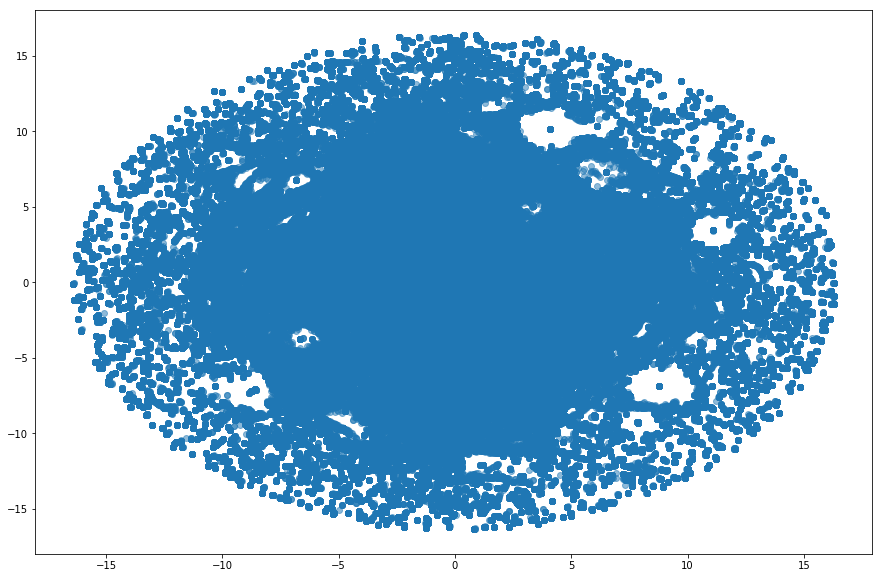

In [18]:
xs =Tsne_transformed[:,0]
ys=Tsne_transformed[:,1]
plt.figure(figsize=(15, 10))
#a = transaction_df['id'].values
#label = a.tolist()
# Scatter plot
plt.scatter(xs, ys, alpha=0.5)

### Graph Analysis

In [3]:
# import warnings
import networkx as nx
# We do this to ignore several specific Pandas warnings
import warnings
warnings.filterwarnings("ignore")
# read the data
Model_df = pd.read_pickle('trasaction_dataset.pkl')

In [4]:
Model_df.head()

,date,id,totals.hits,totals.pageviews,totals.bounces,totals.newVisits,totals.timeOnSite,revenue,TS_adwordsClickInfo.page,month_4,isTuesdays,BS_Firefox,BS_Chrome,BS_Safari,BS_IE,BS_Android,OS_Windows,OS_Macintosh,OS_Android,OS_iOS,subCont_NorthernAmerica,subCont_Western Africa,country_USA,country_Australia,medium_cpm,CG_Affiliates,CG_Direct,CG_Display,CG_organicSearch,CG_paidSearch,CG_Referral,CG_Social,Hour_0,Hour_2,Hour_3,Hour_8,Hour_9,Hour_10,Hour_11,Hour_12,Hour_13,Hour_14,Hour_15,device_Mobile,device_Desktop,cont_Africa,cont_Americas,cont_Asia,cont_Europe,cont_Oceania,TS_isTrueDirect,TS_sessionQuality.100,TS_Slot.RHS,TS_Slot.Top,TS_Network.Content,TS_Network.GSearch,TS_Network.PSearch
0,2017-10-16,3162355547410993243,1,1.0,1.0,1.0,0.0,0.0,0,0,0,1,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,0,0,0
1,2017-10-16,8934116514970143966,2,2.0,0.0,0.0,28.0,0.0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0
2,2017-10-16,7992466427990357681,2,2.0,0.0,1.0,38.0,0.0,0,0,0,0,1,0,0,0,0,0,1,0,1,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0
3,2017-10-16,9075655783635761930,2,2.0,0.0,1.0,1.0,0.0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,1,0,0,1,0,0,0,0,0,0
4,2017-10-16,6960673291025684308,2,2.0,0.0,1.0,52.0,0.0,0,0,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0


In [5]:
Model_df.shape

(928860, 57)

## Aggregated

In [62]:
##Aggregating
ID_df = Model_df.groupby(['id']).agg({'revenue':'sum'}).reset_index()
ID_df['logRev'] = np.log1p(ID_df['revenue'])
ID_df['logRev_t'] =round(ID_df['logRev'], -1)
ID_df = ID_df.drop(['revenue', 'logRev'],axis = 1)
ID_df1 = ID_df
ID_df1['id_1'] = ID_df1['id']
ID_df1 = ID_df1.drop('id',axis = 1)
ID_df = ID_df.drop('id_1',axis = 1)

In [63]:
ID_df.head()

,id,logRev_t
0,0000000259678714014,0.0
1,0000027376579751715,0.0
2,0000039460501403861,0.0
3,0000040862739425590,0.0
4,0000049363351866189,0.0


In [64]:
ID_df1.head()

,logRev_t,id_1
0,0.0,0000000259678714014
1,0.0,0000027376579751715
2,0.0,0000039460501403861
3,0.0,0000040862739425590
4,0.0,0000049363351866189


In [65]:
ID_df1.shape

(716705, 2)

In [66]:
joinme = pd.merge(ID_df1.head(100), 
                  ID_df.head(100), on='logRev_t', how='inner')
joinme = joinme[joinme['id'] != joinme['id_1']]
#joinme = ID_df.join(ID_df1, lsuffix='_1', rsuffix='_2')

In [71]:
#greater = joinme[joinme['logRev_t' ] > 0 ]

In [80]:
#greater.head()
joinme['logRev_t'].describe()

count    9508.000000
mean        0.004207
std         0.290053
min         0.000000
25%         0.000000
50%         0.000000
75%         0.000000
max        20.000000
Name: logRev_t, dtype: float64

In [83]:
import matplotlib.pyplot as plt
import networkx as nx

FG = nx.from_pandas_edgelist(joinme, source='id',
                             target='id_1', edge_attr=True)

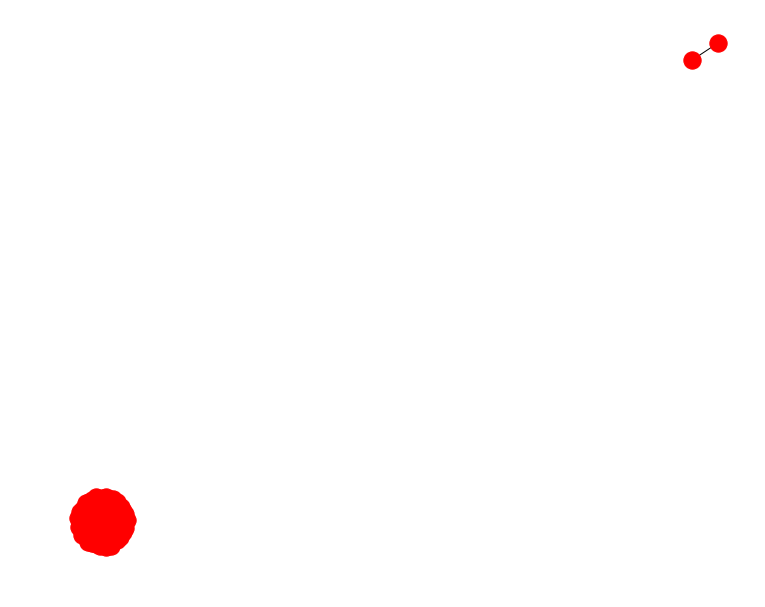

In [84]:
plt.figure(figsize=(10,8))
nx.draw(FG, with_labels=False)
plt.title()
plt.show()

## Transaction

In [50]:
## Not Aggregating 
Trans_df = Model_df[['id', 'revenue']]
    # Getting rid of zeros
Trans_df = Trans_df[Trans_df['revenue'] > 0]
    # Smaller Values
Trans_df['revenue'] = np.log1p(Trans_df['revenue'] )
Trans_df['revenue'] =round(Trans_df['revenue'], -1)

Trans_df.head()

,id,revenue
433,9549826748224805897,20.0
550,3700714855829972615,20.0
555,1572225825161580042,20.0
597,7187192533100162289,20.0
619,7889233516776348524,20.0


In [51]:
Trans_df.shape

(10488, 2)

In [57]:
joinme = pd.merge(Trans_df.head(1000), 
                  Trans_df.head(1000), on='revenue', how='inner')

In [58]:
joinme = joinme[joinme['id_x'] != joinme['id_y']]
joinme.head()

,id_x,revenue,id_y
1,9549826748224805897,20.0,3700714855829972615
2,9549826748224805897,20.0,1572225825161580042
3,9549826748224805897,20.0,7187192533100162289
4,9549826748224805897,20.0,7889233516776348524
5,9549826748224805897,20.0,1061090985384136368


In [59]:
joinme.shape

(998954, 3)

In [60]:
TG = nx.from_pandas_edgelist(joinme, source='id_x',
                             target='id_y', edge_attr=True)

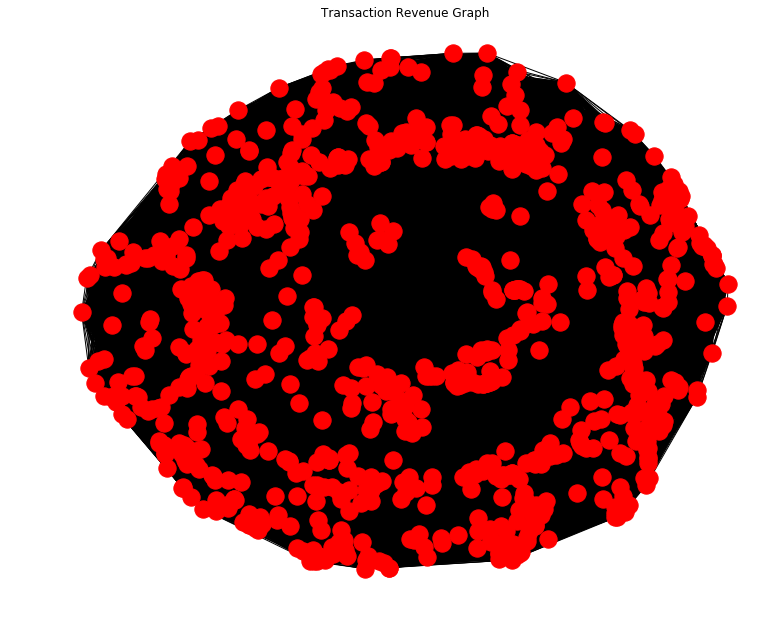

In [61]:
plt.figure(figsize=(10,8)) 
nx.draw(TG, with_labels=False)
plt.title('Transaction Revenue Graph')
plt.show()

# Country Graph Analysis

In [22]:
# read the data
Data_df = pd.read_pickle('2017_clean.pkl')

In [23]:
Data_df.head()

,channelGrouping,date,fullVisitorId,visitId,visitNumber,visitStartTime,device.browser,device.operatingSystem,device.isMobile,device.deviceCategory,geoNetwork.continent,geoNetwork.subContinent,geoNetwork.country,geoNetwork.region,geoNetwork.metro,geoNetwork.city,geoNetwork.networkDomain,totals.hits,totals.pageviews,totals.bounces,totals.newVisits,totals.sessionQualityDim,totals.timeOnSite,totals.transactions,totals.transactionRevenue,totals.totalTransactionRevenue,trafficSource.campaign,trafficSource.source,trafficSource.medium,trafficSource.keyword,trafficSource.referralPath,trafficSource.isTrueDirect,trafficSource.adContent,trafficSource.adwordsClickInfo.page,trafficSource.adwordsClickInfo.slot,trafficSource.adwordsClickInfo.gclId,trafficSource.adwordsClickInfo.adNetworkType,trafficSource.adwordsClickInfo.isVideoAd
0,Organic Search,20171016,3162355547410993243,1508198450,1,1508198450,Firefox,Windows,False,desktop,Europe,Western Europe,Germany,not available in demo dataset,not available in demo dataset,not available in demo dataset,(not set),1,1,1,1,1,NaN,NaN,NaN,NaN,(not set),google,organic,water bottle,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Referral,20171016,8934116514970143966,1508176307,6,1508176307,Chrome,Chrome OS,False,desktop,Americas,Northern America,United States,California,San Francisco-Oakland-San Jose CA,Cupertino,(not set),2,2,NaN,NaN,2,28,NaN,NaN,NaN,(not set),sites.google.com,referral,NaN,/a/google.com/transportation/mtv-services/bike...,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,Direct,20171016,7992466427990357681,1508201613,1,1508201613,Chrome,Android,True,mobile,Americas,Northern America,United States,not available in demo dataset,not available in demo dataset,not available in demo dataset,windjammercable.net,2,2,NaN,1,1,38,NaN,NaN,NaN,(not set),(direct),(none),NaN,NaN,True,NaN,NaN,NaN,NaN,NaN,NaN
3,Organic Search,20171016,9075655783635761930,1508169851,1,1508169851,Chrome,Windows,False,desktop,Asia,Western Asia,Turkey,not available in demo dataset,not available in demo dataset,not available in demo dataset,unknown.unknown,2,2,NaN,1,1,1,NaN,NaN,NaN,(not set),google,organic,(not provided),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,Organic Search,20171016,6960673291025684308,1508190552,1,1508190552,Chrome,Windows,False,desktop,Americas,Central America,Mexico,not available in demo dataset,not available in demo dataset,not available in demo dataset,prod-infinitum.com.mx,2,2,NaN,1,1,52,NaN,NaN,NaN,(not set),google,organic,(not provided),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [24]:
Data_df.shape

(928860, 38)

In [25]:
country_df = Data_df.loc[:, ['fullVisitorId', 'totals.transactionRevenue', 'geoNetwork.country']]
country_df
country_df['totals.transactionRevenue'] = country_df['totals.transactionRevenue'].fillna(0)
country_df.head()


,fullVisitorId,totals.transactionRevenue,geoNetwork.country
0,3162355547410993243,0,Germany
1,8934116514970143966,0,United States
2,7992466427990357681,0,United States
3,9075655783635761930,0,Turkey
4,6960673291025684308,0,Mexico


In [26]:
this = country_df.loc[:,['fullVisitorId', 'geoNetwork.country']].groupby(['fullVisitorId','geoNetwork.country']).count()
thisone = pd.DataFrame(data=this)
thisone = thisone.reset_index().groupby(['fullVisitorId'])['geoNetwork.country'].count()
thisone = pd.DataFrame(data=thisone)
thisone.head()
#newone.head()
newone = thisone[thisone['geoNetwork.country'] > 1]
#this.head()['fullVisitorId'].groupby(['fullVisitorId']).count()
#this.fullVisitorId.value_counts().reset_index(name="count").query("count > 1")

In [27]:
newone.shape
newone.head()

,geoNetwork.country
fullVisitorId,
0001443073703122175,2
0005094333993051683,2
001200059980206303,2
0020154188200921440,2
0020485187797701428,2


In [28]:
newone = newone.reset_index()

In [29]:
newone['fullVisitorId'].values

array(['0001443073703122175', '0005094333993051683', '001200059980206303',
       ..., '9981909572028782797', '9981950556215622891',
       '9994243962714531084'], dtype=object)

### Comparing Revenue

In [30]:
joinme = pd.merge(newone['fullVisitorId'], 
                  country_df, on='fullVisitorId', how='left')
joinme.head()

,fullVisitorId,totals.transactionRevenue,geoNetwork.country
0,0001443073703122175,0,United States
1,0001443073703122175,0,United States
2,0001443073703122175,0,Philippines
3,0001443073703122175,0,United States
4,0005094333993051683,0,Ireland


In [31]:
joinme.shape

(10478, 3)

In [13]:
jjiin = pd.merge(joinme.loc[:,['fullVisitorId', 'totals.transactionRevenue']],
                 joinme.loc[:,['fullVisitorId', 'totals.transactionRevenue']],
                 on = 'totals.transactionRevenue', how = 'inner')
jjiin.head()

,fullVisitorId_x,totals.transactionRevenue,fullVisitorId_y
0,0001443073703122175,0,0001443073703122175
1,0001443073703122175,0,0001443073703122175
2,0001443073703122175,0,0001443073703122175
3,0001443073703122175,0,0001443073703122175
4,0001443073703122175,0,0005094333993051683


In [14]:
jjiin.shape

(105843230, 3)

In [15]:
TG = nx.from_pandas_edgelist(jjiin, source='fullVisitorId_x',
                             target='fullVisitorId_y', edge_attr=True)

/Users/hank/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


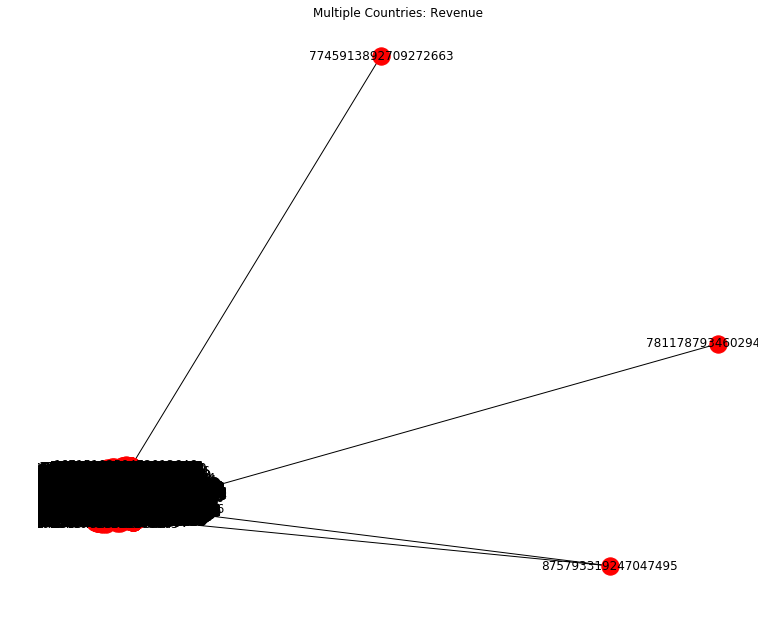

In [16]:
plt.figure(figsize=(20,20))
nx.draw(TG, with_labels=True)
plt.title('Multiple Countries: Revenue')
plt.show()

In [41]:
Data_df[Data_df['fullVisitorId'] == '7745913892709272663']

,channelGrouping,date,fullVisitorId,visitId,visitNumber,visitStartTime,device.browser,device.operatingSystem,device.isMobile,device.deviceCategory,geoNetwork.continent,geoNetwork.subContinent,geoNetwork.country,geoNetwork.region,geoNetwork.metro,geoNetwork.city,geoNetwork.networkDomain,totals.hits,totals.pageviews,totals.bounces,totals.newVisits,totals.sessionQualityDim,totals.timeOnSite,totals.transactions,totals.transactionRevenue,totals.totalTransactionRevenue,trafficSource.campaign,trafficSource.source,trafficSource.medium,trafficSource.keyword,trafficSource.referralPath,trafficSource.isTrueDirect,trafficSource.adContent,trafficSource.adwordsClickInfo.page,trafficSource.adwordsClickInfo.slot,trafficSource.adwordsClickInfo.gclId,trafficSource.adwordsClickInfo.adNetworkType,trafficSource.adwordsClickInfo.isVideoAd
283013,Organic Search,20170731,7745913892709272663,1501535980,2,1501535980,Chrome,Windows,False,desktop,Asia,Southeast Asia,Indonesia,(not set),(not set),(not set),sl-reverse.com,28,26,NaN,NaN,15,3207,1,39990000,43990000,(not set),google,organic,(not provided),NaN,True,NaN,NaN,NaN,NaN,NaN,NaN
630105,Organic Search,20170728,7745913892709272663,1501226854,1,1501226854,Chrome,Windows,False,desktop,(not set),(not set),(not set),(not set),(not set),(not set),leaseweb.com,12,12,NaN,1,1,1367,1,13290000,14290000,(not set),google,organic,(not provided),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [42]:
joinme[joinme['fullVisitorId'] == '7745913892709272663']

,fullVisitorId,totals.transactionRevenue,geoNetwork.country
8174,7745913892709272663,39990000,Indonesia
8175,7745913892709272663,13290000,(not set)


### Comparing Country

In [17]:
jjiin = pd.merge(joinme.loc[:,['fullVisitorId', 'geoNetwork.country']],
                 joinme.loc[:,['fullVisitorId', 'geoNetwork.country']],
                 on = 'geoNetwork.country', how = 'inner')
jjiin.head()

,fullVisitorId_x,geoNetwork.country,fullVisitorId_y
0,0001443073703122175,United States,0001443073703122175
1,0001443073703122175,United States,0001443073703122175
2,0001443073703122175,United States,0001443073703122175
3,0001443073703122175,United States,001200059980206303
4,0001443073703122175,United States,001200059980206303


In [18]:
CG = nx.from_pandas_edgelist(jjiin, source='fullVisitorId_x',
                             target='fullVisitorId_y', edge_attr=True)

/Users/hank/anaconda3/lib/python3.7/site-packages/networkx/drawing/nx_pylab.py:611: MatplotlibDeprecationWarning: isinstance(..., numbers.Number)
  if cb.is_numlike(alpha):


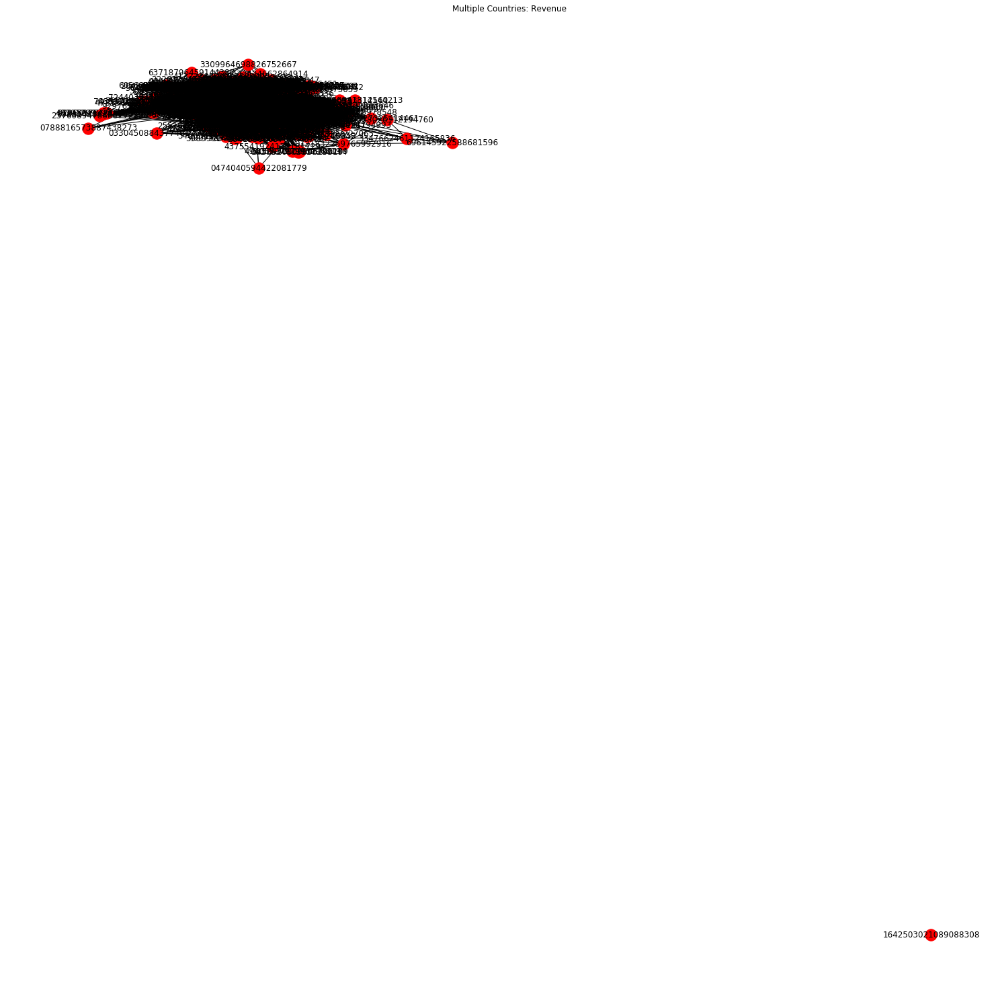

In [19]:
plt.figure(figsize=(20,20))
nx.draw(CG, with_labels=True)
plt.title('Multiple Countries: Country')
plt.show()

## Modeling

### Modeling on Transaction Level

In [3]:
# read the data
Model_df = pd.read_pickle('trasaction_dataset.pkl')

In [20]:
# Importing Libraries
from sklearn.linear_model import Lasso
from sklearn.linear_model import Ridge
from sklearn.linear_model import LinearRegression
import xgboost 
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import GridSearchCV, cross_val_score, StratifiedKFold, learning_curve,GroupShuffleSplit
from sklearn.metrics import accuracy_score
from sklearn.metrics import explained_variance_score
# Importing Classifier Modules
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor

from sklearn.model_selection import cross_val_score
from sklearn.metrics import mean_squared_error as MSE
import sklearn.model_selection as cv

In [5]:
#split train test datset
#Split dataset with individual id instead of spliting it into transaction levels
seed=3
X = Model_df.drop(['revenue'],axis = 1)
y = Model_df.loc[:,['id','revenue']]
#np.log1p()
train_inds,test_inds= next(GroupShuffleSplit(test_size=0.20,n_splits=2,random_state=3).split(X,groups=X['id']))
X_train=X.loc[train_inds]
X_test =X.loc[test_inds]
y_train=y.loc[train_inds]
y_test=y.loc[test_inds]


y_train=np.log1p(y_train.drop(['id'],axis=1)).values[:,0]
y_test=np.log1p(y_test.drop(['id'],axis=1)).values[:,0]
#X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=.20,random_state=seed)

In [6]:
train_date=X_train['date']
train_id=X_train['id']
X_train=X_train.drop(['id','date'],axis=1)
test_date=X_test['date']
test_id=X_test['id']
X_test=X_test.drop(['id','date'],axis=1)

Target, prediction process
* 1st log1p to target
* 2nd exmp1 predictions
* 3rd sum predictions
* 4th log1p to sum

**Linear Model**

In [88]:
reg = LinearRegression()
reg.fit(X_train,y_train)

LinearRegression(copy_X=True, fit_intercept=True, n_jobs=None, normalize=False)

**RMSE results for Models**

In [89]:
predictions = reg.predict(X_test)
mse_dt = MSE(predictions, y_test)
# Compute rmse_dt
rmse_dt = mse_dt**(1/2)
# Print rmse_dt
print("Test set RMSE of dt: {}".format(rmse_dt))

Test set RMSE of dt: 1.7242635658286491


In [90]:
# Import mean_squared_error from sklearn.metrics as MSE
from sklearn.metrics import mean_squared_error as MSE

# Predict the labels of the training set
y_pred_train = reg.predict(X_train)

# Evaluate the training set RMSE of dt
RMSE_train = (MSE(y_train, y_pred_train))**(1/2)

# Print RMSE_train
print('Train RMSE: {}'.format(RMSE_train))

Train RMSE: 1.7250503237664636


In [91]:
scores = cross_val_score(reg, X_train, y_train, cv=10, scoring='neg_mean_squared_error')
score_description = " %0.5f (+/- %0.5f)" % (np.sqrt(scores.mean()*-1), scores.std() * 2)

In [92]:
print('{model:25} CV-5 RMSE: {score}'.format(
 model=reg.__class__.__name__,
 score=score_description
 ))

LinearRegression          CV-5 RMSE:  1.72568 (+/- 0.33559)


**Visual Presentation of Model results**

In [93]:
log_revenue_compare=pd.DataFrame({'date': train_date, 'log_revenue_pred': y_pred_train,'log_revenue_actual':y_train})

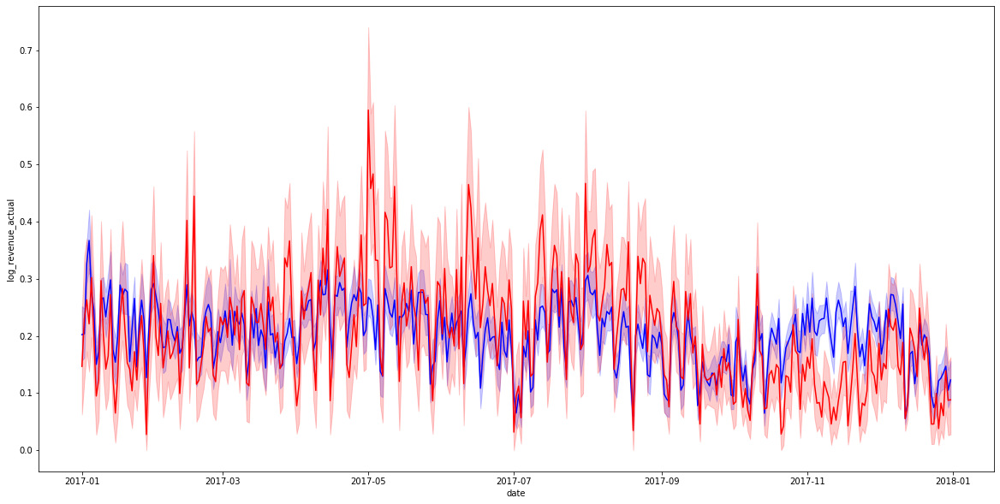

In [94]:
plt.figure(figsize=(20,10))
ax = sns.lineplot(x="date", y="log_revenue_pred", data=log_revenue_compare,color='b')
ax = sns.lineplot(x="date", y="log_revenue_actual", data=log_revenue_compare,color='r')

**RMSE after aggregating into user level**

In [95]:
y_pred_train[y_pred_train<0]=0

In [96]:
revenue_per_user=pd.DataFrame({'user_id': np.array(train_id), 'revenue_pred': np.expm1(y_pred_train),'revenue_actual': np.expm1(y_train)})
revenue_per_user=revenue_per_user.groupby(['user_id']).agg({'revenue_pred':'sum','revenue_actual':'sum'}).reset_index()
revenue_per_user['log_sum_pred']=np.log1p(revenue_per_user['revenue_pred'])
revenue_per_user['log_sum_actual']=np.log1p(revenue_per_user['revenue_actual'])
revenue_per_user=revenue_per_user.drop(['revenue_pred','revenue_actual'],axis=1)

In [97]:
# Evaluate the training set RMSE of dt
RMSE_train = (MSE(revenue_per_user['log_sum_pred'], revenue_per_user['log_sum_actual']))**(1/2)

# Print RMSE_train
print('Train RMSE: {}'.format(RMSE_train))

Train RMSE: 1.7801394521566036


In [98]:
predictions[predictions<0]=0

In [99]:
revenue_per_user_test=pd.DataFrame({'user_id': test_id, 'revenue_pred': np.expm1(predictions), 'revenue_actual': np.expm1(y_test)})
revenue_per_user_test=revenue_per_user_test.groupby(['user_id']).agg({'revenue_pred':'sum','revenue_actual':'sum'}).reset_index()
revenue_per_user_test['log_sum_pred']=np.log1p(revenue_per_user_test['revenue_pred'])
revenue_per_user_test['log_sum_actual']=np.log1p(revenue_per_user_test['revenue_actual'])
revenue_per_user_test=revenue_per_user_test.drop(['revenue_pred','revenue_actual'],axis=1)

In [100]:
mse_dt = (MSE(revenue_per_user_test['log_sum_pred'], revenue_per_user_test['log_sum_actual']))**(1/2)

# Print rmse_dt
print("Test set RMSE of dt: {}".format(rmse_dt))

Test set RMSE of dt: 1.7242635658286491


In [101]:
###Cross validation for aggregate results
from sklearn.model_selection import cross_val_predict
# Compute the array containing the 10-folds CV MSEs


cross_val_pred = cross_val_predict(reg, X_train, y_train, cv=10, 
                                  groups = train_id, 
                                  n_jobs=-1) 

# Compute the 10-folds CV RMSE
#RMSE_CV = (MSE_CV_scores.mean())**(1/2)

# Print RMSE_CV
#print('CV RMSE: {}'.format(RMSE_CV))


cross_val_pred[cross_val_pred<0] = 0


revenue_per_user=pd.DataFrame({'user_id': train_id, 'revenue_pred': np.expm1(cross_val_pred),
                               'revenue_actual': np.expm1(y_train)})
revenue_per_user=revenue_per_user.groupby(['user_id']).agg({'revenue_pred':'sum',
                                                            'revenue_actual':'sum'}).reset_index()
revenue_per_user['log_sum_pred']=np.log1p(revenue_per_user['revenue_pred'])
revenue_per_user['log_sum_actual']=np.log1p(revenue_per_user['revenue_actual'])
revenue_per_user=revenue_per_user.drop(['revenue_pred','revenue_actual'],axis=1)


################NEW BOX#################################################

###TESTING NEW WAY 
# Evaluate the training set RMSE of dt
RMSE_train = (MSE(revenue_per_user['log_sum_pred'], revenue_per_user['log_sum_actual']))**(1/2)

# Print RMSE_train
print('CV RMSE: {}'.format(RMSE_train))

CV RMSE: 1.7807763160141143


**XGBoost**

In [102]:
xgb = xgboost.XGBRegressor(n_estimators=100, learning_rate=0.05, gamma=0, subsample=0.75,
                           colsample_bytree=1, max_depth=5)



xgb.fit(X_train,y_train)
predictions = xgb.predict(X_test)

[15:08:37] WARNING: C:/Jenkins/workspace/xgboost-win64_release_0.90/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


**RMSE results for Models**

In [103]:
mse_dt = MSE(predictions, y_test)
# Compute rmse_dt
rmse_dt = mse_dt**(1/2)
# Print rmse_dt
print("Test set RMSE of dt: {}".format(rmse_dt))

Test set RMSE of dt: 1.555605940031043


In [104]:
# Import mean_squared_error from sklearn.metrics as MSE
from sklearn.metrics import mean_squared_error as MSE

# Predict the labels of the training set
y_pred_train = xgb.predict(X_train)

# Evaluate the training set RMSE of dt
RMSE_train = (MSE(y_train, y_pred_train))**(1/2)

# Print RMSE_train
print('Train RMSE: {}'.format(RMSE_train))

Train RMSE: 1.534108957052807


In [105]:
from sklearn.model_selection import cross_val_score
# Compute the array containing the 10-folds CV MSEs
MSE_CV_scores = - cross_val_score(xgb, X_train, y_train, cv=10, 
                                  scoring='neg_mean_squared_error', 
                                  n_jobs=-1) 

# Compute the 10-folds CV RMSE
RMSE_CV = (MSE_CV_scores.mean())**(1/2)

# Print RMSE_CV
#print('CV RMSE: {}'.format(RMSE_CV))

In [106]:
print('CV RMSE: {}'.format(RMSE_CV))

CV RMSE: 1.5561464070655433


**RMSE after aggregating into user level**

In [107]:
y_pred_train[y_pred_train<0]=0

In [108]:
revenue_per_user=pd.DataFrame({'user_id': train_id, 'revenue_pred': np.expm1(y_pred_train), 'revenue_actual': np.expm1(y_train)})
revenue_per_user=revenue_per_user.groupby(['user_id']).agg({'revenue_pred':'sum','revenue_actual':'sum'}).reset_index()
revenue_per_user['log_sum_pred']=np.log1p(revenue_per_user['revenue_pred'])
revenue_per_user['log_sum_actual']=np.log1p(revenue_per_user['revenue_actual'])
revenue_per_user=revenue_per_user.drop(['revenue_pred','revenue_actual'],axis=1)

In [109]:
# Evaluate the training set RMSE of dt
RMSE_train = (MSE(revenue_per_user['log_sum_pred'], revenue_per_user['log_sum_actual']))**(1/2)

# Print RMSE_train
print('Train RMSE: {}'.format(RMSE_train))

Train RMSE: 1.5531229538378954


In [110]:
predictions[predictions<0]=0

In [111]:
revenue_per_user_test=pd.DataFrame({'user_id': test_id, 'revenue_pred': np.expm1(predictions), 'revenue_actual': np.expm1(y_test)})
revenue_per_user_test=revenue_per_user_test.groupby(['user_id']).agg({'revenue_pred':'sum','revenue_actual':'sum'}).reset_index()
revenue_per_user_test['log_sum_pred']=np.log1p(revenue_per_user_test['revenue_pred'])
revenue_per_user_test['log_sum_actual']=np.log1p(revenue_per_user_test['revenue_actual'])
revenue_per_user_test=revenue_per_user_test.drop(['revenue_pred','revenue_actual'],axis=1)

In [112]:
mse_dt = (MSE(revenue_per_user_test['log_sum_pred'], revenue_per_user_test['log_sum_actual']))**(1/2)

# Print rmse_dt
print("Test set RMSE of dt: {}".format(rmse_dt))

Test set RMSE of dt: 1.555605940031043


In [113]:
###Cross validation for aggregate results
from sklearn.model_selection import cross_val_predict
# Compute the array containing the 10-folds CV MSEs


cross_val_pred = cross_val_predict(xgb, X_train, y_train, cv=10, 
                                  groups = train_id, 
                                  n_jobs=-1) 

# Compute the 10-folds CV RMSE
#RMSE_CV = (MSE_CV_scores.mean())**(1/2)

# Print RMSE_CV
#print('CV RMSE: {}'.format(RMSE_CV))


cross_val_pred[cross_val_pred<0] = 0


revenue_per_user=pd.DataFrame({'user_id': train_id, 'revenue_pred': np.expm1(cross_val_pred),
                               'revenue_actual': np.expm1(y_train)})
revenue_per_user=revenue_per_user.groupby(['user_id']).agg({'revenue_pred':'sum',
                                                            'revenue_actual':'sum'}).reset_index()
revenue_per_user['log_sum_pred']=np.log1p(revenue_per_user['revenue_pred'])
revenue_per_user['log_sum_actual']=np.log1p(revenue_per_user['revenue_actual'])
revenue_per_user=revenue_per_user.drop(['revenue_pred','revenue_actual'],axis=1)


################NEW BOX#################################################

###TESTING NEW WAY 
# Evaluate the training set RMSE of dt
RMSE_train = (MSE(revenue_per_user['log_sum_pred'], revenue_per_user['log_sum_actual']))**(1/2)

# Print RMSE_train
print('CV RMSE: {}'.format(RMSE_train))

CV RMSE: 1.573531185957382


**Gradiant Boost**

In [114]:
from sklearn import ensemble
# Fit regression model
params = {'n_estimators': 500, 'max_depth': 5, 'min_samples_split': 2,
          'learning_rate': 0.01, 'loss': 'ls'}
gradient = ensemble.GradientBoostingRegressor(**params)

gradient.fit(X_train, y_train)

GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
                          learning_rate=0.01, loss='ls', max_depth=5,
                          max_features=None, max_leaf_nodes=None,
                          min_impurity_decrease=0.0, min_impurity_split=None,
                          min_samples_leaf=1, min_samples_split=2,
                          min_weight_fraction_leaf=0.0, n_estimators=500,
                          n_iter_no_change=None, presort='auto',
                          random_state=None, subsample=1.0, tol=0.0001,
                          validation_fraction=0.1, verbose=0, warm_start=False)

**RMSE results for Models**

In [115]:
# Predict the test set labels 'y_pred' 
predictions = gradient.predict(X_test) 
y_pred_train=gradient.predict(X_train) 

# Evaluate the test set RMSE 
rmse_test = MSE(y_test, predictions)**(1/2) 
rmse_train = MSE(y_train, y_pred_train)**(1/2)

print("Test set RMSE of dt: {}".format(rmse_dt))
print('Train RMSE: {}'.format(rmse_train))

Test set RMSE of dt: 1.555605940031043
Train RMSE: 1.5357389804584805


In [116]:
from sklearn.model_selection import cross_val_score
# Compute the array containing the 10-folds CV MSEs
MSE_CV_scores = - cross_val_score(gradient, X_train, y_train, cv=10, 
                                  scoring='neg_mean_squared_error', 
                                  n_jobs=-1) 

# Compute the 10-folds CV RMSE
RMSE_CV = (MSE_CV_scores.mean())**(1/2)

# Print RMSE_CV
print('CV RMSE: {}'.format(RMSE_CV))

CV RMSE: 1.5578016856408166


**RMSE after aggregating into user level**

In [117]:
y_pred_train[y_pred_train<0]=0

In [118]:
revenue_per_user=pd.DataFrame({'user_id': train_id, 'revenue_pred': np.expm1(y_pred_train), 'revenue_actual': np.expm1(y_train)})
revenue_per_user=revenue_per_user.groupby(['user_id']).agg({'revenue_pred':'sum','revenue_actual':'sum'}).reset_index()
revenue_per_user['log_sum_pred']=np.log1p(revenue_per_user['revenue_pred'])
revenue_per_user['log_sum_actual']=np.log1p(revenue_per_user['revenue_actual'])
revenue_per_user=revenue_per_user.drop(['revenue_pred','revenue_actual'],axis=1)

In [119]:
# Evaluate the training set RMSE of dt
RMSE_train = (MSE(revenue_per_user['log_sum_pred'], revenue_per_user['log_sum_actual']))**(1/2)

# Print RMSE_train
print('Train RMSE: {}'.format(RMSE_train))

Train RMSE: 1.5546271533611733


In [120]:
predictions[predictions<0]=0

In [121]:
revenue_per_user_test=pd.DataFrame({'user_id': test_id, 'revenue_pred': np.expm1(predictions), 'revenue_actual': np.expm1(y_test)})
revenue_per_user_test=revenue_per_user_test.groupby(['user_id']).agg({'revenue_pred':'sum','revenue_actual':'sum'}).reset_index()
revenue_per_user_test['log_sum_pred']=np.log1p(revenue_per_user_test['revenue_pred'])
revenue_per_user_test['log_sum_actual']=np.log1p(revenue_per_user_test['revenue_actual'])
revenue_per_user_test=revenue_per_user_test.drop(['revenue_pred','revenue_actual'],axis=1)

In [122]:
mse_dt = (MSE(revenue_per_user_test['log_sum_pred'], revenue_per_user_test['log_sum_actual']))**(1/2)

# Print rmse_dt
print("Test set RMSE of dt: {}".format(rmse_dt))

Test set RMSE of dt: 1.555605940031043


In [123]:
###Cross validation for aggregate results
from sklearn.model_selection import cross_val_predict
# Compute the array containing the 10-folds CV MSEs


cross_val_pred = cross_val_predict(gradient, X_train, y_train, cv=10, 
                                  groups = train_id, 
                                  n_jobs=-1) 

# Compute the 10-folds CV RMSE
#RMSE_CV = (MSE_CV_scores.mean())**(1/2)

# Print RMSE_CV
#print('CV RMSE: {}'.format(RMSE_CV))


cross_val_pred[cross_val_pred<0] = 0


revenue_per_user=pd.DataFrame({'user_id': train_id, 'revenue_pred': np.expm1(cross_val_pred),
                               'revenue_actual': np.expm1(y_train)})
revenue_per_user=revenue_per_user.groupby(['user_id']).agg({'revenue_pred':'sum',
                                                            'revenue_actual':'sum'}).reset_index()
revenue_per_user['log_sum_pred']=np.log1p(revenue_per_user['revenue_pred'])
revenue_per_user['log_sum_actual']=np.log1p(revenue_per_user['revenue_actual'])
revenue_per_user=revenue_per_user.drop(['revenue_pred','revenue_actual'],axis=1)


################NEW BOX#################################################

###TESTING NEW WAY 
# Evaluate the training set RMSE of dt
RMSE_train = (MSE(revenue_per_user['log_sum_pred'], revenue_per_user['log_sum_actual']))**(1/2)

# Print RMSE_train
print('CV RMSE: {}'.format(RMSE_train))

CV RMSE: 1.5752193527561875


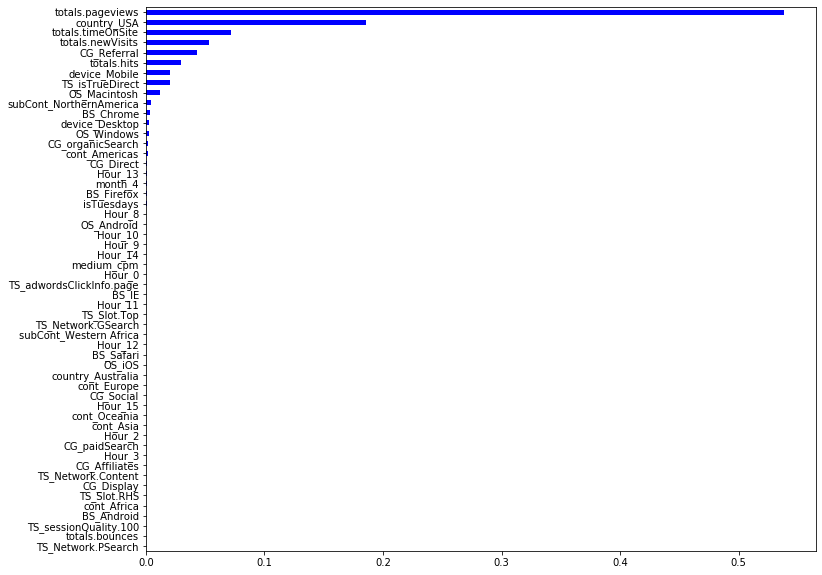

In [156]:
# Create a pd.Series of features importances
importances_grad = pd.Series(gradient.feature_importances_,
index = X_train.columns)

# Sort importances_rf
sorted_importances_grad = importances_grad.sort_values()

# Make a horizontal bar plot
plt.figure(figsize=(12, 10))  
sorted_importances_grad.plot(kind='barh', color='blue')
plt.show()

**Random Forest**

In [124]:
rfr=RandomForestRegressor(max_depth=6, random_state=seed,n_estimators=500)
rfr.fit(X_train,y_train)

RandomForestRegressor(bootstrap=True, criterion='mse', max_depth=6,
                      max_features='auto', max_leaf_nodes=None,
                      min_impurity_decrease=0.0, min_impurity_split=None,
                      min_samples_leaf=1, min_samples_split=2,
                      min_weight_fraction_leaf=0.0, n_estimators=500,
                      n_jobs=None, oob_score=False, random_state=3, verbose=0,
                      warm_start=False)

**RMSE results for Models**

In [125]:
predictions=rfr.predict(X_test)
mse_dt = MSE(predictions, y_test)
# Compute rmse_dt
rmse_dt = mse_dt**(1/2)
# Print rmse_dt
print("Test set RMSE of dt: {}".format(rmse_dt))

Test set RMSE of dt: 1.5751206763517678


In [126]:
# Import mean_squared_error from sklearn.metrics as MSE
from sklearn.metrics import mean_squared_error as MSE

# Predict the labels of the training set
y_pred_train = rfr.predict(X_train)

# Evaluate the training set RMSE of dt
RMSE_train = (MSE(y_train, y_pred_train))**(1/2)

# Print RMSE_train
print('Train RMSE: {}'.format(RMSE_train))

Train RMSE: 1.5682762327992321


**RMSE after aggregating into user level**

In [128]:
y_pred_train[y_pred_train<0]=0

In [129]:
revenue_per_user=pd.DataFrame({'user_id': train_id, 'revenue_pred': np.expm1(y_pred_train), 'revenue_actual': np.expm1(y_train)})
revenue_per_user=revenue_per_user.groupby(['user_id']).agg({'revenue_pred':'sum','revenue_actual':'sum'}).reset_index()
revenue_per_user['log_sum_pred']=np.log1p(revenue_per_user['revenue_pred'])
revenue_per_user['log_sum_actual']=np.log1p(revenue_per_user['revenue_actual'])
revenue_per_user=revenue_per_user.drop(['revenue_pred','revenue_actual'],axis=1)

In [130]:
# Evaluate the training set RMSE of dt
RMSE_train = (MSE(revenue_per_user['log_sum_pred'], revenue_per_user['log_sum_actual']))**(1/2)

# Print RMSE_train
print('Train RMSE: {}'.format(RMSE_train))

Train RMSE: 1.5874213766753824


In [131]:
predictions[predictions<0]=0

In [132]:
revenue_per_user_test=pd.DataFrame({'user_id': test_id, 'revenue_pred': np.expm1(predictions), 'revenue_actual': np.expm1(y_test)})
revenue_per_user_test=revenue_per_user_test.groupby(['user_id']).agg({'revenue_pred':'sum','revenue_actual':'sum'}).reset_index()
revenue_per_user_test['log_sum_pred']=np.log1p(revenue_per_user_test['revenue_pred'])
revenue_per_user_test['log_sum_actual']=np.log1p(revenue_per_user_test['revenue_actual'])
revenue_per_user_test=revenue_per_user_test.drop(['revenue_pred','revenue_actual'],axis=1)

In [133]:
mse_dt = (MSE(revenue_per_user_test['log_sum_pred'], revenue_per_user_test['log_sum_actual']))**(1/2)

# Print rmse_dt
print("Test set RMSE of dt: {}".format(rmse_dt))

Test set RMSE of dt: 1.5751206763517678


In [134]:
###Cross validation for aggregate results
from sklearn.model_selection import cross_val_predict
# Compute the array containing the 10-folds CV MSEs


cross_val_pred = cross_val_predict(rfr, X_train, y_train, cv=10, 
                                  groups = train_id, 
                                  n_jobs=-1) 

# Compute the 10-folds CV RMSE
#RMSE_CV = (MSE_CV_scores.mean())**(1/2)

# Print RMSE_CV
#print('CV RMSE: {}'.format(RMSE_CV))


cross_val_pred[cross_val_pred<0] = 0


revenue_per_user=pd.DataFrame({'user_id': train_id, 'revenue_pred': np.expm1(cross_val_pred),
                               'revenue_actual': np.expm1(y_train)})
revenue_per_user=revenue_per_user.groupby(['user_id']).agg({'revenue_pred':'sum',
                                                            'revenue_actual':'sum'}).reset_index()
revenue_per_user['log_sum_pred']=np.log1p(revenue_per_user['revenue_pred'])
revenue_per_user['log_sum_actual']=np.log1p(revenue_per_user['revenue_actual'])
revenue_per_user=revenue_per_user.drop(['revenue_pred','revenue_actual'],axis=1)


################NEW BOX#################################################

###TESTING NEW WAY 
# Evaluate the training set RMSE of dt
RMSE_train = (MSE(revenue_per_user['log_sum_pred'], revenue_per_user['log_sum_actual']))**(1/2)

# Print RMSE_train
print('CV RMSE: {}'.format(RMSE_train))

CV RMSE: 1.5960191606462182


**Decision Tree**

In [24]:
tree = DecisionTreeRegressor()

In [25]:
# Instantiate 

# Fit dt to the training set
tree.fit(X_train, y_train)

# Compute y_pred
y_pred = tree.predict(X_test)

# Evaluate the test set RMSE 
rmse_test = MSE(y_test, y_pred)**(1/2) 
rmse_train = MSE(y_train, y_pred_train)**(1/2) 

In [27]:
print(rmse_test)
print(rmse_train)

2.1876261088736784
1.4880944686927158


In [29]:
from sklearn.model_selection import cross_val_score
# Compute the array containing the 10-folds CV MSEs
MSE_CV_scores = - cross_val_score(tree, X_train, y_train, cv=5, 
                                  scoring='neg_mean_squared_error', 
                                  n_jobs=-1) 

# Compute the 10-folds CV RMSE
RMSE_CV = (MSE_CV_scores.mean())**(1/2)

# Print RMSE_CV
print('CV RMSE: {}'.format(RMSE_CV))

CV RMSE: 2.2262209271570472


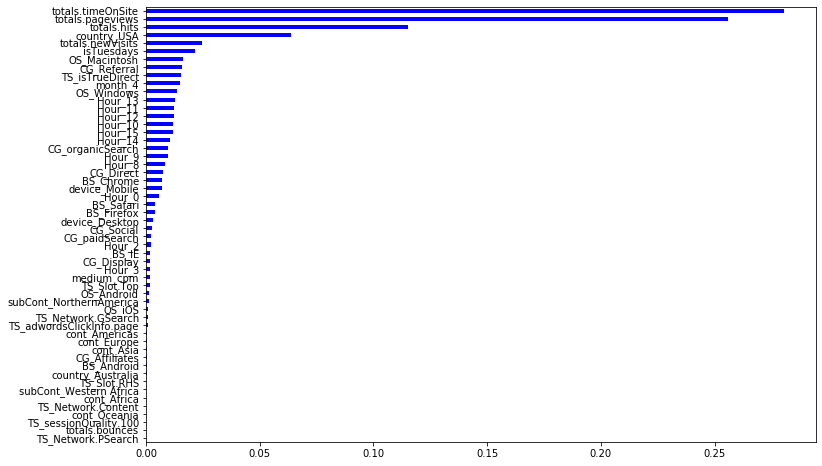

In [28]:
# Create a pd.Series of features importances
importances_tree = pd.Series(tree.feature_importances_,
index = X_train.columns)

# Sort importances_rf
sorted_importances_tree = importances_tree.sort_values()

# Make a horizontal bar plot
plt.figure(figsize=(12, 8))  
sorted_importances_tree.plot(kind='barh', color='blue')
plt.show()

**LightGBM**

In [7]:
from lightgbm import LGBMRegressor
lgb = LGBMRegressor(random_state=0)
regressors = [('LightGBM', lgb)]


In [8]:
for clf_name, clf in regressors:
    clf.fit(X_train, y_train.ravel())
    predictions = clf.predict(X_test)
    y_pred_train = clf.predict(X_train)
    RMSE_train = (MSE(y_train, y_pred_train))**(1/2)
    print('{} Train RMSE: {:.4f}'.format(clf_name, RMSE_train))
    y_pred_test = clf.predict(X_test)
    RMSE_test = (MSE(y_test, y_pred_test))**(1/2)
    print("{} Test RMSE: {:.4f}".format(clf_name, RMSE_test))

LightGBM Train RMSE: 1.4882
LightGBM Test RMSE: 1.5458


In [9]:
# cross validation
for clf_name, clf in regressors:
    MSE_CV_scores = - cross_val_score(clf, X_train, y_train, cv=5, scoring='neg_mean_squared_error', n_jobs=-1) 
    RMSE_CV = (MSE_CV_scores.mean())**(1/2)
    print('{} CV RMSE: {:.4f}'.format(clf_name, RMSE_CV))

LightGBM CV RMSE: 1.5495


**RMSE after aggregating into user level**

In [10]:
y_pred_train[y_pred_train<0]=0

In [11]:
revenue_per_user=pd.DataFrame({'user_id': train_id, 'revenue_pred': np.expm1(y_pred_train), 'revenue_actual': np.expm1(y_train)})
revenue_per_user=revenue_per_user.groupby(['user_id']).agg({'revenue_pred':'sum','revenue_actual':'sum'}).reset_index()
revenue_per_user['log_sum_pred']=np.log1p(revenue_per_user['revenue_pred'])
revenue_per_user['log_sum_actual']=np.log1p(revenue_per_user['revenue_actual'])
revenue_per_user=revenue_per_user.drop(['revenue_pred','revenue_actual'],axis=1)

In [12]:
# Evaluate the training set RMSE of dt
RMSE_train = (MSE(revenue_per_user['log_sum_pred'], revenue_per_user['log_sum_actual']))**(1/2)

# Print RMSE_train
print('Train RMSE: {}'.format(RMSE_train))

Train RMSE: 1.5057214695494932


In [13]:
predictions[predictions<0]=0

In [14]:
revenue_per_user_test=pd.DataFrame({'user_id': test_id, 'revenue_pred': np.expm1(predictions), 'revenue_actual': np.expm1(y_test)})
revenue_per_user_test=revenue_per_user_test.groupby(['user_id']).agg({'revenue_pred':'sum','revenue_actual':'sum'}).reset_index()
revenue_per_user_test['log_sum_pred']=np.log1p(revenue_per_user_test['revenue_pred'])
revenue_per_user_test['log_sum_actual']=np.log1p(revenue_per_user_test['revenue_actual'])
revenue_per_user_test=revenue_per_user_test.drop(['revenue_pred','revenue_actual'],axis=1)

In [16]:
rmse_dt = (MSE(revenue_per_user_test['log_sum_pred'], revenue_per_user_test['log_sum_actual']))**(1/2)

# Print rmse_dt
print("Test set RMSE of dt: {}".format(rmse_dt))

Test set RMSE of dt: 1.5524948749407559


In [17]:
###Cross validation for aggregate results
from sklearn.model_selection import cross_val_predict
# Compute the array containing the 10-folds CV MSEs


cross_val_pred = cross_val_predict(lgb, X_train, y_train, cv=10, 
                                  groups = train_id, 
                                  n_jobs=-1) 

# Compute the 10-folds CV RMSE
#RMSE_CV = (MSE_CV_scores.mean())**(1/2)

# Print RMSE_CV
#print('CV RMSE: {}'.format(RMSE_CV))


cross_val_pred[cross_val_pred<0] = 0


revenue_per_user=pd.DataFrame({'user_id': train_id, 'revenue_pred': np.expm1(cross_val_pred),
                               'revenue_actual': np.expm1(y_train)})
revenue_per_user=revenue_per_user.groupby(['user_id']).agg({'revenue_pred':'sum',
                                                            'revenue_actual':'sum'}).reset_index()
revenue_per_user['log_sum_pred']=np.log1p(revenue_per_user['revenue_pred'])
revenue_per_user['log_sum_actual']=np.log1p(revenue_per_user['revenue_actual'])
revenue_per_user=revenue_per_user.drop(['revenue_pred','revenue_actual'],axis=1)


################NEW BOX#################################################

###TESTING NEW WAY 
# Evaluate the training set RMSE of dt
RMSE_train = (MSE(revenue_per_user['log_sum_pred'], revenue_per_user['log_sum_actual']))**(1/2)

# Print RMSE_train
print('CV RMSE: {}'.format(RMSE_train))

CV RMSE: 1.5603122615555773


### Modeling on user Level

In [135]:
# load required library
%matplotlib inline
import pandas as pd
import numpy as np
import math
import datetime
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.model_selection import train_test_split

# Importing Classifier Modules
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor

# cross validation
import sklearn
from sklearn.metrics import mean_squared_error as MSE
from sklearn.model_selection import cross_validate
from sklearn.model_selection import GridSearchCV
from sklearn.model_selection import cross_val_score

import warnings
warnings.filterwarnings("ignore")

In [136]:
# Load data
df = pd.read_pickle('customer_dataset.pkl')

In [137]:
df.head()

,id,logRevenue,totals.hits_sum,totals.hits_mean,totals.pageviews_sum,totals.pageviews_mean,totals.bounces_sum,totals.bounces_mean,totals.newVisits_sum,totals.newVisits_mean,TS_adwordsClickInfo.page_max,BS_Firefox_max,BS_Chrome_max,BS_Safari_max,BS_IE_max,BS_Android_max,OS_Windows_max,OS_Macintosh_max,OS_Android_max,OS_iOS_max,subCont_NorthernAmerica_max,subCont_Western Africa_max,country_USA_max,country_Australia_max,medium_cpm_max,CG_Affiliates_max,CG_Direct_max,CG_Display_max,CG_organicSearch_max,CG_paidSearch_max,CG_Referral_max,CG_Social_max,device_Mobile_max,device_Desktop_max,cont_Africa_max,cont_Americas_max,cont_Asia_max,cont_Europe_max,cont_Oceania_max,TS_isTrueDirect_max,TS_sessionQuality.100_max,TS_Slot.RHS_max,TS_Slot.Top_max,TS_Network.Content_max,TS_Network.GSearch_max,TS_Network.PSearch_max
0,0000000259678714014,0.0,19,9.5,13.0,6.5,0.0,0.0,1.0,0.500000,0,0,1,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0
1,0000027376579751715,0.0,6,6.0,5.0,5.0,0.0,0.0,1.0,1.000000,0,0,1,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,1,0,0,0,0,1,0,1,0,0,0,1,0,0,0,0,0,0
2,0000039460501403861,0.0,2,2.0,2.0,2.0,0.0,0.0,1.0,1.000000,0,0,1,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,1,0,0,0,1,0,0,0,0,0,0
3,0000040862739425590,0.0,5,2.5,5.0,2.5,0.0,0.0,1.0,0.500000,1,0,1,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,1,0,0,1,0,1,0
4,0000049363351866189,0.0,3,1.0,3.0,1.0,3.0,1.0,1.0,0.333333,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0


In [138]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 716705 entries, 0 to 716704
Data columns (total 46 columns):
id                              716705 non-null object
logRevenue                      716705 non-null float64
totals.hits_sum                 716705 non-null int32
totals.hits_mean                716705 non-null float64
totals.pageviews_sum            716705 non-null float64
totals.pageviews_mean           716705 non-null float64
totals.bounces_sum              716705 non-null float64
totals.bounces_mean             716705 non-null float64
totals.newVisits_sum            716705 non-null float64
totals.newVisits_mean           716705 non-null float64
TS_adwordsClickInfo.page_max    716705 non-null int32
BS_Firefox_max                  716705 non-null int64
BS_Chrome_max                   716705 non-null int64
BS_Safari_max                   716705 non-null int64
BS_IE_max                       716705 non-null int64
BS_Android_max                  716705 non-null int64
OS_Windo

In [139]:
X = df.drop(['id','logRevenue'], axis=1).values
y = df['logRevenue'].values

# Split data into 75% train and 25% test
X_train,X_test,y_train,y_test=train_test_split(X, y, test_size=0.25, random_state=0)

In [140]:
lr = LinearRegression()
dt = DecisionTreeRegressor()
gb = GradientBoostingRegressor()
kn = KNeighborsRegressor()
rf = RandomForestRegressor()

In [141]:
regressors = [('Linear Regression', lr),
              ('Decision Tree Regressor', dt),
              ('Gradient Boosting Regressor', gb),
              ('KNeighbors Regressor', kn),
              ('Random Forest Regressor', rf)
             ]

In [142]:
for clf_name, clf in regressors:
    clf.fit(X_train, y_train.ravel())
    predicted = clf.predict(X_test)
    y_pred_train = clf.predict(X_train)
    RMSE_train = (MSE(y_train, y_pred_train))**(1/2)
    print('{} Train RMSE: {:.4f}'.format(clf_name, RMSE_train))
    y_pred_test = clf.predict(X_test)
    RMSE_test = (MSE(y_test, y_pred_test))**(1/2)
    print("{} Test RMSE: {:.4f}".format(clf_name, RMSE_test))

Linear Regression Train RMSE: 1.8077
Linear Regression Test RMSE: 1.7569
Decision Tree Regressor Train RMSE: 0.7377
Decision Tree Regressor Test RMSE: 2.1295
Gradient Boosting Regressor Train RMSE: 1.5847
Gradient Boosting Regressor Test RMSE: 1.5628
KNeighbors Regressor Train RMSE: 1.4677
KNeighbors Regressor Test RMSE: 1.7442
Random Forest Regressor Train RMSE: 0.9637
Random Forest Regressor Test RMSE: 1.7239


In [11]:
# cross validation
for clf_name, clf in regressors:
    MSE_CV_scores = - cross_val_score(clf, X_train, y_train, cv=5, scoring='neg_mean_squared_error', n_jobs=-1) 
    RMSE_CV = (MSE_CV_scores.mean())**(1/2)
    print('{} CV RMSE: {:.4f}'.format(clf_name, RMSE_CV))

Linear Regression CV RMSE: 1.8864
Decision Tree Regressor CV RMSE: 2.2538
Gradient Boosting Regressor CV RMSE: 1.5951
KNeighbors Regressor CV RMSE: 1.8651
Random Forest Regressor CV RMSE: 1.7060


### Light GBM

In [27]:
from lightgbm import LGBMRegressor

In [33]:
lgb = LGBMRegressor(random_state=0)

In [34]:
regressors = [('LightGBM', lgb)]

In [35]:
for clf_name, clf in regressors:
    clf.fit(X_train, y_train.ravel())
    predicted = clf.predict(X_test)
    y_pred_train = clf.predict(X_train)
    RMSE_train = (MSE(y_train, y_pred_train))**(1/2)
    print('{} Train RMSE: {:.4f}'.format(clf_name, RMSE_train))
    y_pred_test = clf.predict(X_test)
    RMSE_test = (MSE(y_test, y_pred_test))**(1/2)
    print("{} Test RMSE: {:.4f}".format(clf_name, RMSE_test))

LightGBM Train RMSE: 1.4835
LightGBM Test RMSE: 1.5320


In [36]:
# cross validation
for clf_name, clf in regressors:
    MSE_CV_scores = - cross_val_score(clf, X_train, y_train, cv=5, scoring='neg_mean_squared_error', n_jobs=-1) 
    RMSE_CV = (MSE_CV_scores.mean())**(1/2)
    print('{} CV RMSE: {:.4f}'.format(clf_name, RMSE_CV))

LightGBM CV RMSE: 1.5735


In [37]:
# Tune Paramaters with lightgbm

# Create parameters to search
gridParams = {
    'learning_rate': [0.01, 0.05, 0.1, 0.2], # default 0.1
    'n_estimators': [40, 100, 150], # default 100
    'num_leaves': [21,31,41], # default 31
    'random_state': [0], # Updated from 'seed'
    'max_depth': [-1, 20],
    }

In [39]:
lgb_grid = LGBMRegressor(boosting_type= 'gbdt',
          objective = 'regression',
          n_jobs = 3, # Updated from 'nthread'
          max_depth = 1000)

# Create the grid
grid = GridSearchCV(lgb_grid, gridParams, cv=5)
grid.fit(X_train, y_train)

GridSearchCV(cv=5, error_score='raise-deprecating',
       estimator=LGBMRegressor(boosting_type='gbdt', class_weight=None, colsample_bytree=1.0,
       importance_type='split', learning_rate=0.1, max_depth=1000,
       min_child_samples=20, min_child_weight=0.001, min_split_gain=0.0,
       n_estimators=100, n_jobs=3, num_leaves=31, objective='regression',
       random_state=None, reg_alpha=0.0, reg_lambda=0.0, silent=True,
       subsample=1.0, subsample_for_bin=200000, subsample_freq=0),
       fit_params=None, iid='warn', n_jobs=None,
       param_grid={'learning_rate': [0.01, 0.05, 0.1, 0.2], 'n_estimators': [40, 100, 150], 'num_leaves': [21, 31, 41], 'random_state': [0], 'max_depth': [-1, 20]},
       pre_dispatch='2*n_jobs', refit=True, return_train_score='warn',
       scoring=None, verbose=0)

In [40]:
print('Best parameters found by grid search are:', grid.best_params_)

Best parameters found by grid search are: {'learning_rate': 0.05, 'max_depth': -1, 'n_estimators': 150, 'num_leaves': 31, 'random_state': 0}


In [41]:
y_pred_train = grid.predict(X_train)
RMSE_train = (MSE(y_train, y_pred_train))**(1/2)
print('LightGBM Tuned Train RMSE: {:.4f}'.format(RMSE_train))
y_pred_test = grid.predict(X_test)
RMSE_test = (MSE(y_test, y_pred_test))**(1/2)
print("LightGBM Tuned RMSE: {:.4f}".format(RMSE_test))

LightGBM Tuned Train RMSE: 1.4992
LightGBM Tuned RMSE: 1.5286


In [43]:
# Tuned Set cross validation
lgbm_tuned = LGBMRegressor(learning_rate= 0.05, max_depth= -1, n_estimators=150, num_leaves= 31, random_state=0)
regressors = [('LightGBM Tuned', lgbm_tuned)]
for clf_name, clf in regressors:
    MSE_CV_scores = - cross_val_score(clf, X_train, y_train, cv=5, scoring='neg_mean_squared_error', n_jobs=-1) 
    RMSE_CV = (MSE_CV_scores.mean())**(1/2)
    print('{} CV RMSE: {:.4f}'.format(clf_name, RMSE_CV))

LightGBM Tuned CV RMSE: 1.5705


### Ridge Regression Model

In [64]:
ridge = RidgeCV(cv=10)

# fit or train the linear regression model on the training set and store␣
ridge.fit(X_train, y_train)
# show the alpha parameter used in final ridgeCV model ridge.alpha_
ridge.alpha_

#
train_pred = ridge.predict(X_train)
ridge_test_pred = ridge.predict(X_test)

In [65]:
#print RMSE of training predictions 
print('RMSE on train for regression: ', np.sqrt(MSE(y_train, train_pred)))
print('RMSE on test for regression: ', np.sqrt(MSE(y_test,ridge_test_pred)))

RMSE on train for regression:  1.8034646533154102
RMSE on test for regression:  1.7532182935174567


In [80]:
# Compute the array containing the 10-folds CV MSEs
MSE_CV_scores = - cross_val_score(ridge, X_train, y_train, cv=10, 
                                  scoring='neg_mean_squared_error', 
                                  n_jobs=-1) 

# Compute the 10-folds CV RMSE
RMSE_CV = (MSE_CV_scores.mean())**(1/2)

# Print RMSE_CV
print('CV RMSE: {}'.format(RMSE_CV))


CV RMSE: 1.8832573754617306


### Gradient Model

In [105]:
from sklearn.ensemble import GradientBoostingRegressor
from sklearn import ensemble
# Fit regression model
params = {'n_estimators': 500, 'max_depth': 4, 'min_samples_split': 2,
          'learning_rate': 0.01, 'loss': 'ls'}
gradient = ensemble.GradientBoostingRegressor(**params)

gradient.fit(X_train, y_train)

GradientBoostingRegressor(alpha=0.9, criterion='friedman_mse', init=None,
             learning_rate=0.01, loss='ls', max_depth=4, max_features=None,
             max_leaf_nodes=None, min_impurity_decrease=0.0,
             min_impurity_split=None, min_samples_leaf=1,
             min_samples_split=2, min_weight_fraction_leaf=0.0,
             n_estimators=500, n_iter_no_change=None, presort='auto',
             random_state=None, subsample=1.0, tol=0.0001,
             validation_fraction=0.1, verbose=0, warm_start=False)

In [114]:
# Predict the test set labels 'y_pred' 
y_pred = gradient.predict(X_test) 
y_pred_train=gradient.predict(X_train) 

# Evaluate the test set RMSE 
rmse_test = MSE(y_test, y_pred)**(1/2) 
rmse_train = MSE(y_train, y_pred_train)**(1/2) 

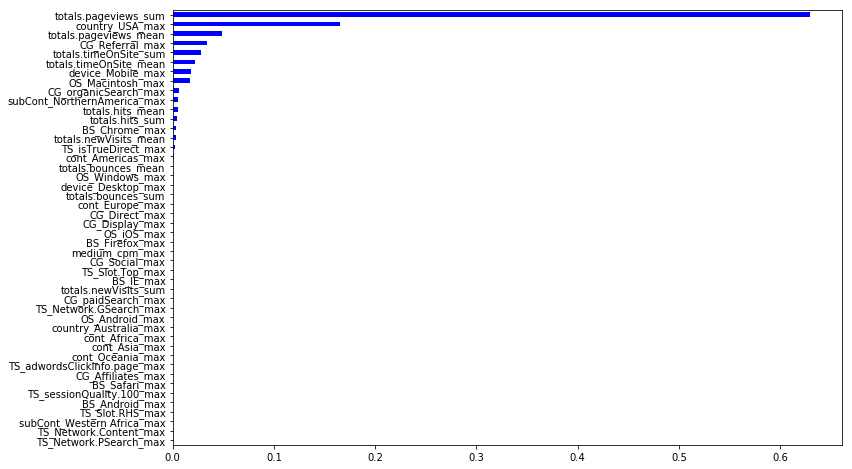

In [120]:
# Create a pd.Series of features importances
importances_grad = pd.Series(gradient.feature_importances_,
index = X_train.columns)

# Sort importances_rf
sorted_importances_grad = importances_grad.sort_values()

# Make a horizontal bar plot
plt.figure(figsize=(12, 8))  
sorted_importances_grad.plot(kind='barh', color='blue')
plt.show()

In [116]:
# Print the test set RMSE 
print('Train set RMSE for gradient on train data: {:.3f}'.format(rmse_train))
print('Test set RMSE for gradient on test data: {:.3f}'.format(rmse_test)) 

Train set RMSE for gradient on train data: 1.569
Test set RMSE for gradient on test data: 1.549


In [121]:
# Compute the array containing the 10-folds CV MSEs
MSE_CV_scores = - cross_val_score(gradient, X_train, y_train, cv=10, 
                                  scoring='neg_mean_squared_error', 
                                  n_jobs=-1) 

# Compute the 10-folds CV RMSE
RMSE_CV = (MSE_CV_scores.mean())**(1/2)

# Print RMSE_CV
print('CV RMSE: {}'.format(RMSE_CV))


CV RMSE: 1.5890321737147615


### XGBoost Model

In [85]:
# xgb models only accept 'DMatrix' input; convert the data here 
dtrain = xgb.DMatrix(X_train, label=y_train) 
dtest = xgb.DMatrix(X_test, label=y_test)
# parameter grid for xgb model 
param_dict = { 'max_depth':6, 'min_child_weight': 1, 
              'eta':.1, 'subsample': 1, 
              'colsample_bytree': 1, # Other parameters 'objective':'reg:linear', 'eval_metric':'rmse'
}
# train XGB model on split training data using split test data 
num_boost_round=999 
model_xgb = xgb.train( param_dict, dtrain, 
                  num_boost_round=num_boost_round, 
                  evals=[(dtest, "Test")], 
                  early_stopping_rounds=10)

[0]	Test-rmse:1.92166
Will train until Test-rmse hasn't improved in 10 rounds.
[1]	Test-rmse:1.85834
[2]	Test-rmse:1.80575
[3]	Test-rmse:1.76179
[4]	Test-rmse:1.72542
[5]	Test-rmse:1.69406
[6]	Test-rmse:1.66826
[7]	Test-rmse:1.64707
[8]	Test-rmse:1.62902
[9]	Test-rmse:1.61358
[10]	Test-rmse:1.60124
[11]	Test-rmse:1.59105
[12]	Test-rmse:1.58294
[13]	Test-rmse:1.57588
[14]	Test-rmse:1.56972
[15]	Test-rmse:1.56492
[16]	Test-rmse:1.56075
[17]	Test-rmse:1.55755
[18]	Test-rmse:1.55472
[19]	Test-rmse:1.55265
[20]	Test-rmse:1.55028
[21]	Test-rmse:1.54817
[22]	Test-rmse:1.54683
[23]	Test-rmse:1.54537
[24]	Test-rmse:1.54411
[25]	Test-rmse:1.54286
[26]	Test-rmse:1.54213
[27]	Test-rmse:1.54121
[28]	Test-rmse:1.54032
[29]	Test-rmse:1.53972
[30]	Test-rmse:1.53915
[31]	Test-rmse:1.53881
[32]	Test-rmse:1.53816
[33]	Test-rmse:1.53786
[34]	Test-rmse:1.53794
[35]	Test-rmse:1.53766
[36]	Test-rmse:1.53742
[37]	Test-rmse:1.53693
[38]	Test-rmse:1.53698
[39]	Test-rmse:1.53666
[40]	Test-rmse:1.53636
[41]	Test-

In [92]:
dpred=xgb.DMatrix(X_train)

# predict RMSE of model on training data 
print("RMSE of XGB model on train data: ", np.sqrt(MSE(model_xgb.predict(dpred), y_train)))
# predict RMSE of model on test data 
model_xgb_test_pred = model_xgb.predict(xgb.DMatrix(X_test)) 
print("RMSE of XGB model on test data: ", np.sqrt(MSE(model_xgb_test_pred, y_test)))

RMSE of XGB model on train data:  1.495640233002153
RMSE of XGB model on test data:  1.534322659461396


<Figure size 1440x1440 with 0 Axes>

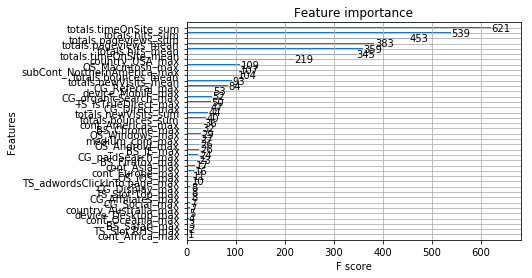

In [88]:
plt.figure(figsize=(20, 20))  
plt.show(plot_importance(model_xgb))

## Customer Segmentation and LTV Prediction

In this section, we try to do customer segmentation with RFM (Recency, Frequency and Monetary Value) scores. Since we have the data for the whole year of 2017, we seperate it into two sets: January-September and Octobor-December. Then we will do customer segmentation for the first 9 months and predict the customer life time value (LTV) for the last 3 months.

**Customer Segmentation (First 9 Months)** <br>
We calculate the recency (how many days past since the last transaction), frequency (how many transactions within 9 months) and log revenue for all transactions. Then we do clustering for these 3 features so that we have 3 clustering features. We re-order the cluster order the make the biggest cluster number represents the best results. Thus, we calculate the overall score by summing up these 3 scores. Then we segment the customer into 4 groups according to the overall scores.

**LTV Prediction (Last 3 Months)**  <br>
First, we use the log revenue of the last 3 months to do a LTV clustering. Then we use the 9-month features to predict the 3-month LTV.

In [1]:
from __future__ import division
from datetime import datetime, timedelta,date
import pandas as pd
%matplotlib inline
from sklearn.metrics import classification_report,confusion_matrix
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
from sklearn.cluster import KMeans

import chart_studio.plotly as py
import plotly.offline as pyoff
import plotly.graph_objs as go

import xgboost as xgb
from sklearn.model_selection import KFold, cross_val_score, train_test_split

import warnings
warnings.filterwarnings("ignore")

In [2]:
pyoff.init_notebook_mode()

In [3]:
# load data
df = pd.read_pickle('2017_clean.pkl')
train = df.copy()

In [4]:
# keep related information and change data type
train = train[['fullVisitorId', 'date', 'totals.totalTransactionRevenue']]
train["date"] = pd.to_datetime(train["date"], format="%Y%m%d") # seting the column as pandas datetime
train['totals.totalTransactionRevenue']=train['totals.totalTransactionRevenue'].astype('float')

In [5]:
train.head()

,fullVisitorId,date,totals.totalTransactionRevenue
0,3162355547410993243,2017-10-16,NaN
1,8934116514970143966,2017-10-16,NaN
2,7992466427990357681,2017-10-16,NaN
3,9075655783635761930,2017-10-16,NaN
4,6960673291025684308,2017-10-16,NaN


In [6]:
train['date'].describe()

count                  928860
unique                    365
top       2017-12-12 00:00:00
freq                     9234
first     2017-01-01 00:00:00
last      2017-12-31 00:00:00
Name: date, dtype: object

In [7]:
# select data from Jan to Sept
train_9 = train[(train.date < date(2017,10,1)) & (train.date >= date(2017,1,1))].reset_index(drop=True)
# select data from Oct to Dec
train_12 = train[(train.date >= date(2017,10,1)) & (train.date <= date(2017,12,31))].reset_index(drop=True)

In [8]:
train_9['date'].describe()

count                  636781
unique                    273
top       2017-09-20 00:00:00
freq                     4880
first     2017-01-01 00:00:00
last      2017-09-30 00:00:00
Name: date, dtype: object

In [9]:
train_12['date'].describe()

count                  292079
unique                     92
top       2017-12-12 00:00:00
freq                     9234
first     2017-10-01 00:00:00
last      2017-12-31 00:00:00
Name: date, dtype: object

In [10]:
customer = pd.DataFrame(train['fullVisitorId'].unique())
customer.columns = ['fullVisitorId']

### Recency

In [11]:
max_purchase = train_9.groupby('fullVisitorId').date.max().reset_index()

In [12]:
max_purchase.columns = ['fullVisitorId','MaxPurchaseDate']

In [13]:
max_purchase['Recency'] = (max_purchase['MaxPurchaseDate'].max() - max_purchase['MaxPurchaseDate']).dt.days

In [14]:
user_recency = pd.merge(customer, max_purchase[['fullVisitorId','Recency']], on='fullVisitorId')

In [15]:
user_recency.head()

,fullVisitorId,Recency
0,8934116514970143966,4
1,6135613929977117121,1
2,9630953897602496525,19
3,8461088577726398196,14
4,8574773000077178719,136


In [16]:
user_recency.Recency.describe()

count    495989.000000
mean        127.851523
std          80.999227
min           0.000000
25%          54.000000
50%         126.000000
75%         198.000000
max         272.000000
Name: Recency, dtype: float64

In [17]:
plot_data = [
    go.Histogram(
        x=user_recency['Recency']
    )
]

plot_layout = go.Layout(
        title='Recency'
    )
fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

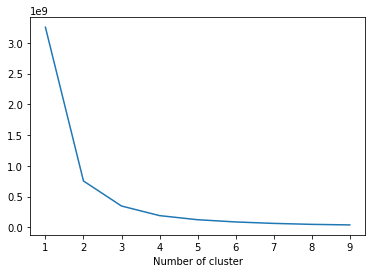

In [18]:
# Elbow Method
sse={}
recency = user_recency[['Recency']]
for k in range(1, 10):
    kmeans = KMeans(n_clusters=k, max_iter=1000).fit(recency)
    recency["clusters"] = kmeans.labels_
    sse[k] = kmeans.inertia_ 
plt.figure()
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of cluster")
plt.show()

In [19]:
# let's try 4 first
kmeans = KMeans(n_clusters=4)
kmeans.fit(user_recency[['Recency']])
user_recency['RecencyCluster'] = kmeans.predict(user_recency[['Recency']])

In [20]:
user_recency.groupby('RecencyCluster')['Recency'].describe()

,count,mean,std,min,25%,50%,75%,max
RecencyCluster,,,,,,,,
0,122078.0,167.864210,20.326261,132.0,151.0,169.0,185.0,202.0
1,116446.0,95.801110,19.772158,63.0,79.0,94.0,113.0,131.0
2,116766.0,236.708854,19.870417,203.0,220.0,236.0,253.0,272.0
3,140699.0,29.319469,18.341870,0.0,12.0,29.0,45.0,62.0


In [21]:
def order_cluster(cluster_field_name, target_field_name,df,ascending):
    new_cluster_field_name = 'new_' + cluster_field_name
    df_new = df.groupby(cluster_field_name)[target_field_name].mean().reset_index()
    df_new = df_new.sort_values(by=target_field_name,ascending=ascending).reset_index(drop=True)
    df_new['index'] = df_new.index
    df_final = pd.merge(df,df_new[[cluster_field_name,'index']], on=cluster_field_name)
    df_final = df_final.drop([cluster_field_name],axis=1)
    df_final = df_final.rename(columns={"index":cluster_field_name})
    return df_final

In [22]:
# call the funtion above to order cluster
user_recency = order_cluster('RecencyCluster', 'Recency', user_recency,False)

In [23]:
user_recency.groupby('RecencyCluster')['Recency'].describe()

,count,mean,std,min,25%,50%,75%,max
RecencyCluster,,,,,,,,
0,116766.0,236.708854,19.870417,203.0,220.0,236.0,253.0,272.0
1,122078.0,167.864210,20.326261,132.0,151.0,169.0,185.0,202.0
2,116446.0,95.801110,19.772158,63.0,79.0,94.0,113.0,131.0
3,140699.0,29.319469,18.341870,0.0,12.0,29.0,45.0,62.0


In [24]:
user_recency.groupby('RecencyCluster')['Recency'].agg(['count','mean']).reset_index()

,RecencyCluster,count,mean
0,0,116766,236.708854
1,1,122078,167.864210
2,2,116446,95.801110
3,3,140699,29.319469


Text(0.5, 1.0, 'Recency_Cluster')

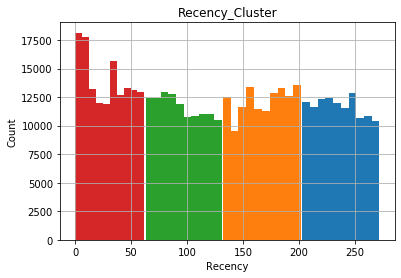

In [25]:
user_recency.groupby('RecencyCluster')['Recency'].hist()
plt.xlabel('Recency')
plt.ylabel('Count')
plt.title('Recency_Cluster')

### Frequency

In [26]:
user_frequency = train_9.groupby('fullVisitorId').date.count().reset_index()

In [27]:
user_frequency.columns = ['fullVisitorId','Frequency']

In [28]:
user_frequency.head()

,fullVisitorId,Frequency
0,0000027376579751715,1
1,0000039460501403861,1
2,0000040862739425590,2
3,0000049363351866189,3
4,0000062267706107999,1


In [29]:
user = pd.merge(user_recency, user_frequency, on='fullVisitorId')

In [30]:
user.head()

,fullVisitorId,Recency,RecencyCluster,Frequency
0,8934116514970143966,4,3,3
1,6135613929977117121,1,3,6
2,9630953897602496525,19,3,1
3,8461088577726398196,14,3,3
4,7122741899604173060,2,3,2


In [31]:
user.Frequency.describe()

count    495989.000000
mean          1.283861
std           1.337847
min           1.000000
25%           1.000000
50%           1.000000
75%           1.000000
max         195.000000
Name: Frequency, dtype: float64

In [32]:
plot_data = [
    go.Histogram(
        x=user['Frequency']
    )
]

plot_layout = go.Layout(
        title='Frequency'
    )
fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

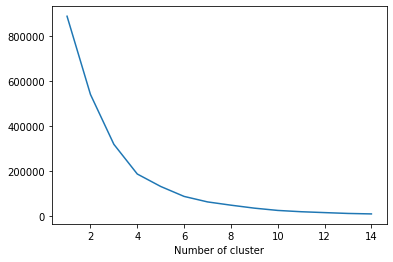

In [33]:
# Elbow Method
sse={}
frequency = user[['Frequency']]
for k in range(1, 15):
    kmeans = KMeans(n_clusters=k, max_iter=1000).fit(frequency)
    frequency["clusters"] = kmeans.labels_
    sse[k] = kmeans.inertia_ 
plt.figure()
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of cluster")
plt.show()

In [34]:
kmeans = KMeans(n_clusters=4)
kmeans.fit(user[['Frequency']])
user['FrequencyCluster'] = kmeans.predict(user[['Frequency']])

In [35]:
user = order_cluster('FrequencyCluster', 'Frequency',user,True)

In [36]:
user.groupby('FrequencyCluster')['Frequency'].describe()

,count,mean,std,min,25%,50%,75%,max
FrequencyCluster,,,,,,,,
0,470010.0,1.097385,0.296482,1.0,1.00,1.0,1.00,2.0
1,24239.0,3.903379,1.269582,3.0,3.00,3.0,4.00,8.0
2,1706.0,13.691676,6.131206,9.0,10.00,12.0,15.00,51.0
3,34.0,89.029412,33.107250,54.0,64.25,81.5,101.25,195.0


In [37]:
user.groupby('FrequencyCluster')['Frequency'].agg(['count','mean']).reset_index()

,FrequencyCluster,count,mean
0,0,470010,1.097385
1,1,24239,3.903379
2,2,1706,13.691676
3,3,34,89.029412


### Monetary Value

In [38]:
revenue = train_9.groupby('fullVisitorId')['totals.totalTransactionRevenue'].sum().reset_index()

In [39]:
revenue.columns = ['fullVisitorId', 'Revenue']
revenue['logRevenue'] = np.log(1+revenue['Revenue'])
revenue = revenue.drop(['Revenue'], axis=1)
revenue.head()

,fullVisitorId,logRevenue
0,0000027376579751715,0.0
1,0000039460501403861,0.0
2,0000040862739425590,0.0
3,0000049363351866189,0.0
4,0000062267706107999,0.0


In [40]:
user = pd.merge(user, revenue, on='fullVisitorId')
user.head()

,fullVisitorId,Recency,RecencyCluster,Frequency,FrequencyCluster,logRevenue
0,8934116514970143966,4,3,3,1,16.612182
1,6135613929977117121,1,3,6,1,0.000000
2,8461088577726398196,14,3,3,1,0.000000
3,9056866253625889952,2,3,8,1,0.000000
4,1858833000939214139,1,3,4,1,0.000000


In [41]:
user.logRevenue.describe()

count    495989.000000
mean          0.264691
std           2.167142
min           0.000000
25%           0.000000
50%           0.000000
75%           0.000000
max          25.966048
Name: logRevenue, dtype: float64

In [42]:
# the elbow method show 2
kmeans = KMeans(n_clusters=2)
kmeans.fit(user[['logRevenue']])
user['logRevenueCluster'] = kmeans.predict(user[['logRevenue']])

In [43]:
user = order_cluster('logRevenueCluster', 'logRevenue',user,True)

In [44]:
user.groupby('logRevenueCluster')['logRevenue'].describe()

,count,mean,std,min,25%,50%,75%,max
logRevenueCluster,,,,,,,,
0,488670.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,7319.0,17.937419,1.125177,14.731802,17.147358,17.746355,18.515718,25.966048


In [45]:
user.groupby('logRevenueCluster')['logRevenue'].agg(['count','mean']).reset_index()

,logRevenueCluster,count,mean
0,0,488670,0.000000
1,1,7319,17.937419


### Overall Segmentation

In [46]:
user.head()

,fullVisitorId,Recency,RecencyCluster,Frequency,FrequencyCluster,logRevenue,logRevenueCluster
0,8934116514970143966,4,3,3,1,16.612182,1
1,0012276352424581690,16,3,5,1,17.804124,1
2,9179364299608933418,8,3,3,1,19.412153,1
3,3700714855829972615,5,3,8,1,19.586889,1
4,5334896187622326438,6,3,4,1,17.281246,1


In [47]:
user['OverallScore'] = user['RecencyCluster'] + user['FrequencyCluster'] + user['logRevenueCluster']

In [48]:
user.groupby('OverallScore')['Recency','Frequency','logRevenue'].mean().reset_index()

,OverallScore,Recency,Frequency,logRevenue
0,0,236.827423,1.082989,0.000000
1,1,170.675339,1.182395,0.120642
2,2,100.204518,1.248871,0.242966
3,3,33.487005,1.251690,0.225502
4,4,36.282251,4.028941,3.667626
5,5,34.091191,8.859801,12.023915
6,6,26.031963,21.538813,17.207364
7,7,14.000000,130.200000,19.778151


Looks like overall score 7 is the highest value customer.

In [49]:
user['Segment'] = 'Low-Value'
user.loc[user['OverallScore']>0,'Segment'] = 'Mid1-Value' 
user.loc[user['OverallScore']>3,'Segment'] = 'Mid2-Value' 
user.loc[user['OverallScore']>5,'Segment'] = 'High-Value' 

In [50]:
sg = user.groupby('Segment')['logRevenue'].agg(['count','mean']).sort_values(by=['mean']).reset_index()
sg.columns = ['Segment','count','mean_logRevenue_9']
sg

,Segment,count,mean_logRevenue_9
0,Low-Value,111388,0.000000
1,Mid1-Value,373401,0.197349
2,Mid2-Value,10976,4.894880
3,High-Value,224,17.264748


In [51]:
user_sample = user.sample(20000)

In [52]:
tx_graph = user_sample

plot_data = [
    go.Scatter(
        x=tx_graph.query("Segment == 'Low-Value'")['Recency'],
        y=tx_graph.query("Segment == 'Low-Value'")['Frequency'],
        mode='markers',
        name='Low',
        marker= dict(size= 7,
            line= dict(width=1),
            color= 'blue',
            opacity= 0.8
           )
    ),
        go.Scatter(
        x=tx_graph.query("Segment == 'Mid1-Value'")['Recency'],
        y=tx_graph.query("Segment == 'Mid1-Value'")['Frequency'],
        mode='markers',
        name='Mid1',
        marker= dict(size= 9,
            line= dict(width=1),
            color= 'green',
            opacity= 0.5
           )
    ),
            go.Scatter(
        x=tx_graph.query("Segment == 'Mid2-Value'")['Recency'],
        y=tx_graph.query("Segment == 'Mid2-Value'")['Frequency'],
        mode='markers',
        name='Mid2',
        marker= dict(size= 9,
            line= dict(width=1),
            color= 'orange',
            opacity= 0.5
           )
    ),
        go.Scatter(
        x=tx_graph.query("Segment == 'High-Value'")['Recency'],
        y=tx_graph.query("Segment == 'High-Value'")['Frequency'],
        mode='markers',
        name='High',
        marker= dict(size= 11,
            line= dict(width=1),
            color= 'red',
            opacity= 0.9
           )
    ),
]

plot_layout = go.Layout(
        yaxis= {'title': "Frequency"},
        xaxis= {'title': "Recency"},
        title='Segments'
    )
fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

In [53]:
tx_graph = user_sample

plot_data = [
    go.Scatter(
        x=tx_graph.query("Segment == 'Low-Value'")['Recency'],
        y=tx_graph.query("Segment == 'Low-Value'")['logRevenue'],
        mode='markers',
        name='Low',
        marker= dict(size= 7,
            line= dict(width=1),
            color= 'blue',
            opacity= 0.8
           )
    ),
        go.Scatter(
        x=tx_graph.query("Segment == 'Mid1-Value'")['Recency'],
        y=tx_graph.query("Segment == 'Mid1-Value'")['logRevenue'],
        mode='markers',
        name='Mid1',
        marker= dict(size= 9,
            line= dict(width=1),
            color= 'green',
            opacity= 0.5
           )
    ),
            go.Scatter(
        x=tx_graph.query("Segment == 'Mid2-Value'")['Recency'],
        y=tx_graph.query("Segment == 'Mid2-Value'")['logRevenue'],
        mode='markers',
        name='Mid2',
        marker= dict(size= 9,
            line= dict(width=1),
            color= 'orange',
            opacity= 0.5
           )
    ),
        go.Scatter(
        x=tx_graph.query("Segment == 'High-Value'")['Recency'],
        y=tx_graph.query("Segment == 'High-Value'")['logRevenue'],
        mode='markers',
        name='High',
        marker= dict(size= 11,
            line= dict(width=1),
            color= 'red',
            opacity= 0.9
           )
    ),
]

plot_layout = go.Layout(
        yaxis= {'title': "logRevenue"},
        xaxis= {'title': "Recency"},
        title='Segments'
    )
fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

In [30]:
tx_graph = user_sample

plot_data = [
    go.Scatter(
        x=tx_graph.query("Segment == 'Low-Value'")['Frequency'],
        y=tx_graph.query("Segment == 'Low-Value'")['logRevenue'],
        mode='markers',
        name='Low',
        marker= dict(size= 7,
            line= dict(width=1),
            color= 'blue',
            opacity= 0.8
           )
    ),
        go.Scatter(
        x=tx_graph.query("Segment == 'Mid1-Value'")['Frequency'],
        y=tx_graph.query("Segment == 'Mid1-Value'")['logRevenue'],
        mode='markers',
        name='Mid1',
        marker= dict(size= 9,
            line= dict(width=1),
            color= 'green',
            opacity= 0.5
           )
    ),
            go.Scatter(
        x=tx_graph.query("Segment == 'Mid2-Value'")['Frequency'],
        y=tx_graph.query("Segment == 'Mid2-Value'")['logRevenue'],
        mode='markers',
        name='Mid2',
        marker= dict(size= 9,
            line= dict(width=1),
            color= 'orange',
            opacity= 0.5
           )
    ),
        go.Scatter(
        x=tx_graph.query("Segment == 'High-Value'")['Frequency'],
        y=tx_graph.query("Segment == 'High-Value'")['logRevenue'],
        mode='markers',
        name='High',
        marker= dict(size= 11,
            line= dict(width=1),
            color= 'red',
            opacity= 0.9
           )
    ),
]

plot_layout = go.Layout(
        yaxis= {'title': "logRevenue"},
        xaxis= {'title': "Frequency"},
        title='Segments'
    )
fig = go.Figure(data=plot_data, layout=plot_layout)
pyoff.iplot(fig)

NameError: name 'user_sample' is not defined

### Life Time Value Prediction

In [55]:
user.head()

,fullVisitorId,Recency,RecencyCluster,Frequency,FrequencyCluster,logRevenue,logRevenueCluster,OverallScore,Segment
0,8934116514970143966,4,3,3,1,16.612182,1,5,Mid2-Value
1,0012276352424581690,16,3,5,1,17.804124,1,5,Mid2-Value
2,9179364299608933418,8,3,3,1,19.412153,1,5,Mid2-Value
3,3700714855829972615,5,3,8,1,19.586889,1,5,Mid2-Value
4,5334896187622326438,6,3,4,1,17.281246,1,5,Mid2-Value


In [56]:
train_12.head()

,fullVisitorId,date,totals.totalTransactionRevenue
0,3162355547410993243,2017-10-16,NaN
1,8934116514970143966,2017-10-16,NaN
2,7992466427990357681,2017-10-16,NaN
3,9075655783635761930,2017-10-16,NaN
4,6960673291025684308,2017-10-16,NaN


In [57]:
revenue_12 = train_12.groupby('fullVisitorId')['totals.totalTransactionRevenue'].sum().reset_index()
revenue_12.columns = ['fullVisitorId','Revenue_12']
revenue_12['logRevenue_12'] = np.log(1+revenue_12['Revenue_12'])
revenue_12 = revenue_12.drop(['Revenue_12'], axis=1)

In [58]:
revenue_12.head()

,fullVisitorId,logRevenue_12
0,0000000259678714014,0.0
1,0000117255350596610,0.0
2,0000118334805178127,0.0
3,000020731284570628,0.0
4,0000232022622082281,0.0


In [59]:
# merge 9-month features with 3-month revenue
merge = pd.merge(user, revenue_12, on='fullVisitorId', how='left')

In [60]:
merge.head()

,fullVisitorId,Recency,RecencyCluster,Frequency,FrequencyCluster,logRevenue,logRevenueCluster,OverallScore,Segment,logRevenue_12
0,8934116514970143966,4,3,3,1,16.612182,1,5,Mid2-Value,16.950570
1,0012276352424581690,16,3,5,1,17.804124,1,5,Mid2-Value,21.522470
2,9179364299608933418,8,3,3,1,19.412153,1,5,Mid2-Value,0.000000
3,3700714855829972615,5,3,8,1,19.586889,1,5,Mid2-Value,17.527862
4,5334896187622326438,6,3,4,1,17.281246,1,5,Mid2-Value,0.000000


In [61]:
merge = merge.fillna(0)

In [62]:
sg_12 = merge.groupby('Segment')['logRevenue_12'].agg(['count','mean']).sort_values(by=['mean']).reset_index()
sg_12.columns = ['Segment','count','mean_logRevenue_12']
sg_12

,Segment,count,mean_logRevenue_12
0,Low-Value,111388,0.000311
1,Mid1-Value,373401,0.005760
2,Mid2-Value,10976,0.188911
3,High-Value,224,1.734390


In [63]:
merge.shape

(495989, 10)

In [64]:
kmeans = KMeans(n_clusters=4)
kmeans.fit(merge[['logRevenue_12']])
merge['LTVCluster'] = kmeans.predict(merge[['logRevenue_12']])

In [65]:
merge = order_cluster('LTVCluster', 'logRevenue_12',merge,True)

In [66]:
merge.groupby('LTVCluster')['logRevenue_12'].describe()

,count,mean,std,min,25%,50%,75%,max
LTVCluster,,,,,,,,
0,495733.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
1,112.0,17.055235,0.548509,14.731802,16.713340,17.148251,17.510059,17.719300
2,98.0,18.394497,0.398253,17.779746,18.025636,18.310745,18.755153,19.266077
3,46.0,20.319989,0.595112,19.396183,19.912267,20.279084,20.712651,21.578307


In [67]:
ltv = merge.groupby('LTVCluster')['logRevenue_12'].agg(['count','mean']).reset_index()
ltv.columns = ['LTVCluster','count','mean_logRevenue_12']
ltv

,LTVCluster,count,mean_logRevenue_12
0,0,495733,0.000000
1,1,112,17.055235
2,2,98,18.394497
3,3,46,20.319989


In [68]:
cluster = merge.copy()

In [69]:
cluster.head()

,fullVisitorId,Recency,RecencyCluster,Frequency,FrequencyCluster,logRevenue,logRevenueCluster,OverallScore,Segment,logRevenue_12,LTVCluster
0,8934116514970143966,4,3,3,1,16.612182,1,5,Mid2-Value,16.950570,1
1,3700714855829972615,5,3,8,1,19.586889,1,5,Mid2-Value,17.527862,1
2,0267692164162304307,19,3,3,1,16.165933,1,5,Mid2-Value,17.599018,1
3,4921798700570421930,59,3,5,1,17.087358,1,5,Mid2-Value,17.001863,1
4,1956114514458489728,0,3,6,1,17.656467,1,5,Mid2-Value,16.498585,1


In [70]:
# dummy Segment
cluster['Segment_High']=0
cluster.loc[cluster['Segment']=='High-Value','Segment_High']=1
cluster['Segment_Mid1']=0
cluster.loc[cluster['Segment']=='Mid1-Value','Segment_Mid1']=1
cluster['Segment_Mid2']=0
cluster.loc[cluster['Segment']=='Mid2-Value','Segment_Mid2']=1
cluster['Segment_Low']=0
cluster.loc[cluster['Segment']=='Low-Value','Segment_Low']=1

In [71]:
cluster = cluster.drop(['Segment'],axis=1)
cluster.head()

,fullVisitorId,Recency,RecencyCluster,Frequency,FrequencyCluster,logRevenue,logRevenueCluster,OverallScore,logRevenue_12,LTVCluster,Segment_High,Segment_Mid1,Segment_Mid2,Segment_Low
0,8934116514970143966,4,3,3,1,16.612182,1,5,16.950570,1,0,0,1,0
1,3700714855829972615,5,3,8,1,19.586889,1,5,17.527862,1,0,0,1,0
2,0267692164162304307,19,3,3,1,16.165933,1,5,17.599018,1,0,0,1,0
3,4921798700570421930,59,3,5,1,17.087358,1,5,17.001863,1,0,0,1,0
4,1956114514458489728,0,3,6,1,17.656467,1,5,16.498585,1,0,0,1,0


In [72]:
# corelation with 3-month (Oct-Dec) LTVCluster
corr_matrix = cluster.corr()
corr_matrix['LTVCluster'].sort_values(ascending=False)

LTVCluster           1.000000
logRevenue_12        0.942943
Segment_High         0.090010
logRevenue           0.076189
logRevenueCluster    0.071305
Frequency            0.065218
Segment_Mid2         0.063452
FrequencyCluster     0.049142
OverallScore         0.039313
RecencyCluster       0.022806
Segment_Low         -0.011026
Segment_Mid1        -0.015405
Recency             -0.025665
Name: LTVCluster, dtype: float64

### Building Model (lightGBM)

In [73]:
X = cluster.drop(['LTVCluster','logRevenue_12','fullVisitorId'],axis=1)
y = cluster['LTVCluster']

In [74]:
X_columns = cluster.drop(['LTVCluster','logRevenue_12','fullVisitorId'],axis=1).columns
y_column = ['LTVCluster']

In [75]:
import lightgbm as lgb
from imblearn.over_sampling import SMOTE

In [76]:
# using SMOTE for unbalanced data
X, y= SMOTE().fit_resample(X, y)

In [77]:
# change X, y to dataframe so that we can keep column names
tX = pd.DataFrame(X, columns=X_columns)
ty = pd.DataFrame(y, columns=y_column)

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x000002114B4E7C88>]],
      dtype=object)

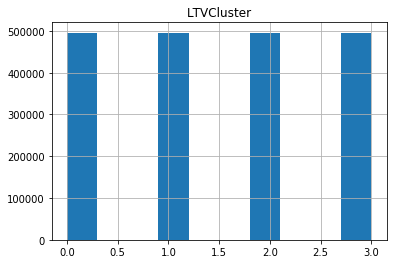

In [78]:
# take a look at y after SMOTE, 4 clusters have the same samples now
ty.hist()

In [79]:
X_train, X_test, y_train, y_test = train_test_split(tX, ty, test_size=0.2, random_state=56)

In [80]:
# fitting lightGBM
params = {"objective" : "multiclass",
          "num_class": 4,
          "metric" : "multi_error",
          "num_leaves" : 30,
          "min_child_weight" : 50,
          "learning_rate" : 0.1,
          "bagging_fraction" : 0.7,
          "feature_fraction" : 0.7,
          "reg_alpha": 0.15,
          "reg_lambda": 0.15,
          "min_child_weight": 50,
          "bagging_seed" : 420,
          "verbosity" : -1
         }
lg_train = lgb.Dataset(X_train, label=y_train)
lg_test = lgb.Dataset(X_test, label=y_test)
model = lgb.train(params, lg_train, 1000, valid_sets=[lg_test], early_stopping_rounds=50, verbose_eval=100)

Training until validation scores don't improve for 50 rounds.
[100]	valid_0's multi_error: 0.135794
[200]	valid_0's multi_error: 0.112646
[300]	valid_0's multi_error: 0.102742
[400]	valid_0's multi_error: 0.0954671
[500]	valid_0's multi_error: 0.0921009
[600]	valid_0's multi_error: 0.0904114
[700]	valid_0's multi_error: 0.0886792
[800]	valid_0's multi_error: 0.0868864
[900]	valid_0's multi_error: 0.0853104
[1000]	valid_0's multi_error: 0.0845666
Did not meet early stopping. Best iteration is:
[996]	valid_0's multi_error: 0.084564


In [81]:
y_pred = model.predict(X_test)

In [82]:
y_pred[0]

array([4.40159694e-06, 9.31897446e-01, 1.41229100e-02, 5.39752420e-02])

In [83]:
# change y_pred format by select the index of maximum probability
y_pred_list = [int(np.where(i == np.amax(i))[0]) for i in y_pred]
y_pred_ar = np.array(y_pred_list)
y_pred_ar

array([1, 0, 2, ..., 0, 2, 0])

In [84]:
print(classification_report(y_test, y_pred_ar))

              precision    recall  f1-score   support

           0       0.87      0.96      0.91     98840
           1       0.90      0.86      0.88     99469
           2       0.93      0.89      0.91     99136
           3       0.96      0.95      0.95     99142

    accuracy                           0.92    396587
   macro avg       0.92      0.92      0.92    396587
weighted avg       0.92      0.92      0.92    396587



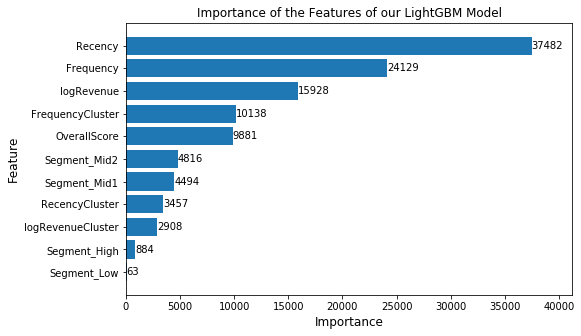

In [85]:
fig, ax = plt.subplots(figsize=(8,5))
lgb.plot_importance(model, height=0.8, ax=ax)
ax.grid(False)
plt.ylabel('Feature', size=12)
plt.xlabel('Importance', size=12)
plt.title("Importance of the Features of our LightGBM Model", fontsize=12)
plt.show()

### Adding Features

#### 1. Continent

In [86]:
ft = df.copy()
ft["date"] = pd.to_datetime(ft["date"], format="%Y%m%d")
# select data from Jan to Sept
ft = ft[(ft.date < date(2017,10,1)) & (ft.date >= date(2017,1,1))].reset_index(drop=True)
ft.shape

(636781, 38)

In [87]:
ft1 = ft[['fullVisitorId','geoNetwork.continent']]
ft1 = ft1.join(pd.get_dummies(ft1['geoNetwork.continent'])).drop(['(not set)'],axis = 1).drop(['geoNetwork.continent'], axis=1)

ft1 = ft1.groupby(['fullVisitorId']).agg(['max'])
ft1.columns = ['_'.join(col).strip() for col in ft1.columns.values]
ft1 = ft1.reset_index()

ft1.head()

,fullVisitorId,Africa_max,Americas_max,Asia_max,Europe_max,Oceania_max
0,0000027376579751715,0,1,0,0,0
1,0000039460501403861,0,1,0,0,0
2,0000040862739425590,0,1,0,0,0
3,0000049363351866189,0,0,1,0,0
4,0000062267706107999,0,1,0,0,0


In [88]:
# merge continent features with cluster
ft1_df = pd.merge(cluster, ft1, on='fullVisitorId')
ft1_df.head()

,fullVisitorId,Recency,RecencyCluster,Frequency,FrequencyCluster,logRevenue,logRevenueCluster,OverallScore,logRevenue_12,LTVCluster,Segment_High,Segment_Mid1,Segment_Mid2,Segment_Low,Africa_max,Americas_max,Asia_max,Europe_max,Oceania_max
0,8934116514970143966,4,3,3,1,16.612182,1,5,16.950570,1,0,0,1,0,0,1,0,0,0
1,3700714855829972615,5,3,8,1,19.586889,1,5,17.527862,1,0,0,1,0,0,1,0,0,0
2,0267692164162304307,19,3,3,1,16.165933,1,5,17.599018,1,0,0,1,0,0,1,0,0,0
3,4921798700570421930,59,3,5,1,17.087358,1,5,17.001863,1,0,0,1,0,0,1,0,0,0
4,1956114514458489728,0,3,6,1,17.656467,1,5,16.498585,1,0,0,1,0,0,1,0,0,0


In [89]:
X = ft1_df.drop(['LTVCluster','logRevenue_12','fullVisitorId'],axis=1)
y = ft1_df['LTVCluster']

In [90]:
X_columns = ft1_df.drop(['LTVCluster','logRevenue_12','fullVisitorId'],axis=1).columns
y_column = ['LTVCluster']

In [91]:
# using SMOTE for unbalanced data
X, y= SMOTE().fit_resample(X, y)

In [92]:
# change X, y to dataframe so that we can keep column names
tX = pd.DataFrame(X, columns=X_columns)
ty = pd.DataFrame(y, columns=y_column)

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x000002114F378400>]],
      dtype=object)

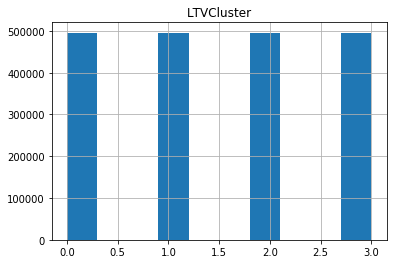

In [93]:
# take a look at y after SMOTE, 4 clusters have the same samples now
ty.hist()

In [94]:
X_train, X_test, y_train, y_test = train_test_split(tX, ty, test_size=0.2, random_state=56)

In [95]:
# fitting lightGBM
params = {"objective" : "multiclass",
          "num_class": 4,
          "metric" : "multi_error",
          "num_leaves" : 30,
          "min_child_weight" : 50,
          "learning_rate" : 0.1,
          "bagging_fraction" : 0.7,
          "feature_fraction" : 0.7,
          "reg_alpha": 0.15,
          "reg_lambda": 0.15,
          "min_child_weight": 50,
          "bagging_seed" : 420,
          "verbosity" : -1
         }
lg_train = lgb.Dataset(X_train, label=y_train)
lg_test = lgb.Dataset(X_test, label=y_test)
model = lgb.train(params, lg_train, 1000, valid_sets=[lg_test], early_stopping_rounds=50, verbose_eval=100)

Training until validation scores don't improve for 50 rounds.
[100]	valid_0's multi_error: 0.12334
[200]	valid_0's multi_error: 0.102941
[300]	valid_0's multi_error: 0.0898365
[400]	valid_0's multi_error: 0.0848389
[500]	valid_0's multi_error: 0.079289
[600]	valid_0's multi_error: 0.076064
[700]	valid_0's multi_error: 0.0737619
[800]	valid_0's multi_error: 0.072307
[900]	valid_0's multi_error: 0.0711445
[1000]	valid_0's multi_error: 0.0701914
Did not meet early stopping. Best iteration is:
[991]	valid_0's multi_error: 0.0701914


In [96]:
y_pred = model.predict(X_test)

In [97]:
y_pred[0]

array([1.39717059e-05, 9.96990504e-01, 2.97112017e-03, 2.44040701e-05])

In [98]:
# change y_pred format by select the index of maximum probability
y_pred_list = [int(np.where(i == np.amax(i))[0]) for i in y_pred]
y_pred_ar = np.array(y_pred_list)
y_pred_ar

array([1, 2, 2, ..., 0, 2, 0])

In [99]:
print(classification_report(y_test, y_pred_ar))

              precision    recall  f1-score   support

           0       0.93      0.94      0.93     98840
           1       0.92      0.88      0.90     99469
           2       0.92      0.95      0.93     99136
           3       0.96      0.95      0.95     99142

    accuracy                           0.93    396587
   macro avg       0.93      0.93      0.93    396587
weighted avg       0.93      0.93      0.93    396587



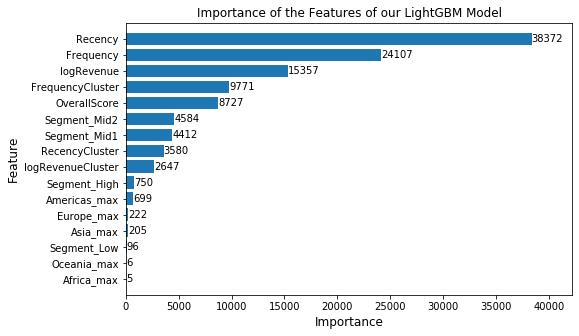

In [100]:
fig, ax = plt.subplots(figsize=(8,5))
lgb.plot_importance(model, height=0.8, ax=ax)
ax.grid(False)
plt.ylabel('Feature', size=12)
plt.xlabel('Importance', size=12)
plt.title("Importance of the Features of our LightGBM Model", fontsize=12)
plt.show()

#### 2. Continent and Country-US

In [101]:
ft2 = ft[['fullVisitorId','geoNetwork.country']]
ft2['country_US']=0
ft2.loc[ft2['geoNetwork.country']=='United States','country_US']=1
ft2 = ft2.drop(['geoNetwork.country'],axis=1)

ft2.head()

,fullVisitorId,country_US
0,1228032379240126503,0
1,1088084052558051564,0
2,3615794190344553521,0
3,8127234129777839476,0
4,7139860291376515793,0


In [102]:
# check whether a customer only stay in US/not in US, but not for both
us = ft2.groupby(['fullVisitorId']).agg(['sum'])
us.columns = ['_'.join(col).strip() for col in us.columns.values]
us = us.reset_index()

us_merge = pd.merge(user_frequency, us, on='fullVisitorId')

us_merge['us_only'] = (us_merge['Frequency']==us_merge['country_US_sum'])
us_merge.loc[us_merge['Frequency']== 1,'us_only']=True
us_merge.loc[us_merge['country_US_sum']== 0,'us_only']=True
us_merge['us_only'] = us_merge['us_only']*1

In [103]:
# number of customer have been both in US and not in US
print(us_merge[us_merge['us_only']==0]['fullVisitorId'].count())

# presentage of customer have been both in US and not in US
print(us_merge[us_merge['us_only']==0]['fullVisitorId'].count()/us_merge.fullVisitorId.count())

1051
0.0021189986068239418


Since majority of people (99.8%) will staying in US not not in US through all the trasaction, we can consider whether in US as a stable attribute for a customer.

In [104]:
ft2 = ft2.groupby(['fullVisitorId']).agg(['max'])
ft2.columns = ['_'.join(col).strip() for col in ft2.columns.values]
ft2 = ft2.reset_index()
ft2.columns = ['fullVisitorId', 'country_US']

ft2.head()

,fullVisitorId,country_US
0,0000027376579751715,1
1,0000039460501403861,0
2,0000040862739425590,1
3,0000049363351866189,0
4,0000062267706107999,0


In [105]:
# merge continent features with cluster
ft2_df = pd.merge(ft1_df, ft2, on='fullVisitorId')
ft2_df.head()

,fullVisitorId,Recency,RecencyCluster,Frequency,FrequencyCluster,logRevenue,logRevenueCluster,OverallScore,logRevenue_12,LTVCluster,Segment_High,Segment_Mid1,Segment_Mid2,Segment_Low,Africa_max,Americas_max,Asia_max,Europe_max,Oceania_max,country_US
0,8934116514970143966,4,3,3,1,16.612182,1,5,16.950570,1,0,0,1,0,0,1,0,0,0,1
1,3700714855829972615,5,3,8,1,19.586889,1,5,17.527862,1,0,0,1,0,0,1,0,0,0,1
2,0267692164162304307,19,3,3,1,16.165933,1,5,17.599018,1,0,0,1,0,0,1,0,0,0,1
3,4921798700570421930,59,3,5,1,17.087358,1,5,17.001863,1,0,0,1,0,0,1,0,0,0,1
4,1956114514458489728,0,3,6,1,17.656467,1,5,16.498585,1,0,0,1,0,0,1,0,0,0,1


In [106]:
X = ft2_df.drop(['LTVCluster','logRevenue_12','fullVisitorId'],axis=1)
y = ft2_df['LTVCluster']

In [107]:
X_columns = ft2_df.drop(['LTVCluster','logRevenue_12','fullVisitorId'],axis=1).columns
y_column = ['LTVCluster']

In [108]:
# using SMOTE for unbalanced data
X, y= SMOTE().fit_resample(X, y)

In [109]:
# change X, y to dataframe so that we can keep column names
tX = pd.DataFrame(X, columns=X_columns)
ty = pd.DataFrame(y, columns=y_column)

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x000002114F40D0B8>]],
      dtype=object)

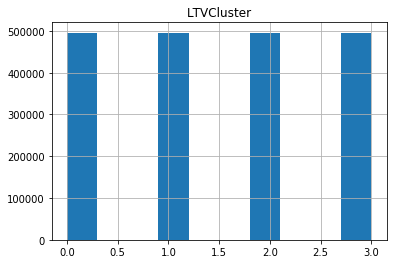

In [110]:
# take a look at y after SMOTE, 4 clusters have the same samples now
ty.hist()

In [111]:
X_train, X_test, y_train, y_test = train_test_split(tX, ty, test_size=0.2, random_state=56)

In [112]:
# fitting lightGBM
params = {"objective" : "multiclass",
          "num_class": 4,
          "metric" : "multi_error",
          "num_leaves" : 30,
          "min_child_weight" : 50,
          "learning_rate" : 0.1,
          "bagging_fraction" : 0.7,
          "feature_fraction" : 0.7,
          "reg_alpha": 0.15,
          "reg_lambda": 0.15,
          "min_child_weight": 50,
          "bagging_seed" : 420,
          "verbosity" : -1
         }
lg_train = lgb.Dataset(X_train, label=y_train)
lg_test = lgb.Dataset(X_test, label=y_test)
model = lgb.train(params, lg_train, 1000, valid_sets=[lg_test], early_stopping_rounds=50, verbose_eval=100)

Training until validation scores don't improve for 50 rounds.
[100]	valid_0's multi_error: 0.116759
[200]	valid_0's multi_error: 0.0929884
[300]	valid_0's multi_error: 0.0838202
[400]	valid_0's multi_error: 0.0768936
[500]	valid_0's multi_error: 0.0741451
[600]	valid_0's multi_error: 0.070968
[700]	valid_0's multi_error: 0.0688626
[800]	valid_0's multi_error: 0.0671026
[900]	valid_0's multi_error: 0.0663864
[1000]	valid_0's multi_error: 0.0658443
Did not meet early stopping. Best iteration is:
[1000]	valid_0's multi_error: 0.0658443


In [113]:
y_pred = model.predict(X_test)

In [114]:
y_pred[0]

array([9.88819487e-05, 9.86993915e-01, 2.90952460e-03, 9.99767817e-03])

In [115]:
# change y_pred format by select the index of maximum probability
y_pred_list = [int(np.where(i == np.amax(i))[0]) for i in y_pred]
y_pred_ar = np.array(y_pred_list)
y_pred_ar

array([1, 0, 2, ..., 0, 2, 0])

In [116]:
print(classification_report(y_test, y_pred_ar))

              precision    recall  f1-score   support

           0       0.93      0.95      0.94     98840
           1       0.93      0.89      0.91     99469
           2       0.92      0.95      0.93     99136
           3       0.96      0.95      0.96     99142

    accuracy                           0.93    396587
   macro avg       0.93      0.93      0.93    396587
weighted avg       0.93      0.93      0.93    396587



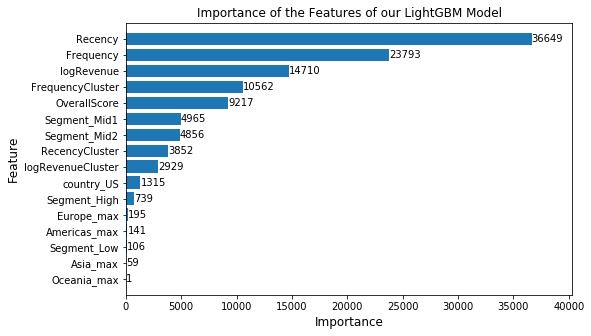

In [117]:
fig, ax = plt.subplots(figsize=(8,5))
lgb.plot_importance(model, height=0.8, ax=ax)
ax.grid(False)
plt.ylabel('Feature', size=12)
plt.xlabel('Importance', size=12)
plt.title("Importance of the Features of our LightGBM Model", fontsize=12)
plt.show()

#### 3. Country-US Only

In [118]:
# merge continent features with cluster
ft_us = pd.merge(cluster, ft2, on='fullVisitorId')
ft_us.head()

,fullVisitorId,Recency,RecencyCluster,Frequency,FrequencyCluster,logRevenue,logRevenueCluster,OverallScore,logRevenue_12,LTVCluster,Segment_High,Segment_Mid1,Segment_Mid2,Segment_Low,country_US
0,8934116514970143966,4,3,3,1,16.612182,1,5,16.950570,1,0,0,1,0,1
1,3700714855829972615,5,3,8,1,19.586889,1,5,17.527862,1,0,0,1,0,1
2,0267692164162304307,19,3,3,1,16.165933,1,5,17.599018,1,0,0,1,0,1
3,4921798700570421930,59,3,5,1,17.087358,1,5,17.001863,1,0,0,1,0,1
4,1956114514458489728,0,3,6,1,17.656467,1,5,16.498585,1,0,0,1,0,1


In [119]:
X = ft_us.drop(['LTVCluster','logRevenue_12','fullVisitorId'],axis=1)
y = ft_us['LTVCluster']

In [120]:
X_columns = ft_us.drop(['LTVCluster','logRevenue_12','fullVisitorId'],axis=1).columns
y_column = ['LTVCluster']

In [121]:
# using SMOTE for unbalanced data
X, y= SMOTE().fit_resample(X, y)

In [122]:
# change X, y to dataframe so that we can keep column names
tX = pd.DataFrame(X, columns=X_columns)
ty = pd.DataFrame(y, columns=y_column)

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x000002114F43AF60>]],
      dtype=object)

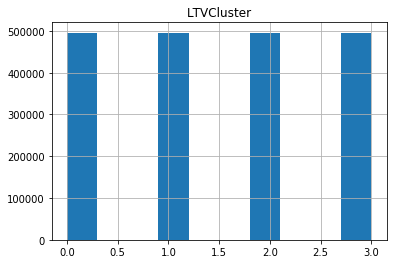

In [123]:
# take a look at y after SMOTE, 4 clusters have the same samples now
ty.hist()

In [124]:
X_train, X_test, y_train, y_test = train_test_split(tX, ty, test_size=0.2, random_state=56)

In [125]:
# fitting lightGBM
params = {"objective" : "multiclass",
          "num_class": 4,
          "metric" : "multi_error",
          "num_leaves" : 30,
          "min_child_weight" : 50,
          "learning_rate" : 0.1,
          "bagging_fraction" : 0.7,
          "feature_fraction" : 0.7,
          "reg_alpha": 0.15,
          "reg_lambda": 0.15,
          "min_child_weight": 50,
          "bagging_seed" : 420,
          "verbosity" : -1
         }
lg_train = lgb.Dataset(X_train, label=y_train)
lg_test = lgb.Dataset(X_test, label=y_test)
model = lgb.train(params, lg_train, 1000, valid_sets=[lg_test], early_stopping_rounds=50, verbose_eval=100)

Training until validation scores don't improve for 50 rounds.
[100]	valid_0's multi_error: 0.116673
[200]	valid_0's multi_error: 0.0930565
[300]	valid_0's multi_error: 0.0833386
[400]	valid_0's multi_error: 0.0780989
[500]	valid_0's multi_error: 0.0744427
[600]	valid_0's multi_error: 0.0710311
[700]	valid_0's multi_error: 0.0694803
[800]	valid_0's multi_error: 0.0676522
[900]	valid_0's multi_error: 0.0666941
[1000]	valid_0's multi_error: 0.0662452
Did not meet early stopping. Best iteration is:
[995]	valid_0's multi_error: 0.0662377


In [126]:
y_pred = model.predict(X_test)

In [127]:
y_pred[0]

array([3.51200281e-01, 6.47974479e-01, 3.61149991e-04, 4.64089751e-04])

In [128]:
# change y_pred format by select the index of maximum probability
y_pred_list = [int(np.where(i == np.amax(i))[0]) for i in y_pred]
y_pred_ar = np.array(y_pred_list)
y_pred_ar

array([1, 0, 2, ..., 0, 0, 0])

In [129]:
print(classification_report(y_test, y_pred_ar))

              precision    recall  f1-score   support

           0       0.93      0.94      0.94     98840
           1       0.93      0.88      0.91     99469
           2       0.92      0.95      0.93     99136
           3       0.96      0.95      0.96     99142

    accuracy                           0.93    396587
   macro avg       0.93      0.93      0.93    396587
weighted avg       0.93      0.93      0.93    396587



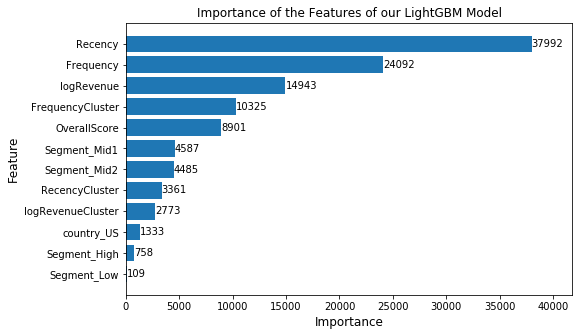

In [130]:
fig, ax = plt.subplots(figsize=(8,5))
lgb.plot_importance(model, height=0.8, ax=ax)
ax.grid(False)
plt.ylabel('Feature', size=12)
plt.xlabel('Importance', size=12)
plt.title("Importance of the Features of our LightGBM Model", fontsize=12)
plt.show()

Adding continent and country_us has the almost the same result as adding country_us only. To avoid overfitting, we will select the third model, adding contry_us only.

In [131]:
from sklearn import metrics
from sklearn.utils.multiclass import unique_labels
class_names=[0,1,2,3] # name  of classes

def plot_confusion_matrix(y_true, y_pred, classes,
                          normalize=False,
                          title=None,
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if not title:
        if normalize:
            title = 'Normalized confusion matrix'
        else:
            title = 'Confusion matrix, without normalization'

    # Compute confusion matrix
    cm = confusion_matrix(y_true, y_pred)
    # Only use the labels that appear in the data
    classes = classes
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=0)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    fig, ax = plt.subplots()
    im = ax.imshow(cm, interpolation='nearest', cmap=cmap)
    ax.figure.colorbar(im, ax=ax)
    # We want to show all ticks...
    ax.set(xticks=np.arange(cm.shape[1]),
           yticks=np.arange(cm.shape[0]),
           # ... and label them with the respective list entries
           xticklabels=classes, yticklabels=classes,
           title=title,
           ylabel='True label',
           xlabel='Predicted label')

    # Rotate the tick labels and set their alignment.
    plt.setp(ax.get_xticklabels(), rotation=45, ha="right",
             rotation_mode="anchor")

    # Loop over data dimensions and create text annotations.
    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i in range(cm.shape[0]):
        for j in range(cm.shape[1]):
            ax.text(j, i, format(cm[i, j], fmt),
                    ha="center", va="center",
                    color="white" if cm[i, j] > thresh else "black")
    fig.tight_layout()
    return ax

Confusion matrix, without normalization
[[93362  2369  2728   381]
 [ 3776 87963  4491  3239]
 [ 2316  1780 94386   654]
 [  781  2584  1170 94607]]
Normalized confusion matrix
[[0.93 0.02 0.03 0.  ]
 [0.04 0.93 0.05 0.03]
 [0.02 0.02 0.92 0.01]
 [0.01 0.03 0.01 0.96]]


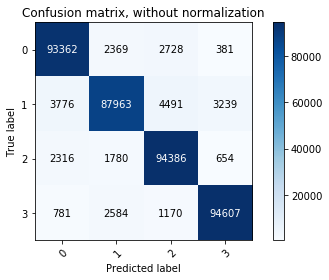

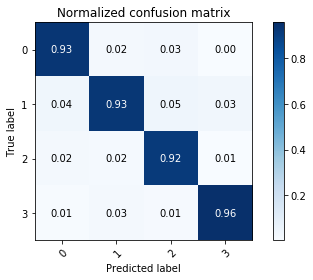

In [132]:
np.set_printoptions(precision=2)

# Plot non-normalized confusion matrix
plot_confusion_matrix(y_test, y_pred_ar, classes=class_names,
                      title='Confusion matrix, without normalization')

# Plot normalized confusion matrix
plot_confusion_matrix(y_test, y_pred_ar, classes=class_names, normalize=True,
                      title='Normalized confusion matrix')

plt.show()